# OFFLINE HARDWARE ANALYSIS 

## SETUP & CONFIGURATION

### Imports and Constants 

In [68]:

import os
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import rfft, rfftfreq
from pathlib import Path

# Analysis metadata
ANALYSIS_VERSION = "v2.0_2026-01-13"

# And add these imports if you want PDF:
from datetime import datetime
from matplotlib.backends.backend_pdf import PdfPages

plt.style.use("default")

# ---- Device / ADC assumptions ----
FS_HZ = 16000            # Hz
VREF_V = 4.5             # V (confirm for your board)
GAIN = 12               # ADS1299 PGA gain (confirm)
ADC_BITS = 24
CHANNEL_GAINS = [12, 12, 12, 12, 12, 12, 12, 12]  # Per-channel gains (Ch1-Ch8)

# ---- Stream format ----
N_CHANNELS = 8
STATUS_BYTES = 3
BYTES_PER_CH = 3
SAMPLE_BYTES = STATUS_BYTES + N_CHANNELS * BYTES_PER_CH          # 27

PACKETS_PER_FRAME = 50
PACKET_BYTES = 28                                               # 27 data + 1 pad
HEADER_BYTES = 16
FRAME_BYTES = HEADER_BYTES + PACKETS_PER_FRAME * PACKET_BYTES   # 1416

FS_COUNTS = (1 << (ADC_BITS - 1)) - 1                            # 2^23 - 1 = 8388607

# ---- Plot defaults (full band always) ----
BAND_MAX_HZ_DEFAULT = FS_HZ / 2                                  # 8000 Hz at 16 kHz
FFT_DBFS_FLOOR = -140.0


### File Loader

In [105]:
# ═══════════════════════════════════════════════════════════════════════════════
# FILE PATHS CONFIGURATION
# ═══════════════════════════════════════════════════════════════════════════════
from pathlib import Path

# Base directory for all validation files
VALIDATION_BASE = Path(r"G:\Shared drives\03_Hardware\06_Validation\Headband\260130\validation")

# ─── NOISE TESTS ───────────────────────────────────────────────────────────────
BIN_INTERNAL_NOISE = VALIDATION_BASE / "260130_140604_FW2_R2_INT_1600_16k.bin"  # Shorted inputs
BIN_EXTERNAL_NOISE = VALIDATION_BASE / "260130_140952_FW2_R2_EXT_1600_16k.bin"  # Floating inputs

# ─── KNOWN SIGNAL INJECTION (KSI) - Per Channel ───────────────────────────────
BIN_KSI_CH2 = VALIDATION_BASE / "260130_142125_FW2_R2_KSI_CH2_40HZ_1600_16k.bin"
BIN_KSI_CH3 = VALIDATION_BASE / "260130_142322_FW2_R2_KSI_CH3_40HZ_1600_16k.bin"
BIN_KSI_CH4 = VALIDATION_BASE / "260130_142403_FW2_R2_KSI_CH4_40HZ_1600_16k.bin"
BIN_KSI_CH5 = VALIDATION_BASE / "260130_142502_FW2_R2_KSI_CH5_40HZ_1600_16k.bin"
BIN_KSI_CH6 = VALIDATION_BASE / "260130_142541_FW2_R2_KSI_CH6_40HZ_1600_16k.bin"
BIN_KSI_CH7 = VALIDATION_BASE / "260130_142622_FW2_R2_KSI_CH7_40HZ_1600_16k.bin"
BIN_KSI_CH8 = VALIDATION_BASE / "260130_142722_FW2_R2_KSI_CH8_40HZ_1600_16k.bin"

# ─── FUNCTIONAL TESTS ──────────────────────────────────────────────────────────
BIN_EYES_OPEN = VALIDATION_BASE / "260130_153012_FW2_R2_FUNEO_1600_16k.bin"
BIN_EYES_CLOSED = VALIDATION_BASE / "260130_153215_FW2_R2_FUNEC_1600_16k.bin"
BIN_EYES_BLINK = VALIDATION_BASE / "260130_174236_FW2_R2_FUNEB_200_1k.bin"

print("✓ File paths configured")
print(f"  Base: {VALIDATION_BASE}")
print(f"  Internal noise: {BIN_INTERNAL_NOISE.name}")
print(f"  External noise: {BIN_EXTERNAL_NOISE.name}")
print(f"  KSI channels: CH2-CH8 (7 files)")
print(f"  Functional tests: Eyes open/closed/blink (3 files)")

✓ File paths configured
  Base: G:\Shared drives\03_Hardware\06_Validation\Headband\260130\validation
  Internal noise: 260130_140604_FW2_R2_INT_1600_16k.bin
  External noise: 260130_140952_FW2_R2_EXT_1600_16k.bin
  KSI channels: CH2-CH8 (7 files)
  Functional tests: Eyes open/closed/blink (3 files)


In [ ]:
from pathlib import Path
import hashlib

# --- set the intended file explicitly ---
BIN_PATH = BIN_INTERNAL_NOISE 
FALLBACK = Path("/mnt/data/20260116_091121522_FW2_R2_EXT_1559_16k2.bin")

if not BIN_PATH.exists():
    BIN_PATH = FALLBACK 

if not BIN_PATH.exists():
    raise FileNotFoundError(f"BIN_PATH not found: {BIN_PATH}")

print("Using BIN_PATH:", BIN_PATH)

bin_bytes = BIN_PATH.read_bytes()
md5 = hashlib.md5(bin_bytes).hexdigest()
print(f"Loaded: {BIN_PATH.name} ({len(bin_bytes):,} bytes) | md5={md5}")




Using BIN_PATH: G:\Shared drives\03_Hardware\06_Validation\Headband\260130\validation\260130_140604_FW2_R2_INT_1600_16k.bin
Loaded: 260130_140604_FW2_R2_INT_1600_16k.bin (2,265,600 bytes) | md5=0ed3f0284227dfdfb07ebdc96112b69c


### Metadata Parser 

In [71]:
import re
from pathlib import Path


def _format_date(date_str: str) -> str:
    """Convert YYMMDD or YYYYMMDD to YYYY-MM-DD format."""
    if len(date_str) == 8:  # YYYYMMDD
        return f"{date_str[0:4]}-{date_str[4:6]}-{date_str[6:8]}"
    elif len(date_str) == 6:  # YYMMDD → 20YY-MM-DD
        return f"20{date_str[0:2]}-{date_str[2:4]}-{date_str[4:6]}"
    return date_str  # Fallback


def _format_time(time_str: str) -> str:
    """Convert HHMM or HHMMSS to HH:MM or HH:MM:SS format."""
    if len(time_str) == 4:  # HHMM
        return f"{time_str[0:2]}:{time_str[2:4]}"
    elif len(time_str) == 6:  # HHMMSS
        return f"{time_str[0:2]}:{time_str[2:4]}:{time_str[4:6]}"
    return time_str  # Fallback


def detect_test_type(filename_meta: dict) -> str:
    """Auto-detect test type from filename pattern."""
    condition = filename_meta.get('condition', '').upper()
    
    if condition.startswith('FUN'):
        return "functional"   # FUNEC, FUNEB, FUNEO
    elif condition == 'KSI':
        return "injection"    # Signal injection
    else:
        return "hardware"     # INT/EXT/SYN etc.


def parse_filename_metadata(bin_path: Path) -> dict:
    """
    Parse metadata from filename.
    
    Supports formats:
    - NEW:  YYMMDD_HHMMSS_FWX_RY_COND_NNNN_NNk.bin
    - NEW:  YYYYMMDD_HHMMSS_FWX_RY_COND_NNNN_NNk.bin
    - KSI:  YYMMDD_HHMMSS_FWX_RY_KSI_CHX_XXHZ_NNNN_NNk.bin
    - FUN:  YYMMDD_HHMMSS_FWX_RY_FUNEC_NNNN_NNk.bin
    - OLD:  DD-MM-FWX_VY_NNNNframes_NNkhz.bin
    """
    filename = bin_path.stem
    
    meta = {
        "date": None,
        "time": None,
        "firmware": None,
        "board": None,
        "condition": None,
        "n_frames_declared": None,
        "sampling_rate_khz": None,
        "format": None,
        "target_channel": None,
        "injection_freq_hz": None,
    }
    
    # ═══════════════════════════════════════════════════════════════════════
    # PRIORITY 1: KSI format (Signal Injection) - Most specific
    # Example: 260130_142403_FW2_R2_KSI_CH4_40HZ_1600_16k.bin
    # ═══════════════════════════════════════════════════════════════════════
    ksi_pattern = r'^(\d{6,8})_(\d{4,6})_FW(\d+)_R(\d+)_KSI_CH(\d+)_(\d+)HZ_(\d+)_(\d+)k'
    ksi_match = re.match(ksi_pattern, filename, re.IGNORECASE)

    if ksi_match:
        meta["date"] = _format_date(ksi_match.group(1))
        meta["time"] = _format_time(ksi_match.group(2))
        meta["firmware"] = f"FW{ksi_match.group(3)}"
        meta["board"] = f"R{ksi_match.group(4)}"
        meta["condition"] = "KSI"
        meta["target_channel"] = int(ksi_match.group(5))
        meta["injection_freq_hz"] = int(ksi_match.group(6))
        meta["n_frames_declared"] = int(ksi_match.group(7))
        meta["sampling_rate_khz"] = int(ksi_match.group(8))
        meta["format"] = "ksi"
        meta["display_name"] = (
            f"{meta['firmware']} | {meta['board']} "
            f"[KSI-CH{meta['target_channel']}@{meta['injection_freq_hz']}Hz] | "
            f"{meta['date']} {meta['time']}"
        )
        return meta
    
    # ═══════════════════════════════════════════════════════════════════════
    # PRIORITY 2: NEW format (General + Functional)
    # Examples: 
    #   260130_140604_FW2_R2_INT_1600_16k.bin
    #   260130_151322_FW2_R2_FUNEC_1600_16k.bin
    #   20260130_111927_FW2_R2_INT_1600_16k.bin
    # ═══════════════════════════════════════════════════════════════════════
    new_pattern = r'^(\d{6,8})_(\d{4,6})_FW(\d+)_R(\d+)_?([A-Z]+(?:EC|EB|EO)?)?_?(\d+)_(\d+)k'
    new_match = re.match(new_pattern, filename, re.IGNORECASE)

    if new_match:
        date_str = new_match.group(1)
        time_str = new_match.group(2)
        condition = new_match.group(5)
        
        meta["date"] = _format_date(date_str)
        meta["time"] = _format_time(time_str)
        meta["firmware"] = f"FW{new_match.group(3)}"
        meta["board"] = f"R{new_match.group(4)}"
        meta["condition"] = condition if condition else "General"
        meta["n_frames_declared"] = int(new_match.group(6))
        meta["sampling_rate_khz"] = int(new_match.group(7))
        meta["format"] = "new"
        
        # Build display name
        if condition and condition.upper().startswith('FUN'):
            cond_str = f" [FUNCTIONAL-{condition.upper()}]"
        elif condition:
            cond_str = f" [{condition.upper()}]"
        else:
            cond_str = ""
        
        meta["display_name"] = (
            f"{meta['firmware']} | {meta['board']}{cond_str} | "
            f"{meta['date']} {meta['time']}"
        )
        return meta
    
    # ═══════════════════════════════════════════════════════════════════════
    # PRIORITY 3: OLD format
    # Example: 26-01-FW2_V1_1234frames_16khz.bin
    # ═══════════════════════════════════════════════════════════════════════
    old_pattern = r'^(\d{2}-\d{2}).*FW(\d+).*V(\d+).*?(\d+)frames.*?(\d+)khz'
    old_match = re.search(old_pattern, filename, re.IGNORECASE)
    
    if old_match:
        meta["date"] = old_match.group(1)
        meta["firmware"] = f"FW{old_match.group(2)}"
        meta["board"] = f"V{old_match.group(3)}"
        meta["condition"] = "General"
        meta["n_frames_declared"] = int(old_match.group(4))
        meta["sampling_rate_khz"] = int(old_match.group(5))
        meta["format"] = "old"
        meta["display_name"] = f"{meta['firmware']} | {meta['board']} | {meta['date']}"
        return meta
    
    # ═══════════════════════════════════════════════════════════════════════
    # FALLBACK: Unknown format
    # ═══════════════════════════════════════════════════════════════════════
    meta["format"] = "unknown"
    meta["condition"] = "Unknown"
    meta["display_name"] = filename
    return meta


## LOW LEVEL HELPERS &PARSERS 


In [72]:

def _u16_le(b: np.ndarray) -> np.ndarray:
    return (b[:, 0].astype(np.uint16) | (b[:, 1].astype(np.uint16) << 8))

def _u32_le(b: np.ndarray) -> np.ndarray:
    return (
        b[:, 0].astype(np.uint32)
        | (b[:, 1].astype(np.uint32) << 8)
        | (b[:, 2].astype(np.uint32) << 16)
        | (b[:, 3].astype(np.uint32) << 24)
    )

def unwrap_u32_to_i64(x_u32: np.ndarray) -> np.ndarray:
    """
    Standard uint32 unwrap to int64 (adds 2^32 on wrap).
    Does NOT smooth steps; anomalies remain visible in Δt1.
    """
    x = np.asarray(x_u32, dtype=np.uint32).astype(np.uint64)
    if x.size == 0:
        return np.zeros((0,), dtype=np.int64)
    d = np.diff(x.astype(np.int64))
    WRAP = 1 << 32
    d_corr = d.copy()
    d_corr[d < -(WRAP // 2)] += WRAP
    out = np.empty_like(x, dtype=np.int64)
    out[0] = int(x[0])
    out[1:] = out[0] + np.cumsum(d_corr.astype(np.int64))
    return out

def duration_from_counts(counts: np.ndarray, fs_hz: int) -> float:
    n = int(counts.shape[1])
    return n / float(fs_hz) if fs_hz > 0 else float("nan")

In [73]:

def parse_ads1299_framestream_bin_bytes_strict_1416(
    bin_bytes: bytes,
    *,
    require_t1_nonzero: bool = True,
    require_t1_nonzero_all_frames: bool = True,
) -> tuple[np.ndarray, dict]:
    """
    Strict 1416-byte framestream parser.
    Hard-fails on:
      - file not divisible by 1416
      - payload not exactly 1400 bytes/frame
      - packet_count != 50
      - t1 == 0 (frame 0 only, or all frames if configured)

    Returns:
      counts_all: (8, n_samples) int32
      meta: dict with hdr arrays + first/last
    """
    data = np.frombuffer(bin_bytes, dtype=np.uint8)
    if data.size < FRAME_BYTES:
        raise ValueError(f"Bin too small: {data.size} bytes (< {FRAME_BYTES}).")

    if data.size % FRAME_BYTES != 0:
        raise ValueError(
            f"Bin length {data.size} not divisible by {FRAME_BYTES}. "
            "File may be truncated or different format."
        )

    n_frames = data.size // FRAME_BYTES
    frames = data.reshape(n_frames, FRAME_BYTES)

    header16 = frames[:, :HEADER_BYTES]
    packet_count = _u16_le(header16[:, 6:8])

    if not np.all(packet_count == PACKETS_PER_FRAME):
        bad_idx = np.where(packet_count != PACKETS_PER_FRAME)[0]
        i0 = int(bad_idx[0])
        raise ValueError(
            f"packet_count mismatch at frame {i0}: got {int(packet_count[i0])}, expected {PACKETS_PER_FRAME}."
        )

    hdr = {
        "t1_first_drdy_us": _u32_le(header16[:, 0:4]),
        "t2_last_drdy_delta_4us": header16[:, 4].astype(np.uint8),
        "t3_tx_ready_delta_4us": header16[:, 5].astype(np.uint8),
        "packet_count": packet_count,
        "samples_sent": _u32_le(header16[:, 8:12]),
        "total_samples": _u32_le(header16[:, 12:16]),
    }

    if require_t1_nonzero:
        t1 = hdr["t1_first_drdy_us"]
        if require_t1_nonzero_all_frames:
            zero_idx = np.where(t1 == 0)[0]
            if zero_idx.size:
                i0 = int(zero_idx[0])
                raise ValueError(f"t1_first_drdy_us == 0 at frame {i0}. Requirement violated.")
        else:
            if int(t1[0]) == 0:
                raise ValueError("t1_first_drdy_us == 0 at frame 0. Requirement violated.")

    payload = frames[:, HEADER_BYTES:]  # (n_frames, 1400)
    expected_payload_bytes = PACKETS_PER_FRAME * PACKET_BYTES
    if payload.shape[1] != expected_payload_bytes:
        raise ValueError(
            f"Payload size mismatch: got {payload.shape[1]} bytes/frame, expected {expected_payload_bytes}."
        )

    packets = payload.reshape(n_frames, PACKETS_PER_FRAME, PACKET_BYTES)

    # 27 data bytes, ignore 1 padding byte
    sample_bytes = packets[:, :, :SAMPLE_BYTES].reshape(-1, SAMPLE_BYTES)  # (n_samples, 27)

    # Drop 3 status bytes, parse 8 channels × 3 bytes (MSB first)
    ch_bytes = sample_bytes[:, STATUS_BYTES:].reshape(-1, N_CHANNELS, 3)

    x = (
        (ch_bytes[:, :, 0].astype(np.int32) << 16)
        | (ch_bytes[:, :, 1].astype(np.int32) << 8)
        |  ch_bytes[:, :, 2].astype(np.int32)
    )

    # Sign extend 24-bit two's complement
    x = np.where(x & 0x800000, x - 0x1000000, x).astype(np.int32)

    counts_all = x.T  # (8, n_samples)

    meta = {
        "frame_bytes": int(FRAME_BYTES),
        "n_frames": int(n_frames),
        "n_samples": int(counts_all.shape[1]),
        "packets_per_frame": int(PACKETS_PER_FRAME),
        "packet_bytes": int(PACKET_BYTES),
        "sample_bytes": int(SAMPLE_BYTES),
        "hdr": hdr,
        "header_first": {k: int(v[0]) for k, v in hdr.items()},
        "header_last": {k: int(v[-1]) for k, v in hdr.items()},
    }
    return counts_all, meta

## DATA QUALITY CHECKS

In [74]:
# ==============================
def extract_packet_pad_and_status(bin_bytes: bytes) -> tuple[np.ndarray, np.ndarray]:
    """
    Extract padding byte and status bytes from all packets.
    Returns (pad, status) where:
    - pad: (n_frames, 50) array of padding bytes
    - status: (n_frames, 50, 3) array of status bytes
    """
    data = np.frombuffer(bin_bytes, dtype=np.uint8)
    if data.size % FRAME_BYTES != 0:
        raise ValueError(f"Bin length {data.size} not divisible by FRAME_BYTES={FRAME_BYTES}.")

    n_frames = data.size // FRAME_BYTES
    frames = data.reshape(n_frames, FRAME_BYTES)
    payload = frames[:, HEADER_BYTES:]                                # (n_frames, 1400)
    packets = payload.reshape(n_frames, PACKETS_PER_FRAME, PACKET_BYTES)  # (n_frames, 50, 28)

    pad = packets[:, :, 27].astype(np.uint8)                          # padding byte per packet
    status = packets[:, :, :STATUS_BYTES].astype(np.uint8)            # first 3 bytes
    return pad, status

def quick_counter_report(pad: np.ndarray, status: np.ndarray, *, n_preview_frames: int = 3) -> dict:
    """
    Analyze padding byte patterns (potential frame/packet counter).
    Returns a dict with counter statistics for logging.
    """
    n_frames = int(pad.shape[0])

    pkt_idx = np.arange(PACKETS_PER_FRAME, dtype=np.uint8)
    pct_eq_pktidx = 100.0 * float(np.mean(pad == pkt_idx[None, :]))

    cand0 = pad[:, 0].astype(np.int64)
    candL = pad[:, -1].astype(np.int64)

    def _scores(x: np.ndarray) -> tuple[float, float]:
        d = np.diff(x)
        return float(np.mean(d == 1)), float(np.mean(d >= 0))

    s0_inc1, s0_nondec = _scores(cand0) if cand0.size > 1 else (0.0, 0.0)
    sL_inc1, sL_nondec = _scores(candL) if candL.size > 1 else (0.0, 0.0)

    preview = []
    for i in range(min(n_preview_frames, n_frames)):
        preview.append({
            "frame": i,
            "pad_first12": pad[i, :12].tolist(),
            "pad_last": int(pad[i, -1]),
            "status_first5": status[i, :5, :].tolist(),
        })

    out = {
        "pad_unique_first30": np.unique(pad)[:30].tolist(),
        "pct_pad_matches_pkt_index_0_49": pct_eq_pktidx,
        "pad0_fraction_delta_eq_1": s0_inc1,
        "pad0_fraction_nondecreasing": s0_nondec,
        "padLast_fraction_delta_eq_1": sL_inc1,
        "padLast_fraction_nondecreasing": sL_nondec,
        "preview": preview,
        "status0_unique_count": int(np.unique(status[:, :, 0]).size),
        "status1_unique_count": int(np.unique(status[:, :, 1]).size),
        "status2_unique_count": int(np.unique(status[:, :, 2]).size),
    }
    return out


def decode_and_print_status_bytes(status: np.ndarray) -> dict:
    """
    Decode and print ADS1299 status bytes with CORRECT nibble reconstruction.
    
    ╔═══════════════════════════════════════════════════════════════════╗
    ║  ADS1299 STATUS BYTE PACKING (3 bytes packed across nibbles)     ║
    ╠═══════════════════════════════════════════════════════════════════╣
    ║  SB0[7:4] = LOFF_STATP[3:0]  (lower nibble of positive lead-off) ║
    ║  SB0[3:0] = LOFF_STATP[7:4]  (upper nibble of positive lead-off) ║
    ║  SB1[7:4] = LOFF_STATN[3:0]  (lower nibble of negative lead-off) ║
    ║  SB1[3:0] = LOFF_STATN[7:4]  (upper nibble of negative lead-off) ║
    ║  SB2[7:4] = Reserved/unused                                       ║
    ║  SB2[3:0] = GPIO[7:4]        (upper GPIO pins)                    ║
    ╚═══════════════════════════════════════════════════════════════════╝
    
    Parameters:
    -----------
    status : np.ndarray
        Shape (n_frames, 50, 3) - status bytes for all packets
    
    Returns:
    --------
    dict with decoded summary
    """
    print("\n" + "═" * 70)
    print(" ADS1299 STATUS BYTES ANALYSIS (CORRECTED DECODING) ".center(70, "═"))
    print("═" * 70)
    
    n_frames, n_packets, _ = status.shape
    total_samples = n_frames * n_packets
    
    # Extract raw status bytes
    SB0 = status[:, :, 0].flatten()  # Raw byte 0
    SB1 = status[:, :, 1].flatten()  # Raw byte 1
    SB2 = status[:, :, 2].flatten()  # Raw byte 2
    
    # ═══════════════════════════════════════════════════════════════════
    # CRITICAL: RECONSTRUCT ACTUAL REGISTER VALUES
    # ═══════════════════════════════════════════════════════════════════
    # The ADS1299 doesn't send full registers - it splits them across nibbles!
    LOFF_STATP = ((SB0 & 0x0F) << 4) | ((SB1 & 0xF0) >> 4)
    LOFF_STATN = ((SB1 & 0x0F) << 4) | ((SB2 & 0xF0) >> 4)
    GPIO_UPPER = (SB2 & 0x0F)
    
    print(f"\nTotal samples analyzed: {total_samples:,} ({n_frames} frames × {n_packets} packets)\n")
    
    # ═══ LOFF_STATP (Positive Lead-Off Detection) ═══
    print("─" * 70)
    print("LOFF_STATP: Lead-off Positive Electrode Detection (RECONSTRUCTED)")
    print("─" * 70)
    unique_statp = np.unique(LOFF_STATP)
    print(f"Unique values: {unique_statp.tolist()}")
    
    for val in unique_statp[:10]:  # Show top 10
        count = np.sum(LOFF_STATP == val)
        pct = 100.0 * count / total_samples
        binary = format(val, '08b')
        print(f"  0x{val:02X} ({binary}): {count:,} samples ({pct:.2f}%)")
        
        # Decode which channels have lead-off (bit N = channel N+1)
        if val == 0:
            print(f"    → All positive electrodes connected (or lead-off disabled)")
        else:
            leadoff_channels = [i+1 for i in range(8) if (val >> i) & 1]
            print(f"    → Lead-off detected on Ch{leadoff_channels}")
    
    # ═══ LOFF_STATN (Negative Lead-Off Detection) ═══
    print("\n" + "─" * 70)
    print("LOFF_STATN: Lead-off Negative Electrode Detection (RECONSTRUCTED)")
    print("─" * 70)
    unique_statn = np.unique(LOFF_STATN)
    print(f"Unique values: {unique_statn.tolist()}")
    
    for val in unique_statn[:10]:
        count = np.sum(LOFF_STATN == val)
        pct = 100.0 * count / total_samples
        binary = format(val, '08b')
        print(f"  0x{val:02X} ({binary}): {count:,} samples ({pct:.2f}%)")
        
        if val == 0:
            print(f"    → All negative electrodes connected (or lead-off disabled)")
        else:
            leadoff_channels = [i+1 for i in range(8) if (val >> i) & 1]
            print(f"    → Lead-off detected on Ch{leadoff_channels}")
    
    # ═══ GPIO Upper Nibble ═══
    print("\n" + "─" * 70)
    print("GPIO[7:4]: Upper GPIO Pin States")
    print("─" * 70)
    unique_gpio = np.unique(GPIO_UPPER)
    print(f"Unique values: {unique_gpio.tolist()}")
    
    for val in unique_gpio[:5]:
        count = np.sum(GPIO_UPPER == val)
        pct = 100.0 * count / total_samples
        binary = format(val, '04b')
        print(f"  0x{val:X} ({binary}): {count:,} samples ({pct:.2f}%)")
        print(f"    → GPIO[7:4] = {binary}")
    
    # ═══ RAW BYTES DEBUG INFO ═══
    print("\n" + "─" * 70)
    print("RAW STATUS BYTES (for debugging / verification)")
    print("─" * 70)
    print(f"SB0 unique: {np.unique(SB0)[:10].tolist()}")
    print(f"SB1 unique: {np.unique(SB1)[:10].tolist()}")
    print(f"SB2 unique: {np.unique(SB2)[:10].tolist()}")
    print("\nNOTE: These raw bytes are PACKED nibbles - see reconstruction above.")
    
    print("═" * 70 + "\n")
    
    # Return summary
    return {
        "loff_statp_values": unique_statp.tolist(),
        "loff_statn_values": unique_statn.tolist(),
        "gpio_values": unique_gpio.tolist(),
        "total_samples": total_samples,
        # Also include raw bytes for debugging
        "raw_sb0_values": np.unique(SB0).tolist(),
        "raw_sb1_values": np.unique(SB1).tolist(),
        "raw_sb2_values": np.unique(SB2).tolist(),
    }

In [75]:
# ==============================
# 5) Raw-count health checks (before scaling)
# ==============================
FS_POS = (1 << 23) - 1      # +8388607
FS_NEG = -(1 << 23)         # -8388608

def raw_code_summary(counts_all: np.ndarray, *, top_k: int = 10) -> dict:
    """
    Returns a dict summary and prints a compact view.
    """
    counts_all = np.asarray(counts_all)
    n_ch, n_samp = counts_all.shape
    out = {"n_ch": int(n_ch), "n_samples": int(n_samp), "channels": []}

    print(f"Raw counts summary: n_ch={n_ch}, n_samples={n_samp}\n")
    for ch in range(n_ch):
        x = counts_all[ch].astype(np.int32)
        p_zero = 100.0 * float(np.mean(x == 0))
        p_posfs = 100.0 * float(np.mean(x == FS_POS))
        p_negfs = 100.0 * float(np.mean(x == FS_NEG))

        vals, cnts = np.unique(x, return_counts=True)
        order = np.argsort(cnts)[::-1]
        vals = vals[order]
        cnts = cnts[order]
        n_unique = int(vals.size)

        top = []
        for v, c in zip(vals[:top_k], cnts[:top_k]):
            top.append({"value": int(v), "pct": 100.0 * float(c) / float(n_samp)})

        print(f"Ch{ch+1}: unique_codes={n_unique:,} | %zero={p_zero:.2f}% | %+FS={p_posfs:.2f}% | %-FS={p_negfs:.2f}%")
        for t in top:
            print(f"  {t['value']:>10d} : {t['pct']:6.2f}%")
        print()

        out["channels"].append({
            "ch": ch + 1,
            "unique_codes": n_unique,
            "pct_zero": p_zero,
            "pct_posfs": p_posfs,
            "pct_negfs": p_negfs,
            "top": top,
        })
    return out

def report_zero_entries(counts_all: np.ndarray) -> dict:
    x = np.asarray(counts_all)
    total = int(x.size)
    zeros = int(np.sum(x == 0))
    pct = 100.0 * zeros / total if total else 0.0
    print(f"Zero entries: {zeros:,} / {total:,} ({pct:.6f}%)")
    return {"zeros": zeros, "total": total, "pct": pct}

def saturation_report(counts_all: np.ndarray) -> dict:
    x = np.asarray(counts_all)
    total = int(x.size)
    pos = int(np.sum(x >= FS_POS))
    neg = int(np.sum(x <= FS_NEG))
    p_pos = 100.0 * pos / total if total else 0.0
    p_neg = 100.0 * neg / total if total else 0.0
    print(f"Saturation (>=+{FS_POS}): {pos:,} / {total:,} ({p_pos:.6f}%)")
    print(f"Saturation (<= {FS_NEG}): {neg:,} / {total:,} ({p_neg:.6f}%)")
    return {"pos": pos, "neg": neg, "total": total, "pct_pos": p_pos, "pct_neg": p_neg}

## TIMING & FRAME ANALYSIS

### Timing + drop metrics (Δt1 + samples_sent)

In [76]:

def decode_samples_sent_to_samples(samples_sent_u32: np.ndarray) -> tuple[np.ndarray, str]:
    """
    Detect whether samples_sent is raw samples (Δ≈50) or Q16.16 (Δ≈50<<16).
    Returns samples (int64) and format string.
    """
    ss = unwrap_u32_to_i64(samples_sent_u32.astype(np.uint32))
    if ss.size < 2:
        return ss.astype(np.int64), "raw"

    d = np.diff(ss)
    step_raw = PACKETS_PER_FRAME
    step_q16 = PACKETS_PER_FRAME << 16

    raw_hits = int(np.sum(d == step_raw))
    q16_hits = int(np.sum(d == step_q16))

    if q16_hits > raw_hits:
        return (ss >> 16).astype(np.int64), "q16.16"
    return ss.astype(np.int64), "raw"

def samples_sent_step_stats(meta: dict) -> dict:
    hdr = meta["hdr"]
    ss_samples, ss_fmt = decode_samples_sent_to_samples(hdr["samples_sent"])
    dss = np.diff(ss_samples) if ss_samples.size > 1 else np.array([], dtype=np.int64)

    eq50 = int(np.sum(dss == PACKETS_PER_FRAME))
    mult50 = int(np.sum((dss % PACKETS_PER_FRAME) == 0)) if dss.size else 0
    zeros = int(np.sum(dss == 0))
    neg = int(np.sum(dss < 0))

    # missing estimate from forward jumps that are multiples of 50
    jumps = dss[dss > PACKETS_PER_FRAME]
    jumps_mult = jumps[(jumps % PACKETS_PER_FRAME) == 0]
    missing_est = int(np.sum((jumps_mult // PACKETS_PER_FRAME) - 1)) if jumps_mult.size else 0

    out = {
        "format": ss_fmt,
        "n_transitions": int(dss.size),
        "eq50": eq50,
        "multiple_of_50": mult50,
        "zeros": zeros,
        "negatives": neg,
        "missing_frames_est_from_forward_jumps": missing_est,
        "unique_first10": np.unique(dss)[:10].tolist() if dss.size else [],
    }
    return out

def dt1_metrics(meta: dict, *, fs_hz: int, jitter_tol_us: int = 200) -> dict:
    hdr = meta["hdr"]
    t1_u = unwrap_u32_to_i64(hdr["t1_first_drdy_us"])
    dt1 = np.diff(t1_u) if t1_u.size > 1 else np.array([], dtype=np.int64)

    expected_dt1_us = int(round(PACKETS_PER_FRAME * 1e6 / fs_hz))
    lo = expected_dt1_us - int(jitter_tol_us)
    hi = expected_dt1_us + int(jitter_tol_us)

    outliers = np.where((dt1 < lo) | (dt1 > hi))[0] if dt1.size else np.array([], dtype=int)

    # drop estimate from dt1 multiples (ONLY when close to multiples)
    if dt1.size:
        k = np.rint(dt1 / expected_dt1_us).astype(int)
        k[k < 0] = 0
        tol_us = int(round(0.25 * expected_dt1_us))
        valid = (k >= 1) & (np.abs(dt1 - k * expected_dt1_us) <= tol_us)
        drops_est = np.zeros_like(k)
        drops_est[valid] = np.maximum(k[valid] - 1, 0)
        drops_total = int(np.sum(drops_est))
        valid_frac = float(np.mean(valid))
    else:
        drops_total = 0
        valid_frac = 0.0

    # cadence estimate from median dt1 of positive values
    if dt1.size:
        pos = dt1[dt1 > 0]
        med = float(np.median(pos)) if pos.size else float("nan")
        fs_est = 1e6 * PACKETS_PER_FRAME / med if (pos.size and med > 0) else float("nan")
    else:
        med = float("nan")
        fs_est = float("nan")

    return {
        "expected_dt1_us": expected_dt1_us,
        "lo": lo,
        "hi": hi,
        "t1_first_us": int(t1_u[0]) if t1_u.size else None,
        "t1_last_us": int(t1_u[-1]) if t1_u.size else None,
        "t1_duration_s": float((t1_u[-1] - t1_u[0]) / 1e6) if t1_u.size else None,
        "dt1_min": int(dt1.min()) if dt1.size else None,
        "dt1_mean": float(np.mean(dt1)) if dt1.size else None,
        "dt1_max": int(dt1.max()) if dt1.size else None,
        "dt1_outliers_count": int(outliers.size),
        "dt1_outliers_first_index": int(outliers[0]) if outliers.size else None,
        "dt1_median_us": med,
        "fs_est_hz_from_median_dt1": fs_est,
        "drops_est_from_dt1_multiples": drops_total,
        "dt1_multiple_valid_fraction": valid_frac,
        "dt1": dt1,
        "t1_unwrapped": t1_u,
    }

def estimate_dropped_samples_1sd(meta: dict, *, fs_hz: int) -> dict:
    """
    Estimate dropped samples using 1 SD threshold.
    
    Should be called on SORTED meta (after reorder_by_t1).
    Analyzes all Δt1 values to find outliers indicating dropped frames.
    """
    hdr = meta["hdr"]
    t1 = unwrap_u32_to_i64(hdr["t1_first_drdy_us"])
    dt1 = np.diff(t1)
    
    if dt1.size == 0:
        return {
            "error": "No frame transitions",
            "mean_dt1_us": 0,
            "std_dt1_us": 0,
            "threshold_us": 0,
            "outlier_count": 0,
            "total_dropped_samples_est": 0,
            "dropped_per_frame": [],
        }
    
    # Calculate stats from ALL dt1 (sorted data should have no negatives)
    mean_dt1 = float(np.mean(dt1))
    std_dt1 = float(np.std(dt1))
    threshold = mean_dt1 + std_dt1  # 1 SD above mean
    
    # Expected interval
    expected_dt1_us = 1e6 * PACKETS_PER_FRAME / fs_hz  # e.g., 3125 µs @ 16kHz
    us_per_sample = 1e6 / fs_hz  # e.g., 62.5 µs @ 16kHz
    
    # Find outliers (Δt1 > threshold)
    outliers = dt1 > threshold
    outlier_indices = np.where(outliers)[0]
    
    # Estimate dropped samples for each outlier
    dropped_per_frame = []
    for idx in outlier_indices:
        excess_time = dt1[idx] - expected_dt1_us
        # Convert excess time to number of samples
        dropped_samples = int(round(excess_time / us_per_sample))
        dropped_per_frame.append({
            "frame_index": int(idx),
            "dt1_us": int(dt1[idx]),
            "excess_us": int(excess_time),
            "dropped_samples_est": dropped_samples,
        })
    
    total_dropped = sum(d["dropped_samples_est"] for d in dropped_per_frame)
    
    return {
        "mean_dt1_us": mean_dt1,
        "std_dt1_us": std_dt1,
        "threshold_us": threshold,
        "outlier_count": len(outlier_indices),
        "outlier_indices": outlier_indices.tolist()[:20],  # First 20
        "total_dropped_samples_est": total_dropped,
        "dropped_per_frame": dropped_per_frame,  # ← MUST include this!
        "method": "1_SD_above_mean",
        "min_dt1_us": int(np.min(dt1)),
        "max_dt1_us": int(np.max(dt1)),
    }

### Counter Rollover Check
def check_counter_near_rollover(meta: dict) -> dict:
    """Check if t1 was near uint32 max during measurement."""
    t1_raw = meta["hdr"]["t1_first_drdy_us"]
    UINT32_MAX = 0xFFFFFFFF
    NEAR_END = UINT32_MAX * 0.95
    
    near_end_count = np.sum(t1_raw > NEAR_END)
    has_low = np.any(t1_raw < 1_000_000)
    rolled_over = (near_end_count > 0) and has_low
    
    return {
        "near_end": near_end_count > 0,
        "likely_rolled_over": rolled_over,
        "max_t1": int(t1_raw.max()),
        "safe_to_sort": not rolled_over,
    }

### Frame Reordering
def reorder_by_t1(counts_all: np.ndarray, meta: dict) -> tuple:
    """Reorder frames chronologically by t1 timestamp."""
    t1_unwrapped = unwrap_u32_to_i64(meta["hdr"]["t1_first_drdy_us"])
    sort_idx = np.argsort(t1_unwrapped)
    
    # Reorder samples (50 per frame)
    n_frames = len(sort_idx)
    counts_sorted = np.zeros_like(counts_all)
    for new_i, old_i in enumerate(sort_idx):
        counts_sorted[:, new_i*50:(new_i+1)*50] = counts_all[:, old_i*50:(old_i+1)*50]
    
    # Reorder headers
    meta_sorted = meta.copy()
    meta_sorted["hdr"] = {k: v[sort_idx] for k, v in meta["hdr"].items()}
    
    # ← NEW: Store unwrapped t1 to prevent double-unwrapping downstream
    meta_sorted["hdr"]["t1_unwrapped_us"] = t1_unwrapped[sort_idx]
    meta_sorted["was_reordered"] = True
    
    return counts_sorted, meta_sorted


def validate_timestamps(meta: dict, *, tolerance_us: int = 0) -> dict:
    """
    STRICT timestamp validation - flags ANY duplicate timestamps.
    
    Parameters:
    -----------
    tolerance_us : int
        Maximum allowed Δt1. Default 0 means EXACT duplicates flagged.
        
    Returns:
    --------
    dict with validation results and severity assessment
    """
    t1 = meta["hdr"]["t1_first_drdy_us"]
    t1_unwrapped = unwrap_u32_to_i64(t1)
    dt1 = np.diff(t1_unwrapped)
    
    if dt1.size == 0:
        return {
            "pass": True,
            "duplicate_count": 0,
            "duplicate_pct": 0.0,
            "severity": "OK",
            "message": "No frame transitions to check",
            "zero_count": 0,
            "negative_count": 0,
        }
    
    # Count duplicates (Δt1 <= tolerance)
    duplicates = int(np.sum(dt1 <= tolerance_us))
    duplicate_pct = 100.0 * duplicates / dt1.size
    
    # Severity assessment
    if duplicates == 0:
        severity = "OK"
        message = "All timestamps unique"
    elif duplicate_pct < 1.0:
        severity = "WARNING"
        message = f"{duplicates} duplicate timestamps (<1%)"
    elif duplicate_pct < 10.0:
        severity = "ERROR"
        message = f"{duplicates} duplicate timestamps ({duplicate_pct:.1f}%)"
    else:
        severity = "CRITICAL"
        message = f"{duplicates} duplicate timestamps ({duplicate_pct:.1f}%) - FIRMWARE BUG!"
    
    return {
        "pass": duplicates == 0,
        "duplicate_count": duplicates,
        "duplicate_pct": duplicate_pct,
        "severity": severity,
        "message": message,
        "zero_count": int(np.sum(dt1 == 0)),  # Exact zeros
        "negative_count": int(np.sum(dt1 < 0)),  # Backward jumps
    }

def validate_t3_t2_physics(meta: dict) -> dict:
    """
    Check for physical impossibility: t3 > t2
    
    t2 = time between last 2 DRDY pulses (ADC sampling interval)
    t3 = time from last DRDY to TX_READY (firmware processing time)
    
    Physical constraint: Firmware cannot be ready (t3) before 
    the ADC finishes sampling (t2). Therefore t3 must be <= t2.
    """
    hdr = meta["hdr"]
    t2_us = hdr["t2_last_drdy_delta_4us"].astype(np.int64) * 4
    t3_us = hdr["t3_tx_ready_delta_4us"].astype(np.int64) * 4
    
    violations = t3_us > t2_us
    violation_count = int(np.sum(violations))
    violation_indices = np.where(violations)[0]
    
    return {
        "pass": violation_count == 0,
        "violation_count": violation_count,
        "violation_pct": 100.0 * violation_count / len(t3_us) if len(t3_us) else 0.0,
        "violation_frames": violation_indices[:10].tolist() if violation_count > 0 else [],
        "severity": "OK" if violation_count == 0 else "CRITICAL",
        "message": "No violations" if violation_count == 0 else f"{violation_count} frames violate physics (t3>t2)"
    }

def analyze_duplicate_frame_data(counts_all: np.ndarray, meta: dict) -> dict:
    """
    For frames with duplicate timestamps (Δt1 = 0), check if the 
    actual channel data is identical or different.
    
    This distinguishes between:
    - Frame retransmission (CRITICAL - data loss)
    - Frozen timestamp counter (ERROR - timing corrupted but data valid)
    
    Parameters:
    -----------
    counts_all : np.ndarray
        Shape (8, n_samples) - all channel data
    meta : dict
        Parsed metadata with header info
    
    Returns:
    --------
    dict with:
        - has_duplicates: bool
        - duplicate_count: int (total duplicates found)
        - identical_data_count: int (CRITICAL - same frame sent twice)
        - different_data_count: int (ERROR - counter froze, data valid)
        - severity: str ("OK", "ERROR", "CRITICAL")
        - message: str (human-readable description)
    """
    hdr = meta["hdr"]
    t1 = unwrap_u32_to_i64(hdr["t1_first_drdy_us"])
    dt1 = np.diff(t1)
    
    # Find all duplicate timestamp locations (Δt1 = 0)
    dup_indices = np.where(dt1 == 0)[0]
    
    if len(dup_indices) == 0:
        return {
            "has_duplicates": False,
            "duplicate_count": 0,
            "identical_data_count": 0,
            "different_data_count": 0,
            "severity": "OK",
            "message": "No duplicate timestamps found",
        }
    
    # For each duplicate, compare the actual frame data
    identical_count = 0
    different_count = 0
    
    for idx in dup_indices:
        # idx is the transition index
        # Compare frames at positions idx and idx+1
        frame_i = idx
        frame_i_next = idx + 1
        
        # Extract data for these frames (50 samples per frame, 8 channels)
        # Frame data spans columns [frame*50 : (frame+1)*50]
        start_i = frame_i * 50
        end_i = (frame_i + 1) * 50
        start_next = frame_i_next * 50
        end_next = (frame_i_next + 1) * 50
        
        data_i = counts_all[:, start_i:end_i]
        data_i_next = counts_all[:, start_next:end_next]
        
        # Check if the two frames are identical
        is_identical = np.array_equal(data_i, data_i_next)
        
        if is_identical:
            identical_count += 1
        else:
            different_count += 1
    
    # Determine severity based on results
    if identical_count > 0:
        severity = "CRITICAL"
        message = f"{identical_count} duplicate frames (retransmission - DATA LOSS!)"
    elif different_count > 0:
        severity = "ERROR"
        message = f"{different_count} frozen timestamps (counter bug, data valid)"
    else:
        severity = "OK"
        message = "No issues"
    
    return {
        "has_duplicates": True,
        "duplicate_count": len(dup_indices),
        "identical_data_count": identical_count,
        "different_data_count": different_count,
        "duplicate_indices": dup_indices.tolist()[:10],  # First 10 for debugging
        "severity": severity,
        "message": message,
    }




## SIGNAL PROCESSING

### Scaling + signal processing

In [77]:
# ==============================
# 7) Scaling + signal processing
# ==============================
def counts_to_uv(counts: np.ndarray, *, vref_v: float = VREF_V, gain: float | np.ndarray = None) -> np.ndarray:
    """
    ADS1299: Vin(V) ≈ counts * Vref / (gain * (2^23 - 1))
    
    Parameters:
    -----------
    counts : np.ndarray
        Can be 1D (single channel) or 2D (multiple channels)
    gain : float or np.ndarray
        Single gain (applied to all samples) or per-channel gain array
    """
    if gain is None:
        gain = CHANNEL_GAINS if isinstance(counts, np.ndarray) and counts.ndim > 1 else GAIN
    
    x = np.asarray(counts, dtype=np.float64)
    
    # Handle per-channel gains for multi-channel input
    if isinstance(gain, (list, np.ndarray)):
        gain = np.array(gain)
        if x.ndim == 2:  # (channels, samples)
            gain = gain[:, np.newaxis]  # Broadcast to (channels, 1)
    
    return x * (vref_v * 1e6) / (gain * FS_COUNTS)

def preprocess_channel_uv(
    counts_ch: np.ndarray,
    *,
    fs_hz: int,
    channel_idx: int = 0,  # NEW: channel index for gain lookup
    apply_notch: bool = True,
    notch_hz: float = 50.0,
    notch_q: float = 30.0,
    remove_dc: bool = True,
    test_type: str = "hardware",  # NEW: test type for filtering
) -> np.ndarray:
    # Use channel-specific gain
    gain = CHANNEL_GAINS[channel_idx] if channel_idx < len(CHANNEL_GAINS) else GAIN
    x = counts_to_uv(counts_ch, gain=gain)

    if test_type == "functional":
        nyquist = fs_hz / 2
        low = 7.0 / nyquist
        high = 13.0 / nyquist
        if 0 < low < high < 1.0 and x.size > 50:
            # Use SOS format for numerical stability with narrow bands
            sos = signal.butter(4, [low, high], btype='band', output='sos')
            x = signal.sosfiltfilt(sos, x)
    
    if remove_dc:
        x = x - np.mean(x)
    
    if apply_notch and notch_hz > 0:
        b, a = signal.iirnotch(w0=notch_hz, Q=notch_q, fs=fs_hz)
        if x.size > 3 * max(len(a), len(b)):
            x = signal.filtfilt(b, a, x)
    return x

### PSD & FFT helpers

In [78]:
# ==============================
# 8) PSD + FFT helpers
# ==============================
def welch_psd_uv(uv_ch: np.ndarray, *, fs_hz: int, nperseg: int | None = None) -> tuple[np.ndarray, np.ndarray]:
    x = np.asarray(uv_ch, dtype=np.float64)
    if nperseg is None:
        nperseg = min(4096, x.size) if x.size else 256
    nperseg = max(128, int(nperseg))
    f, pxx = signal.welch(x, fs=fs_hz, nperseg=nperseg, noverlap=nperseg//2, detrend="constant")
    return f, pxx  # µV^2/Hz

def fft_dbfs_from_counts(counts_ch: np.ndarray, *, fs_hz: int, window: str = "hann") -> tuple[np.ndarray, np.ndarray]:
    """
    FFT magnitude as dBFS using raw counts as full-scale reference.
    dBFS = 20*log10(amp_counts / FS_COUNTS)
    """
    x = np.asarray(counts_ch, dtype=np.float64)
    n = int(x.size)
    if n == 0:
        return np.zeros((0,), dtype=float), np.zeros((0,), dtype=float)

    x = x - np.mean(x)

    if window == "hann":
        w = signal.windows.hann(n, sym=False)
    elif window == "boxcar":
        w = np.ones(n, dtype=np.float64)
    else:
        raise ValueError(f"Unsupported window: {window}")

    xw = x * w
    spec = rfft(xw)
    freqs = rfftfreq(n, d=1.0 / fs_hz)

    denom = float(np.sum(w)) if np.sum(w) != 0 else float(n)
    amp = 2.0 * np.abs(spec) / denom
    if amp.size:
        amp[0] *= 0.5  # DC term

    dbfs = 20.0 * np.log10(amp / FS_COUNTS + 1e-20)
    dbfs = np.clip(dbfs, FFT_DBFS_FLOOR, 0.0)
    return freqs, dbfs

## VISUALIZATION FUNCTIONS

### Timing diagnostics plot 

In [79]:
def plot_timing_signals(meta: dict, *, fs_hz: int) -> plt.Figure:
    """
    Page 1: Core timing signals (t1, t2, t3).
    Simple 2-row layout.
    """
    hdr = meta["hdr"]
    t1 = unwrap_u32_to_i64(hdr["t1_first_drdy_us"])
    t2_us = hdr["t2_last_drdy_delta_4us"].astype(np.int64) * 4
    t3_us = hdr["t3_tx_ready_delta_4us"].astype(np.int64) * 4

    fig, axes = plt.subplots(2, 1, figsize=(16, 10))
    fig.subplots_adjust(hspace=0.35)
    
    ax1, ax_bottom = axes

    # Row 1: t1 unwrapped (full width)
    ax1.plot(t1, linewidth=1.0, color='steelblue')
    ax1.set_title(f"t1_first_drdy_us (unwrapped) | frames={meta['n_frames']:,}", 
                  fontsize=13, fontweight='bold')
    ax1.set_xlabel("Frame index", fontsize=11)
    ax1.set_ylabel("t1 (µs)", fontsize=11)
    ax1.grid(alpha=0.3)

    # Row 2: Split into t2 (left) and t3 (right)
    ax_bottom.remove()
    ax2 = fig.add_subplot(2, 2, 3)
    ax3 = fig.add_subplot(2, 2, 4)

    ax2.plot(t2_us, linewidth=0.8, alpha=0.7, color='#2196F3')
    ax2.set_title("t2: Last 2 DRDY Delta\n(ADC timing stability)", 
                  fontsize=11, fontweight='bold')
    ax2.set_xlabel("Frame index", fontsize=10)
    ax2.set_ylabel("t2 (µs)", fontsize=10)
    ax2.grid(alpha=0.3)

    ax3.plot(t3_us, linewidth=0.8, alpha=0.7, color='#FF9800')
    ax3.set_title("t3: DRDY to TX_READY\n(Firmware response time)", 
                  fontsize=11, fontweight='bold')
    ax3.set_xlabel("Frame index", fontsize=10)
    ax3.set_ylabel("t3 (µs)", fontsize=10)
    ax3.grid(alpha=0.3)

    fig.suptitle(f"TIMING SIGNALS | {meta['n_frames']} frames", 
                 fontsize=15, fontweight='bold', y=0.995)
    
    return fig

import matplotlib.gridspec as gridspec

def plot_timing_analysis(meta: dict, *, fs_hz: int, jitter_tol_us: int = 200) -> plt.Figure:
    """
    Page 2: Frame timing analysis (histogram + tally table).
    Simple 2-row layout.
    """
    m = dt1_metrics(meta, fs_hz=fs_hz, jitter_tol_us=jitter_tol_us)
    dt1 = m["dt1"]
    expected = m["expected_dt1_us"]

    if dt1.size == 0:
        fig, ax = plt.subplots(figsize=(16, 10))
        ax.text(0.5, 0.5, 'No timing data', ha='center', va='center', fontsize=16)
        ax.axis('off')
        return fig

    # Get unique values sorted by frequency
    unique_dt1, counts_dt1 = np.unique(dt1, return_counts=True)
    order = np.argsort(counts_dt1)[::-1]
    unique_dt1_sorted = unique_dt1[order]
    counts_dt1_sorted = counts_dt1[order]

    # Create figure with 2 rows
    fig = plt.figure(figsize=(16, 12))
    gs = gridspec.GridSpec(2, 1, figure=fig, height_ratios=[1.3, 1], hspace=0.4)

    # ═══ ROW 1: Δt1 Histogram ═══
    ax_hist = fig.add_subplot(gs[0])
    
    bins = np.arange(int(dt1.min()), int(dt1.max()) + 2, 1)
    ax_hist.hist(dt1, bins=bins, alpha=0.7, edgecolor='none', color='steelblue')
    ax_hist.axvline(expected, color='red', linestyle='--', linewidth=2.5, 
                    label=f"Expected={expected}µs", zorder=3)
    ax_hist.axvline(2 * expected, color='orange', linestyle='--', linewidth=2, 
                    label=f"2×={2*expected}µs", zorder=3)
    ax_hist.set_yscale('log')
    ax_hist.legend(fontsize=11, loc='upper right')
    ax_hist.set_title("Δt1 Histogram (Log Scale) - Frame-to-frame timing", 
                     fontweight='bold', fontsize=13)
    ax_hist.set_xlabel("Δt1 (µs)", fontsize=11)
    ax_hist.set_ylabel("Count (log scale)", fontsize=11)
    ax_hist.grid(alpha=0.3, which='both')

    # ═══ ROW 2: Tally Table ═══
    ax_table = fig.add_subplot(gs[1])
    ax_table.axis('tight')
    ax_table.axis('off')

    # Build table (top 15)
    n_show = min(15, len(unique_dt1_sorted))
    table_data = []
    
    for i in range(n_show):
        val = int(unique_dt1_sorted[i])
        cnt = int(counts_dt1_sorted[i])
        pct = 100.0 * cnt / dt1.size
        
        if val == 0:
            status = "⚠ DUPLICATE"
        elif abs(val - expected) < 50:
            status = "✓ Normal"
        elif abs(val - 2*expected) < 100:
            status = "⚠ 1 drop"
        elif val > 3 * expected:
            status = f"~{val//expected}×"
        else:
            status = "Outlier"
        
        table_data.append([f"{val:,}", f"{cnt:,}", f"{pct:.1f}%", status])

    # Create table
    table = ax_table.table(
        cellText=table_data,
        colLabels=['Δt1 (µs)', 'Count', '%', 'Status'],
        cellLoc='center',
        loc='center',
        colWidths=[0.22, 0.22, 0.18, 0.28]
    )
    table.auto_set_font_size(False)
    table.set_fontsize(11)
    table.scale(1, 2.2)
    
    # Style table
    for (i, j), cell in table.get_celld().items():
        if i == 0:  # Header
            cell.set_facecolor('#4CAF50')
            cell.set_text_props(weight='bold', color='white', fontsize=12)
        else:
            if 'DUPLICATE' in table_data[i-1][3]:
                cell.set_facecolor('#ffcccc')
            elif 'Normal' in table_data[i-1][3]:
                cell.set_facecolor('#e8f5e9')
    
    # Add info text
   
   


    fig.suptitle(f"FRAME TIMING ANALYSIS | Δt1 Distribution & Tally", 
                 fontsize=15, fontweight='bold', y=0.995)
    
    return fig





#### Channel Plotting

In [80]:
def plot_channel_2x2(
    *,
    ch: int,
    uv_ch: np.ndarray,
    counts_ch: np.ndarray,
    fs_hz: int,
    title_prefix: str,
    band_max_hz: float | None = None,
    max_plot_points: int = 8000,
) -> plt.Figure:
    """
    2×2 figure:
      [0,0] Time series (display-clipped)
      [0,1] Histogram (robust range)
      [1,0] PSD (Welch) full band by default
      [1,1] FFT (dBFS) full band by default
    """
    band_max_hz = float(band_max_hz if band_max_hz is not None else fs_hz / 2.0)
    uv_ch = np.asarray(uv_ch, dtype=float).reshape(-1)
    counts_ch = np.asarray(counts_ch, dtype=np.int32).reshape(-1)

    n = uv_ch.size
    t = np.arange(n) / float(fs_hz)

    stride = max(1, n // int(max_plot_points))
    t_plot = t[::stride]
    x_plot = uv_ch[::stride]

    lo = float(np.percentile(x_plot, 1.0))
    hi = float(np.percentile(x_plot, 99.0))
    if lo == hi:
        lo -= 1.0
        hi += 1.0
    x_disp = np.clip(x_plot, lo, hi)

    fig, axes = plt.subplots(2, 2, figsize=(16, 10))
    ax_ts, ax_hist, ax_psd, ax_fft = axes.flatten()
    ksi_match = re.search(r"KSI-CH(\d+)@(\d+)Hz", title_prefix, re.IGNORECASE)
    if ksi_match and int(ksi_match.group(1)) == ch:
        fig.suptitle(
            f"{title_prefix} · Ch{ch} | fs={fs_hz} Hz | N={n:,} | ⚠️ KSI-CH{ksi_match.group(1)}@{ksi_match.group(2)}Hz",
            fontsize=13
        )
    else:
        fig.suptitle(f"{title_prefix} · Ch{ch} | fs={fs_hz} Hz | N={n:,}", fontsize=13)

    ax_ts.plot(t_plot, x_disp, linewidth=1.0)
    ax_ts.set_title(f"Time series (display-clipped; stride={stride})")
    ax_ts.set_xlabel("Time (s)")
    ax_ts.set_ylabel("µV")
    ax_ts.grid(alpha=0.3)

    h_lo = float(np.percentile(uv_ch, 0.5))
    h_hi = float(np.percentile(uv_ch, 99.5))
    if h_lo == h_hi:
        h_lo -= 1.0
        h_hi += 1.0
    ax_hist.hist(uv_ch, bins=120, range=(h_lo, h_hi), alpha=0.7)
    ax_hist.axvline(0.0, linestyle="--", linewidth=1.2, label="0 µV")
    ax_hist.axvline(float(np.mean(uv_ch)), linestyle="--", linewidth=1.2, label="mean")
    ax_hist.axvline(float(np.median(uv_ch)), linestyle="--", linewidth=1.2, label="median")
    ax_hist.set_title("Histogram (0.5–99.5 pct range)")
    ax_hist.set_xlabel("µV")
    ax_hist.set_ylabel("Count")
    ax_hist.grid(alpha=0.25)
    ax_hist.legend(loc="upper right")

    f_psd, pxx = welch_psd_uv(uv_ch, fs_hz=fs_hz)
    ax_psd.semilogy(f_psd, pxx, linewidth=1.1)
    ax_psd.set_xlim(0, band_max_hz)
    ax_psd.set_title(f"PSD (Welch) 0–{band_max_hz:g} Hz")
    ax_psd.set_xlabel("Frequency (Hz)")
    ax_psd.set_ylabel("PSD (µV²/Hz)")
    ax_psd.grid(alpha=0.3)

    f_fft, dbfs = fft_dbfs_from_counts(counts_ch, fs_hz=fs_hz)
    ax_fft.plot(f_fft, dbfs, linewidth=1.1)
    ax_fft.set_xlim(0, band_max_hz)
    ax_fft.set_ylim(-120, 5)
    ax_fft.axhline(0.0, linestyle="--", linewidth=1.0)
    ax_fft.set_title(f"FFT magnitude (dBFS) 0–{band_max_hz:g} Hz")
    ax_fft.set_xlabel("Frequency (Hz)")
    ax_fft.set_ylabel("Amplitude (dBFS)")
    ax_fft.grid(alpha=0.3)

    plt.tight_layout()
    return fig





def plot_all_channels_overlay(counts_all, *, fs_hz, title_prefix, band_max_hz, test_type="hardware"):
    """All 8 channels in ONE plot for quick comparison"""
    fig, axes = plt.subplots(2, 2, figsize=(16, 10))
    fig.suptitle(f"{title_prefix} | ALL 8 CHANNELS", fontsize=13)
    ax_time, ax_hist, ax_psd, ax_fft = axes.flatten()
    
    colors = plt.cm.tab10(range(N_CHANNELS))
    
    for ch in range(N_CHANNELS):
        uv_ch = preprocess_channel_uv(counts_all[ch], fs_hz=fs_hz, channel_idx=ch, apply_notch=True, test_type=test_type)
        
        # Time (downsampled)
        stride = max(1, uv_ch.size // 8000)
        t = np.arange(0, uv_ch.size, stride) / fs_hz
        ax_time.plot(t, uv_ch[::stride], linewidth=0.8, alpha=0.7, 
                     label=f'Ch{ch+1}', color=colors[ch])
        
        # Histogram
        ax_hist.hist(uv_ch, bins=50, alpha=0.3, label=f'Ch{ch+1}', color=colors[ch])
        
        # PSD
        f_psd, pxx = welch_psd_uv(uv_ch, fs_hz=fs_hz)
        ax_psd.semilogy(f_psd, pxx, linewidth=1.0, alpha=0.7, 
                        label=f'Ch{ch+1}', color=colors[ch])
        
        # FFT
        f_fft, dbfs = fft_dbfs_from_counts(counts_all[ch], fs_hz=fs_hz)
        ax_fft.plot(f_fft, dbfs, linewidth=1.0, alpha=0.7, 
                    label=f'Ch{ch+1}', color=colors[ch])
    
    # Format axes
    ax_time.set_xlabel("Time (s)"); ax_time.set_ylabel("µV")
    ax_time.legend(fontsize=8, ncol=2); ax_time.grid(alpha=0.3)
    ax_time.set_title("Time Series")
    
    ax_hist.set_xlabel("µV"); ax_hist.set_ylabel("Count")
    ax_hist.legend(fontsize=8, ncol=2); ax_hist.grid(alpha=0.3)
    ax_hist.set_title("Histogram")
    
    ax_psd.set_xlim(0, band_max_hz); ax_psd.set_xlabel("Frequency (Hz)")
    ax_psd.set_ylabel("PSD (µV²/Hz)"); ax_psd.legend(fontsize=8, ncol=2)
    ax_psd.grid(alpha=0.3); ax_psd.set_title(f"PSD 0-{band_max_hz:.0f} Hz")
    
    ax_fft.set_xlim(0, band_max_hz); ax_fft.set_ylim(-120, 5)
    ax_fft.set_xlabel("Frequency (Hz)"); ax_fft.set_ylabel("dBFS")
    ax_fft.legend(fontsize=8, ncol=2); ax_fft.grid(alpha=0.3)
    ax_fft.set_title(f"FFT 0-{band_max_hz:.0f} Hz")
    
    plt.tight_layout()
    return fig

#### Frame Order Verification

In [81]:
def plot_frame_order_verification(meta: dict) -> plt.Figure:
    """
    DEDICATED plot answering: "Are frames received in chronological order?"
    Shows t1 differences to detect any backward time jumps.
    """
    # DEBUG: Check what we received
    print(f"\n[DEBUG] plot_frame_order_verification called:")
    print(f"  'was_reordered' flag: {meta.get('was_reordered', False)}")
    print(f"  't1_unwrapped_us' exists: {'t1_unwrapped_us' in meta['hdr']}")
    
    # CRITICAL FIX: Always use stored unwrapped if available, with deep copy to prevent reference issues
    if "t1_unwrapped_us" in meta["hdr"]:
        t1_unwrapped = np.array(meta["hdr"]["t1_unwrapped_us"], copy=True)  # ← FORCE COPY
        print(f"  Using pre-unwrapped t1_unwrapped_us (forced copy)")
    else:
        t1 = meta["hdr"]["t1_first_drdy_us"]
        t1_unwrapped = unwrap_u32_to_i64(t1)
        print(f"  Unwrapping raw t1 (NOT using stored)")
    
    # Add extra debug to verify data
    print(f"  t1_unwrapped[0:5]: {t1_unwrapped[:5]}")
    print(f"  t1_unwrapped shape: {t1_unwrapped.shape}")
    
    dt1 = np.diff(t1_unwrapped)
    print(f"  dt1 computed: {dt1.shape[0]} values")
    print(f"  dt1[0:5]: {dt1[:5]}")
    print(f"  Negative dt1 count: {np.sum(dt1 < 0)}")

    
    # Check if all positive (chronological)
    all_forward = np.all(dt1 > 0)
    pct_forward = 100.0 * np.mean(dt1 > 0)
    
    fig = plt.figure(figsize=(14, 6))
    
    # Plot 1: Δt1 over frames (should be all positive)
    ax1 = fig.add_subplot(2, 1, 1)
    ax1.plot(dt1, linewidth=1.0, marker='.', markersize=2)
    ax1.axhline(0, color='red', linestyle='--', linewidth=2, label='Zero line')
    ax1.set_title(f"Frame Order Check [AFTER SORTING] | All Δt1 > 0? {all_forward} ({pct_forward:.1f}% forward)", 
              fontsize=14, fontweight='bold')

    ax1.set_xlabel("Frame Transition Index")
    ax1.set_ylabel("Δt1 (µs)")
    ax1.legend()
    ax1.grid(alpha=0.3)
    
    # Plot 2: Close-up of any negative values (backward jumps)
    ax2 = fig.add_subplot(2, 1, 2)
    negative_idx = np.where(dt1 <= 0)[0]
    if len(negative_idx) > 0:
        ax2.scatter(negative_idx, dt1[negative_idx], color='red', s=50, zorder=3, label=f'{len(negative_idx)} backward jumps')
        ax2.set_title(f"⚠ Backward Time Jumps Detected ({len(negative_idx)} locations)", color='red')
        ax2.set_xlabel("Frame Index")
        ax2.set_ylabel("Δt1 (µs)")
        ax2.legend()
        ax2.grid(alpha=0.3)
    else:
        ax2.text(0.5, 0.5, '✓ NO BACKWARD JUMPS\nAll frames in chronological order', 
                 ha='center', va='center', fontsize=16, color='green', fontweight='bold')
        ax2.set_xlim(0, 1)
        ax2.set_ylim(0, 1)
    
    plt.tight_layout()
    return fig


 #### DELTA T1 Histogram Tally 

In [82]:
def print_dt1_tally_table(meta: dict, *, fs_hz: int) -> dict:
    """
    Print professional Δt1 tally table with interpretations.
    Returns dict for programmatic access.
    """
    dtm = dt1_metrics(meta, fs_hz=fs_hz, jitter_tol_us=200)
    dt1 = dtm["dt1"]
    expected = dtm["expected_dt1_us"]
    
    if dt1.size == 0:
        print("No Δt1 data")
        return {}
    
    # Get counts
    unique_dt1, counts_dt1 = np.unique(dt1, return_counts=True)
    
    # Sort by count (most common first)
    order = np.argsort(counts_dt1)[::-1]
    unique_dt1 = unique_dt1[order]
    counts_dt1 = counts_dt1[order]
    
    # Print formatted table
    print("\n" + "╔" + "═" * 68 + "╗")
    print("║" + " Δt1 HISTOGRAM TALLY - Frame Timing Analysis ".center(68) + "║")
    print("╠" + "═" * 68 + "╣")
    print(f"║ Expected Δt1: {expected} µs (for {fs_hz} Hz, 50 samples/frame)".ljust(68) + "║")
    print("╠" + "═" * 15 + "╦" + "═" * 12 + "╦" + "═" * 10 + "╦" + "═" * 28 + "╣")
    print(f"║ {'Δt1 (µs)':<15} ║ {'Count':>10} ║ {'%':>8} ║ {'Interpretation':<28} ║")
    print("╠" + "═" * 15 + "╬" + "═" * 12 + "╬" + "═" * 10 + "╬" + "═" * 28 + "╣")
    
    for val, cnt in zip(unique_dt1, counts_dt1):
        pct = 100.0 * cnt / dt1.size
        
        # Interpretation
        if abs(val - expected) < 10:
            interp = "✓ Normal timing"
        elif abs(val - 2*expected) < 20:
            interp = "⚠ Possible 1 frame drop"
        elif abs(val - 3*expected) < 30:
            interp = "⚠ Possible 2 frame drops"
        elif val > 5 * expected:
            multiples = val // expected
            interp = f"⚠ ~{multiples}× expected"
        elif val < 0:
            interp = "✗ BACKWARD TIME JUMP!"
        elif val < 0.5 * expected:
            interp = "✗ Too fast!"
        else:
            interp = ""
        
        print(f"║ {int(val):<15} ║ {int(cnt):>10,} ║ {pct:>7.2f}% ║ {interp:<28} ║")
    
    print("╚" + "═" * 15 + "╩" + "═" * 12 + "╩" + "═" * 10 + "╩" + "═" * 28 + "╝")
    
    # Summary statistics
    print(f"\n📊 SUMMARY:")
    print(f"  Total frame transitions: {dt1.size:,}")
    print(f"  Unique Δt1 values: {len(unique_dt1)}")
    print(f"  Min Δt1: {int(dt1.min()):,} µs")
    print(f"  Max Δt1: {int(dt1.max()):,} µs")
    print(f"  Median Δt1: {int(np.median(dt1)):,} µs")
    print(f"  Expected Δt1: {expected} µs")
    
    return {
        "unique_values": unique_dt1.tolist(),
        "counts": counts_dt1.tolist(),
        "percentages": (100.0 * counts_dt1 / dt1.size).tolist(),
    }


### VALIDATION ANALYSIS 

In [83]:

def plot_analysis_summary_page(
    bin_path: Path,
    filename_meta: dict,
    meta: dict,
    rollover: dict,
    exact_zeros: int,           
    exact_zero_pct: float,
    dup_data_check: dict,
    ts_check_raw: dict,
    physics_check: dict,
    tally_raw: dict,
    dropped_samples: dict,
    was_sorted: bool,
) -> plt.Figure:
    """
    Create a text-based summary page for PDF (page 1).
    Shows all critical checks and metadata.
    """
    fig, ax = plt.subplots(figsize=(11, 14))
    ax.axis('off')
    
    lines = []
    
    # Header
    lines.append("=" * 80)
    lines.append("HARDWARE VALIDATION ANALYSIS REPORT".center(80))
    lines.append("=" * 80)
    lines.append("")
    
    # File metadata
    lines.append("FILE METADATA".center(80, "-"))
    lines.append(f"File:       {bin_path.name}")
    lines.append(f"Firmware:   {filename_meta['firmware']}")
    lines.append(f"Board:      {filename_meta['board']}")
    lines.append(f"Condition:  {filename_meta.get('condition', 'Unknown')}")
    lines.append(f"Date:       {filename_meta['date']} {filename_meta.get('time', '')}")
    lines.append(f"Declared:   {filename_meta['n_frames_declared']} frames @ {filename_meta['sampling_rate_khz']} kHz")
    lines.append("")
    
    # Binary info
    lines.append("BINARY DATA".center(80, "-"))
    lines.append(f"File size:  {bin_path.stat().st_size:,} bytes")
    lines.append(f"Parsed:     {meta['n_frames']:,} frames ({meta['n_samples']:,} samples)")
    lines.append("")
    
    # RAW DATA CHECKS (THE CRITICAL PART!)
    lines.append("=" * 80)
    lines.append("RAW DATA QUALITY CHECKS (BEFORE SORTING)".center(80))
    lines.append("=" * 80)
    lines.append("")

    lines.append("[1] Duplicate Timestamps (Δt1 = 0):")
    lines.append(f"    Count: {exact_zeros} ({exact_zero_pct:.2f}%)")
    if exact_zeros == 0:
        lines.append(f"    Status: [OK] No duplicate timestamps")
    elif exact_zero_pct < 1.0:
        lines.append(f"    Status: [WARNING] {exact_zeros} duplicate timestamps (<1%)")
    else:
        lines.append(f"    Status: [ERROR] {exact_zeros} duplicate timestamps")
    lines.append("")

    lines.append("[2] Duplicate Frame Data Analysis:")
    if dup_data_check['has_duplicates']:
        lines.append(f"    Identical data: {dup_data_check['identical_data_count']} frames")
        lines.append(f"    Different data: {dup_data_check['different_data_count']} frames")
        
        if dup_data_check['identical_data_count'] > 0:
            samples_lost = dup_data_check['identical_data_count'] * 50
            lines.append(f"    Status: [CRITICAL] DATA LOSS - ~{samples_lost} samples missing")
        elif dup_data_check['different_data_count'] > 0:
            lines.append(f"    Status: [ERROR] Frozen timestamp (no data loss)")
    else:
        lines.append("    No duplicates to analyze")
    lines.append("")

    lines.append("[3] Counter Rollover:")
    lines.append(f"    Max t1: {rollover['max_t1']:,} µs")
    lines.append(f"    Near rollover: {'⚠️ YES' if rollover['near_end'] else '✓ NO'}")
    lines.append(f"    Safe to sort: {'✓ YES' if rollover['safe_to_sort'] else '❌ NO'}")
    lines.append("")

    lines.append("[4] Frames Out of Order (Δt1 < 0):")
    lines.append(f"    Count: {ts_check_raw['negative_count']} (backward time jumps)")
    lines.append("")

    lines.append("[5] t3 > t2 Violations (physical impossibility):")
    lines.append(f"    Count: {physics_check['violation_count']} ({physics_check['violation_pct']:.2f}%)")
    if physics_check['violation_count'] > 0:
        lines.append(f"    First violations at frames: {physics_check['violation_frames']}")
    lines.append(f"    Status: [{physics_check['severity']}] {physics_check['message']}")
    lines.append("")

    lines.append("[6] Δt1 Distribution (RAW) - Top 10 Values:")
    if 'unique_values' in tally_raw and len(tally_raw['unique_values']) > 0:
        for i, (val, cnt, pct) in enumerate(zip(
            tally_raw['unique_values'][:10], 
            tally_raw['counts'][:10], 
            tally_raw['percentages'][:10]
        )):
            lines.append(f"    {int(val):>8} µs: {int(cnt):>6,} ({pct:5.2f}%)")
    lines.append("")

    # ═══ CHECK 7: Show it's calculated AFTER sorting ═══
    lines.append("")  # Extra space to separate from RAW checks
    lines.append("=" * 80)
    lines.append("POST-SORT QUALITY CHECK".center(80))  # ← NEW: Make it clear
    lines.append("=" * 80)
    lines.append("")
    
    lines.append("[7] Dropped Samples Estimation:")
    lines.append(f"    Method: 1 SD above mean Δt1 (calculated from SORTED timeline)")  # ← CLARIFIED
    lines.append(f"    Threshold: {dropped_samples['threshold_us']:.1f} µs")
    lines.append(f"    Outlier frames: {dropped_samples['outlier_count']}")
    lines.append(f"    Estimated dropped samples: {dropped_samples['total_dropped_samples_est']:,}")
    lines.append("")
    
    # Data cleaning status
    lines.append("=" * 80)
    lines.append("DATA CLEANING".center(80))
    lines.append("=" * 80)
    lines.append("")
    if was_sorted:
        lines.append("✓ Frames SORTED by t1 for display")
        lines.append("  All subsequent plots show SORTED data")
    else:
        lines.append("❌ Frames NOT sorted (counter rollover detected)")
        lines.append("  All plots show data in RECEIVED order")
    lines.append("")
    
    # Report structure
    lines.append("=" * 80)
    lines.append("REPORT CONTENTS".center(80))
    lines.append("=" * 80)
    lines.append("")
    lines.append("Page 1:  Analysis Summary (this page)")
    lines.append("Page 2:  Timing Signals (t1, t2, t3)")
    lines.append("Page 3:  Frame Timing Analysis (Δt1 histogram + tally)")
    lines.append("Page 4:  Frame Order Verification")
    lines.append("Page 5:  All Channels Overlay")
    lines.append("Pages 6-13: Individual Channel Analysis (Ch1-Ch8)")
    
    # Display all text
    text = "\n".join(lines)
    ax.text(0.05, 0.95, text,
            verticalalignment='top',
            horizontalalignment='left',
            fontsize=9,
            family='monospace',
            transform=ax.transAxes)
    
    fig.suptitle("ADS1299 Hardware Analysis Report", 
                 fontsize=14, fontweight='bold', y=0.98)
    
    return fig



In [84]:
def analyze_bin_file(
    bin_path: Path,
    *,
    display_plots: bool = True,
    export_pdf: bool = True,
    out_dir: Path | None = None,
) -> dict:
    """
    UNIFIED analysis pipeline - ONE function does everything.
    """
    
    # ═══ STEP 1: PARSE METADATA (FIRST!) ═══
    filename_meta = parse_filename_metadata(bin_path)
    test_type = detect_test_type(filename_meta)
    
    print("=" * 80)
    print(" FILE METADATA ".center(80, "="))
    print("=" * 80)
    print(f"File:       {bin_path.name}")
    print(f"Firmware:   {filename_meta['firmware']}")
    print(f"Board:      {filename_meta['board']}")
    print(f"Condition:  {filename_meta.get('condition', 'Unknown')}")
    print(f"Date:       {filename_meta['date']} {filename_meta.get('time', '')}")
    print(f"Declared:   {filename_meta['n_frames_declared']} frames @ {filename_meta['sampling_rate_khz']} kHz")
    
    # ═══ STEP 2: LOAD & PARSE BINARY ═══
    print("\n" + "─" * 80)
    print("LOADING & PARSING BINARY")
    print("─" * 80)
    
    bin_bytes = bin_path.read_bytes()
    print(f"Loaded {len(bin_bytes):,} bytes")
    
    counts_all, meta = parse_ads1299_framestream_bin_bytes_strict_1416(bin_bytes)
    print(f"Parsed {meta['n_frames']} frames ({meta['n_samples']} samples)")
    print(f"Duration: {duration_from_counts(counts_all, FS_HZ):.3f} s")

    # ═══════════════════════════════════════════════════════════════
    # STEP 3: RAW DATA QUALITY CHECKS (BEFORE ANY SORTING!)
    # ═══════════════════════════════════════════════════════════════
    print("\n" + "=" * 80)
    print(" RAW DATA QUALITY CHECKS (BEFORE SORTING) ".center(80, "="))
    print("=" * 80)
    print("(Analyzing data in RECEIVED ORDER - no sorting applied)\n")

    # CRITICAL: Compute dt1 directly from RAW meta
    hdr_raw = meta["hdr"]
    t1_raw_unwrapped = unwrap_u32_to_i64(hdr_raw["t1_first_drdy_us"])
    dt1_raw = np.diff(t1_raw_unwrapped)

    print(f"[Preprocessing] Computed {len(dt1_raw)} frame transitions from RAW data\n")

    # ═══ CHECK 1: DUPLICATE TIMESTAMPS (Δt1 = 0) ═══
    exact_zeros = int(np.sum(dt1_raw == 0))
    exact_zero_pct = 100.0 * exact_zeros / len(dt1_raw) if len(dt1_raw) > 0 else 0.0

    print(f"[Check 1] Duplicate Timestamps (Δt1 = 0):")
    print(f"    Count: {exact_zeros} ({exact_zero_pct:.2f}%)")

    if exact_zeros == 0:
        print(f"    Status: [OK] No duplicate timestamps")
    elif exact_zero_pct < 1.0:
        print(f"    Status: [WARNING] {exact_zeros} duplicate timestamps (<1%)")
    else:
        print(f"    Status: [ERROR] {exact_zeros} duplicate timestamps")

    # ═══ CHECK 2: DUPLICATE FRAME DATA ═══
    dup_data_check = analyze_duplicate_frame_data(counts_all, meta)
    print(f"\n[Check 2] Duplicate Frame Data Analysis:")
    if dup_data_check['has_duplicates']:
        print(f"    Duplicates with IDENTICAL data: {dup_data_check['identical_data_count']}")
        print(f"    Duplicates with DIFFERENT data: {dup_data_check['different_data_count']}")
        print(f"    Status: [{dup_data_check['severity']}] {dup_data_check['message']}")
        
        if dup_data_check['identical_data_count'] > 0:
            samples_lost = dup_data_check['identical_data_count'] * 50
            print(f"\n    ⚠️ CRITICAL: {dup_data_check['identical_data_count']} frames retransmitted!")
            print(f"    → DATA LOSS: ~{samples_lost} samples missing")
        
        if dup_data_check['different_data_count'] > 0:
            print(f"\n    ℹ️ Timestamp counter froze ({dup_data_check['different_data_count']} frames)")
            print(f"    → NO DATA LOSS: ADC still sampling correctly")
    else:
        print(f"    No duplicates to analyze")

    # ═══ CHECK 3: COUNTER ROLLOVER ═══
    rollover = check_counter_near_rollover(meta)
    print(f"\n[Check 3] Counter Rollover:")
    print(f"    Max t1: {rollover['max_t1']:,} µs")
    print(f"    Near rollover: {'⚠️ YES' if rollover['near_end'] else '✓ NO'}")
    print(f"    Safe to sort: {'✓ YES' if rollover['safe_to_sort'] else '❌ NO'}")

    # ═══ CHECK 4: FRAMES OUT OF ORDER (backward jumps) ═══
    backward_jumps = int(np.sum(dt1_raw < 0))
    print(f"\n[Check 4] Frames Out of Order (Δt1 < 0):")
    print(f"    Count: {backward_jumps} (backward time jumps)")

    # For compatibility with old code, create ts_check_raw dict
    ts_check_raw = {
        'negative_count': backward_jumps,
        'zero_count': exact_zeros,
    }

    # ═══ CHECK 5: t3 > t2 VIOLATIONS ═══
    physics_check = validate_t3_t2_physics(meta)
    print(f"\n[Check 5] t3 > t2 Violations (physical impossibility):")
    print(f"    Count: {physics_check['violation_count']} ({physics_check['violation_pct']:.2f}%)")
    if physics_check['violation_count'] > 0:
        print(f"    First violations at frames: {physics_check['violation_frames']}")
    print(f"    Status: [{physics_check['severity']}] {physics_check['message']}")

    # ═══ CHECK 6: Δt1 DISTRIBUTION SUMMARY (from RAW) ═══
    print(f"\n[Check 6] Δt1 Distribution (RAW data tally):")
    tally_raw = print_dt1_tally_table(meta, fs_hz=FS_HZ)

    # ═══ SAVE RAW META FOR PLOTS (CRITICAL!) ═══
    import copy
    meta_raw = copy.deepcopy(meta)  # Deep copy to preserve RAW state

    # ═══════════════════════════════════════════════════════════════
    # STEP 4: DATA CLEANING (SORT FRAMES IF SAFE)
    # ═══════════════════════════════════════════════════════════════
    print("\n" + "=" * 80)
    print(" DATA CLEANING ".center(80, "="))
    print("=" * 80)

    was_sorted = False
    if not rollover["safe_to_sort"]:
        print("❌ Counter rollover detected - CANNOT safely reorder")
        print("   Analysis will use file order (may be incorrect!)")
    else:
        print("✓ Sorting frames by t1 for display/analysis...")
        counts_all, meta = reorder_by_t1(counts_all, meta)
        was_sorted = True
        print("  ✓ Frames reordered chronologically")
        print("\n  [NOTE] All subsequent plots show SORTED data")
        
        # ← ADD DEBUG CODE HERE ↓
        print("\n[DEBUG] Checking sorted meta:")
        print(f"  'was_reordered' flag: {meta.get('was_reordered', False)}")
        print(f"  't1_unwrapped_us' exists: {'t1_unwrapped_us' in meta['hdr']}")
        if "t1_unwrapped_us" in meta["hdr"]:
            t1_sorted = meta["hdr"]["t1_unwrapped_us"]
            dt1_sorted = np.diff(t1_sorted)
            print(f"  Backward jumps in stored t1_unwrapped_us: {np.sum(dt1_sorted < 0)}")

     # ═══ CHECK 7: DROPPED SAMPLES (AFTER SORTING!) ═══
        print("\n" + "─" * 80)
        print("POST-SORT QUALITY CHECK")
        print("─" * 80)
        
        dropped_samples = estimate_dropped_samples_1sd(meta, fs_hz=FS_HZ)
        print(f"\n[Check 7] Dropped Samples Estimation (1 SD method):")
        print(f"    [NOTE] Calculated from SORTED timeline (negative Δt1 removed by sorting)")
        print(f"    Mean Δt1: {dropped_samples['mean_dt1_us']:.1f} µs")
        print(f"    Std Δt1: {dropped_samples['std_dt1_us']:.1f} µs")
        print(f"    Threshold (mean+1SD): {dropped_samples['threshold_us']:.1f} µs")
        print(f"    Outlier frames: {dropped_samples['outlier_count']}")
        print(f"    Total dropped samples estimate: {dropped_samples['total_dropped_samples_est']:,}")
        
        if dropped_samples['outlier_count'] > 0:
            print(f"\n    Outlier details:")
            for detail in dropped_samples.get('dropped_per_frame', [])[:5]:
                print(f"      Frame {detail['frame_index']}: "
                    f"Δt1={detail['dt1_us']:,} µs (excess: +{detail['excess_us']:,} µs) "
                    f"→ {detail['dropped_samples_est']} samples dropped")

    # ═══════════════════════════════════════════════════════════════
    # STEP 5: CHANNEL DATA QUALITY (SORTED)
    # ═══════════════════════════════════════════════════════════════
    print("\n" + "=" * 80)
    print(" CHANNEL DATA QUALITY (SORTED) ".center(80, "="))
    print("=" * 80)
    
    quality = {
        'raw_codes': raw_code_summary(counts_all, top_k=3),
        'zeros': report_zero_entries(counts_all),
        'saturation': saturation_report(counts_all),
    }

    # Add counter/pad analysis
    print("\n[Packet Counter Analysis]")
    pad, status = extract_packet_pad_and_status(bin_bytes)
    counter_report = quick_counter_report(pad, status)
    print(f"  Pad matches index [0-49]: {counter_report['pct_pad_matches_pkt_index_0_49']:.1f}%")
    quality['counter'] = counter_report
    status_decode = decode_and_print_status_bytes(status)
    quality['status_bytes'] = status_decode

    # Add samples_sent analysis
    print("\n[Samples Sent Analysis]")
    ss_stats = samples_sent_step_stats(meta)
    print(f"  Format: {ss_stats['format']}")
    print(f"  Steps = 50: {ss_stats['eq50']}/{ss_stats['n_transitions']}")
    print(f"  Est. missing frames: {ss_stats['missing_frames_est_from_forward_jumps']}")
    quality['samples_sent'] = ss_stats

    # ═══ STEP 7: GENERATE PLOTS ═══
    print("\n" + "─" * 80)
    print("GENERATING PLOTS...")
    print("─" * 80)

    plots = []
    title = filename_meta['display_name']

    # Plot 0: SUMMARY PAGE (uses RAW check results)
    print("  0. Analysis summary page...")
    plots.append(plot_analysis_summary_page(
        bin_path=bin_path,
        filename_meta=filename_meta,
        meta=meta_raw,  # ← USE RAW META!
        rollover=rollover,
        exact_zeros=exact_zeros,
        exact_zero_pct=exact_zero_pct,
        dup_data_check=dup_data_check,
        ts_check_raw=ts_check_raw,
        physics_check=physics_check,
        tally_raw=tally_raw,
        dropped_samples=dropped_samples,
        was_sorted=was_sorted,
    ))

    print("  1. Timing signals (t1, t2, t3)...")
    plots.append(plot_timing_signals(meta_raw, fs_hz=FS_HZ))  # Can use sorted for visualization

    print("  2. Timing analysis (histogram + tally)...")
    plots.append(plot_timing_analysis(meta_raw, fs_hz=FS_HZ))  # ← USE RAW META!

    print("  3. Frame order verification...")
    plots.append(plot_frame_order_verification(meta))  # Can use sorted

    print("  4. All-channels overlay...")
    plots.append(plot_all_channels_overlay(
        counts_all,
        fs_hz=FS_HZ,
        title_prefix=title,
        band_max_hz=BAND_MAX_HZ_DEFAULT,
        test_type=test_type,
    ))
    
    # Plots 5-12: Individual channels
    for ch in range(1, N_CHANNELS + 1):
        print(f"  {ch+4}. Channel {ch}...")
        uv_ch = preprocess_channel_uv(
            counts_all[ch-1],
            fs_hz=FS_HZ,
            channel_idx=ch-1,
            apply_notch=True,
            test_type=test_type,
        )
        plots.append(plot_channel_2x2(
            ch=ch,
            uv_ch=uv_ch,
            counts_ch=counts_all[ch-1],
            fs_hz=FS_HZ,
            title_prefix=title,
            band_max_hz=BAND_MAX_HZ_DEFAULT,
        ))
    
    # ═══ STEP 8: DISPLAY OR EXPORT ═══
    if display_plots:
        for fig in plots:
            plt.show()
    
    if export_pdf:
        out_dir = Path(out_dir) if out_dir else bin_path.parent / "reports"
        out_dir.mkdir(parents=True, exist_ok=True)
        
        pdf_name = bin_path.stem + "_report.pdf"
        pdf_path = out_dir / pdf_name
        
        print(f"\n✓ Exporting PDF: {pdf_path.name}")
        with PdfPages(pdf_path) as pdf:
            for fig in plots:
                pdf.savefig(fig)
                if not display_plots:
                    plt.close(fig)
    
    print("\n" + "=" * 80)
    print("✓ ANALYSIS COMPLETE")
    print("=" * 80)
    
    return {
        'meta': meta,
        'meta_raw': meta_raw,
        'filename_meta': filename_meta,
        'quality': quality,
        'raw_checks': {
            'timestamp': ts_check_raw,
            'physics': physics_check,
            'duplicate_data': dup_data_check,
            'tally': tally_raw,
        },
        'was_sorted': was_sorted,
        'plots': plots,
    }

## General Analysis


================================ FILE METADATA =================================
File:       260130_140604_FW2_R2_INT_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  INT
Date:       2026-01-30 14:06:04
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
    Max t1: 1,116,046,196 µs
    Near rollover: ✓ NO
    Safe to sort: ✓ YES

[Check 4]

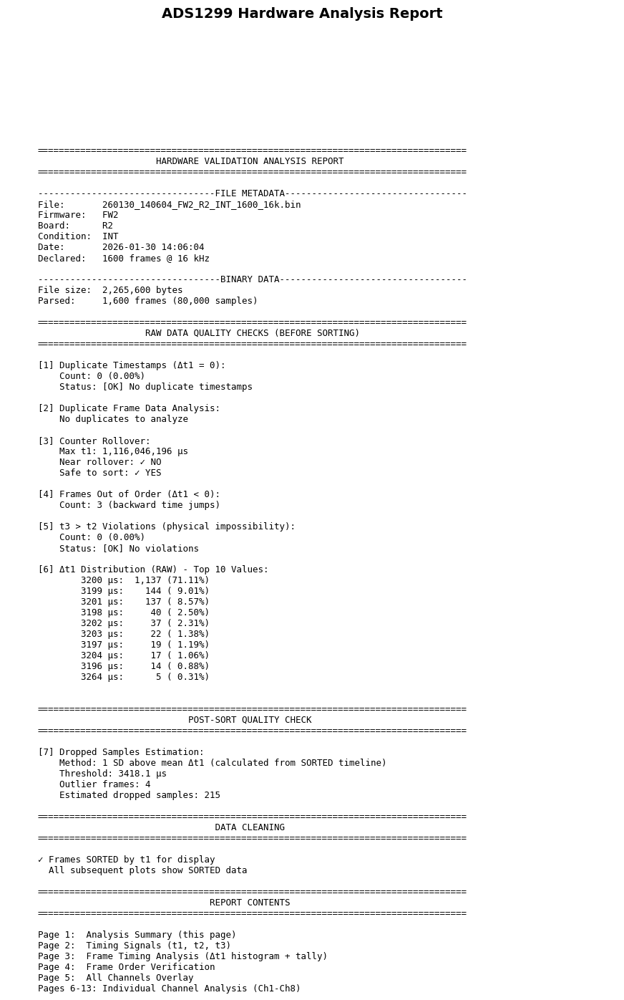

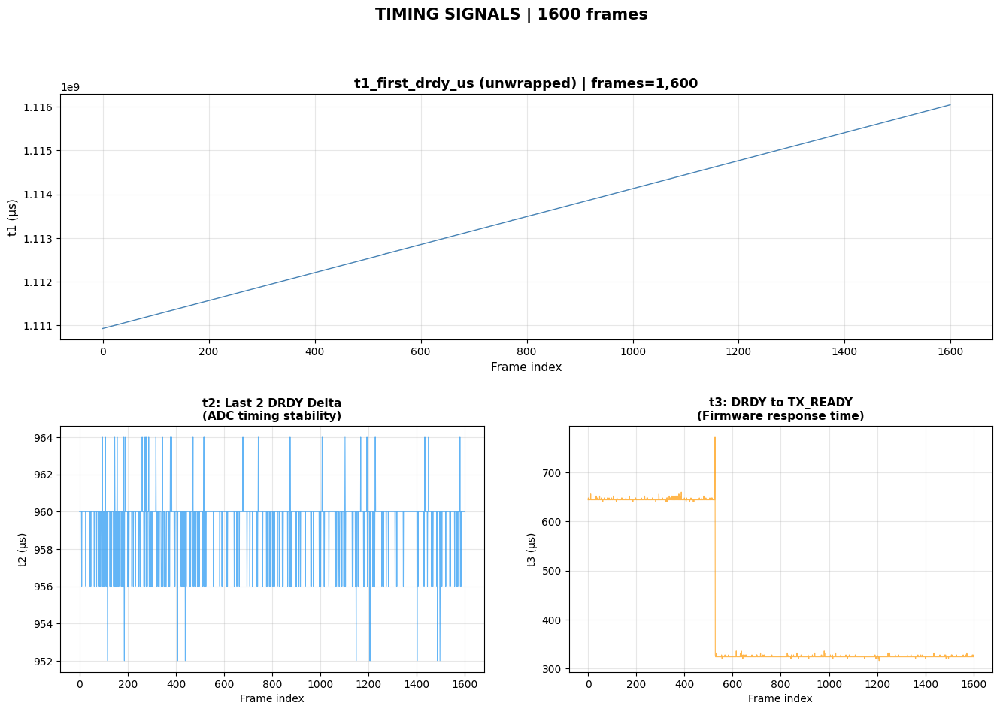

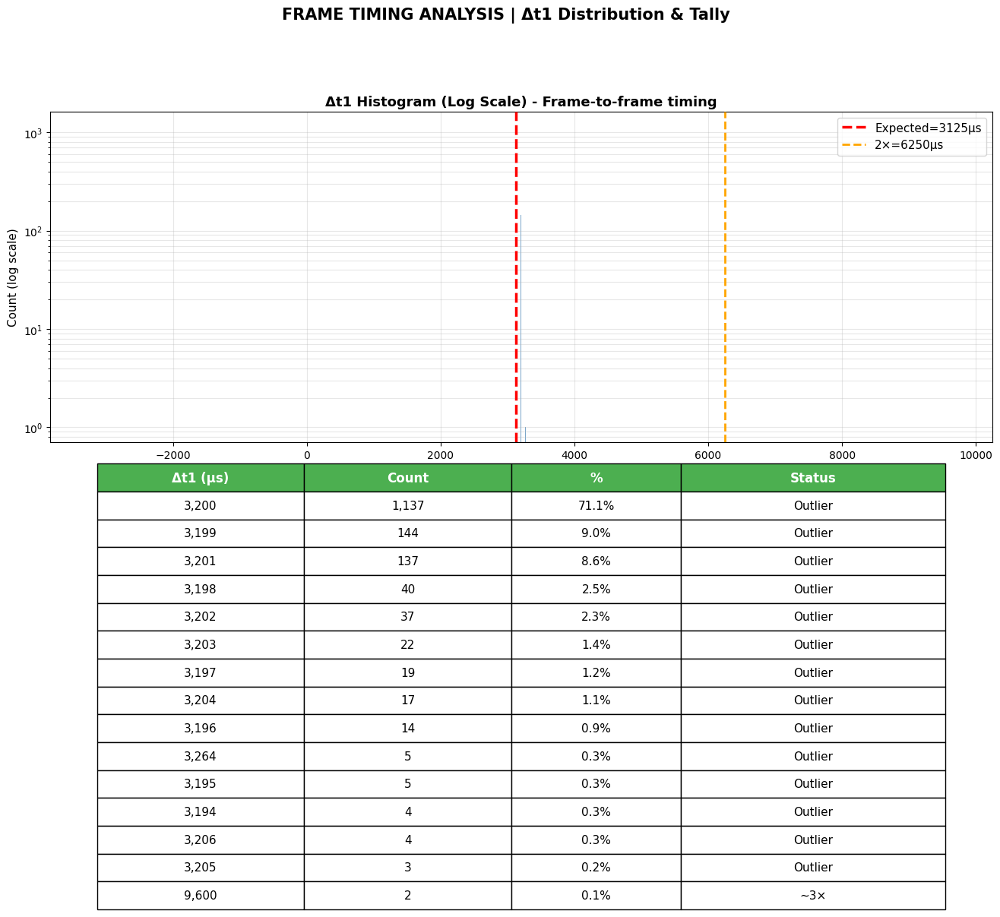

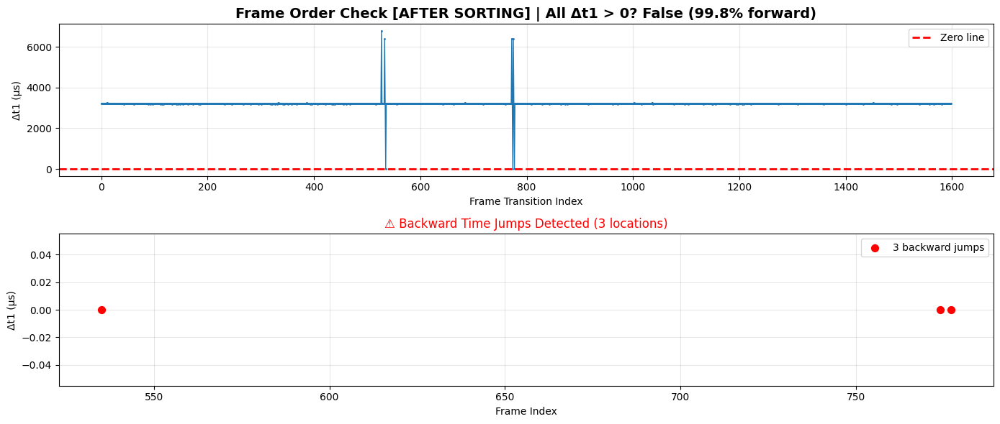

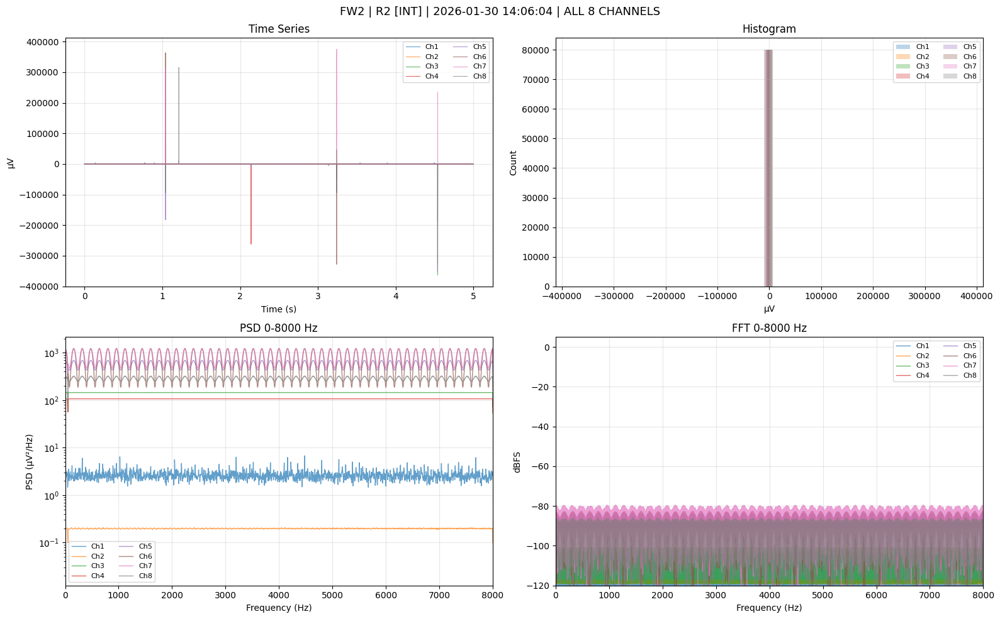

...

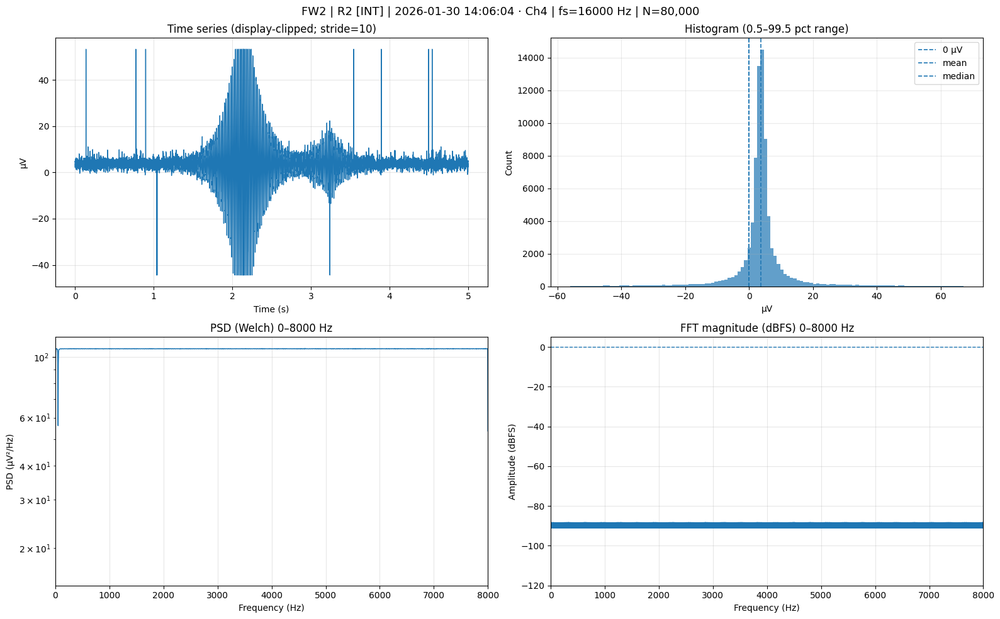

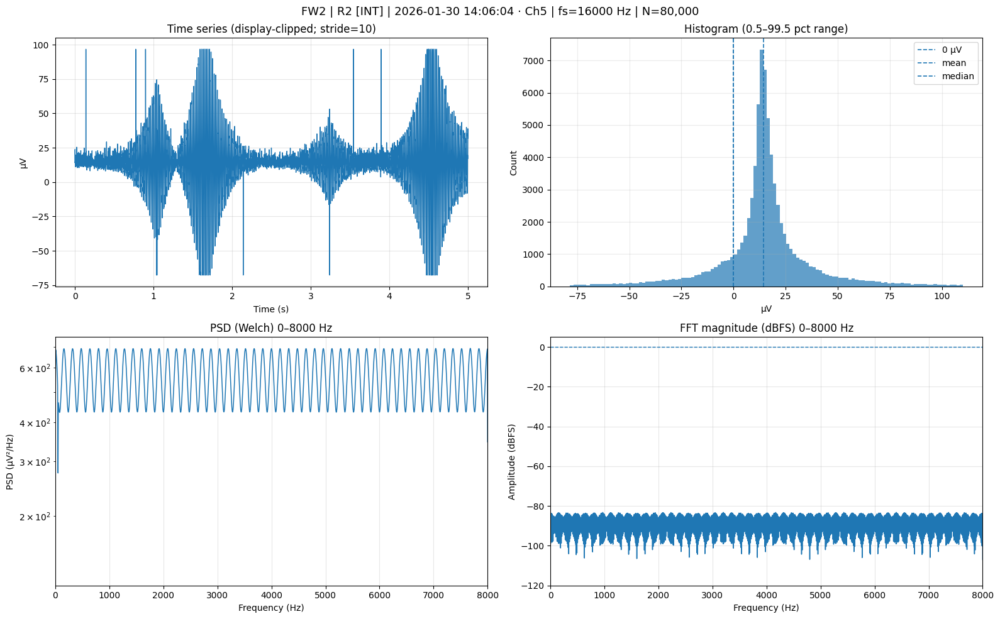

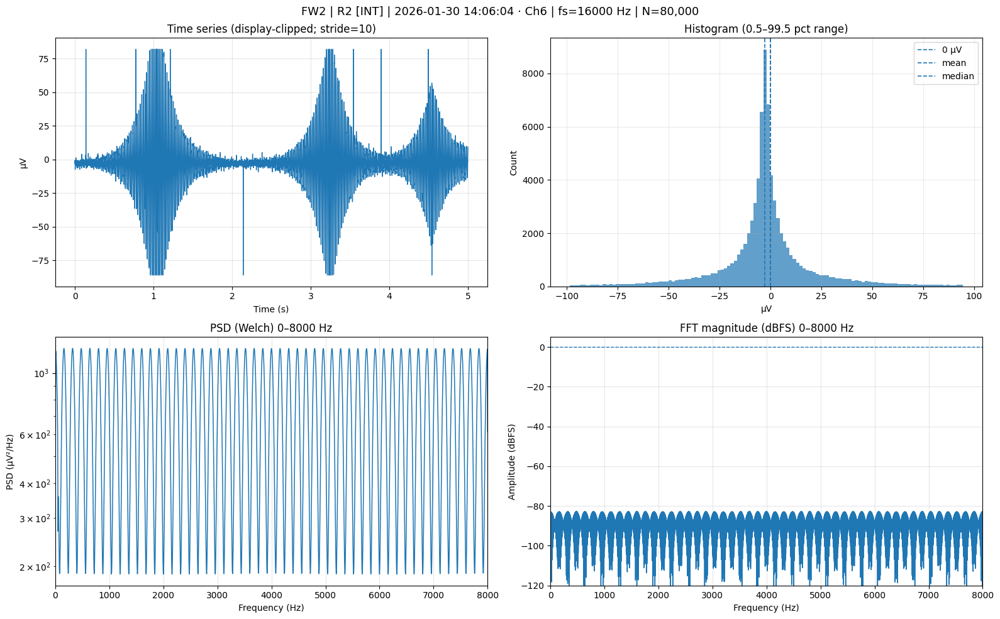

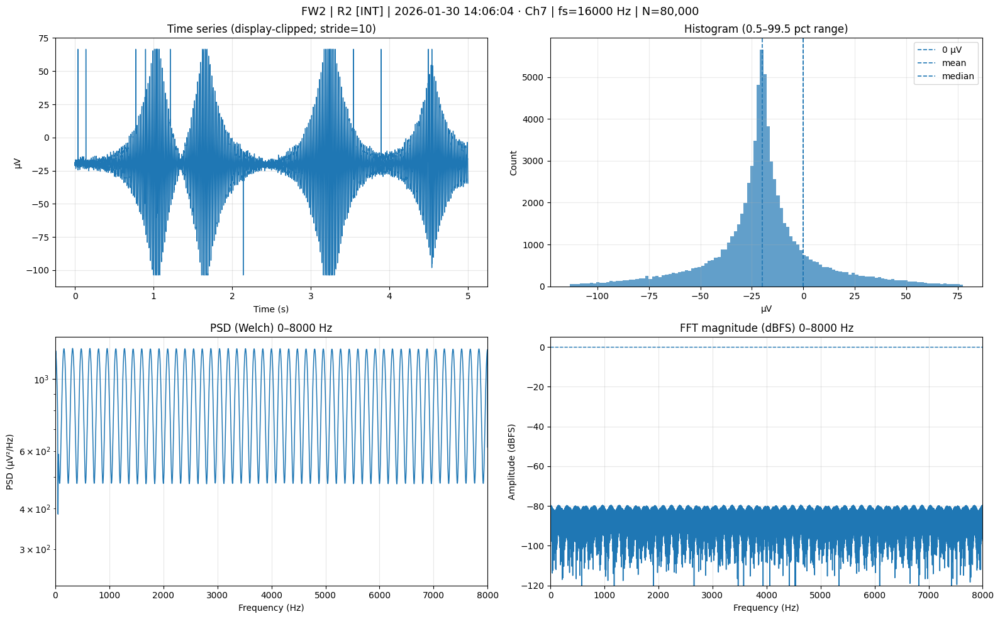

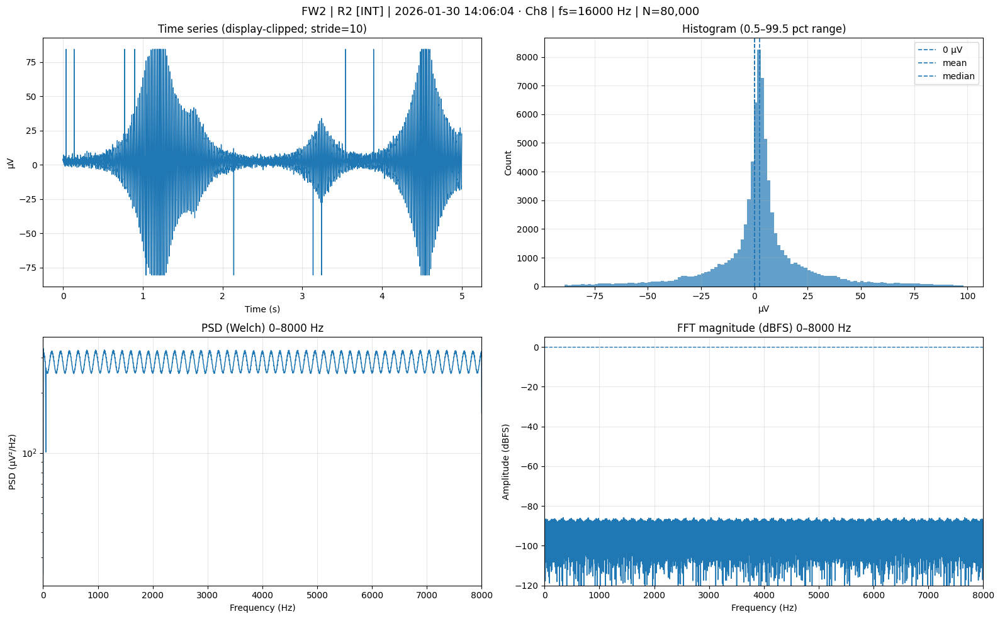


✓ Exporting PDF: 260130_140604_FW2_R2_INT_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

📊 ANALYSIS SUMMARY:
  File: FW2 | R2 [INT] | 2026-01-30
  Frames: 1,600
  Samples: 80,000
  Was sorted: True
  Plots generated: 13

🔍 RAW DATA CHECKS:
  Duplicate timestamps: 0
  Backward jumps: 3
  t3>t2 violations: 0
  Duplicate frame data - identical: 0
  Duplicate frame data - different: 0


In [85]:

results = analyze_bin_file(
    BIN_PATH,
    display_plots=True,
    export_pdf=True,
)

# Final Summary
fw = results['filename_meta']['firmware'] or '?'
bd = results['filename_meta']['board'] or '?'
date = results['filename_meta']['date'] or '?'
cond = results['filename_meta'].get('condition', '?')

print(f"\n📊 ANALYSIS SUMMARY:")
print(f"  File: {fw} | {bd} [{cond}] | {date}")
print(f"  Frames: {results['meta']['n_frames']:,}")
print(f"  Samples: {results['meta']['n_samples']:,}")
print(f"  Was sorted: {results['was_sorted']}")
print(f"  Plots generated: {len(results['plots'])}")

# Show RAW data check results
print(f"\n🔍 RAW DATA CHECKS:")
print(f"  Duplicate timestamps: {results['raw_checks']['timestamp']['zero_count']}")
print(f"  Backward jumps: {results['raw_checks']['timestamp']['negative_count']}")
print(f"  t3>t2 violations: {results['raw_checks']['physics']['violation_count']}")
print(f"  Duplicate frame data - identical: {results['raw_checks']['duplicate_data']['identical_data_count']}")
print(f"  Duplicate frame data - different: {results['raw_checks']['duplicate_data']['different_data_count']}")


## NOISE ANALYSIS

### Input Noise 


================== A1: INTERNAL NOISE FLOOR (SHORTED INPUTS) ===================
================================ FILE METADATA =================================
File:       260130_140604_FW2_R2_INT_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  INT
Date:       2026-01-30 14:06:04
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
    M

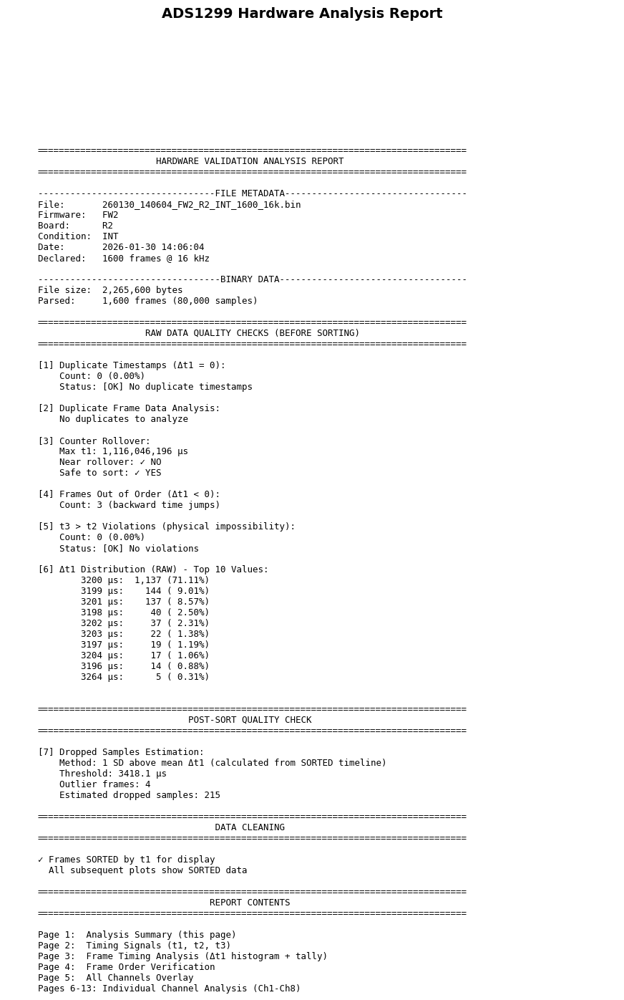

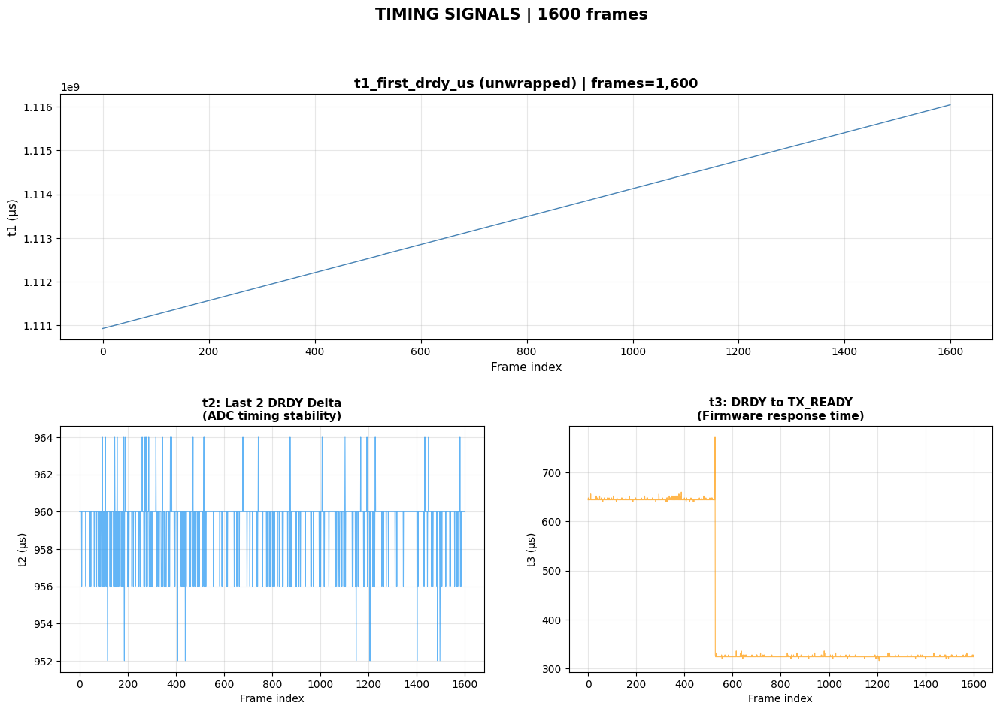

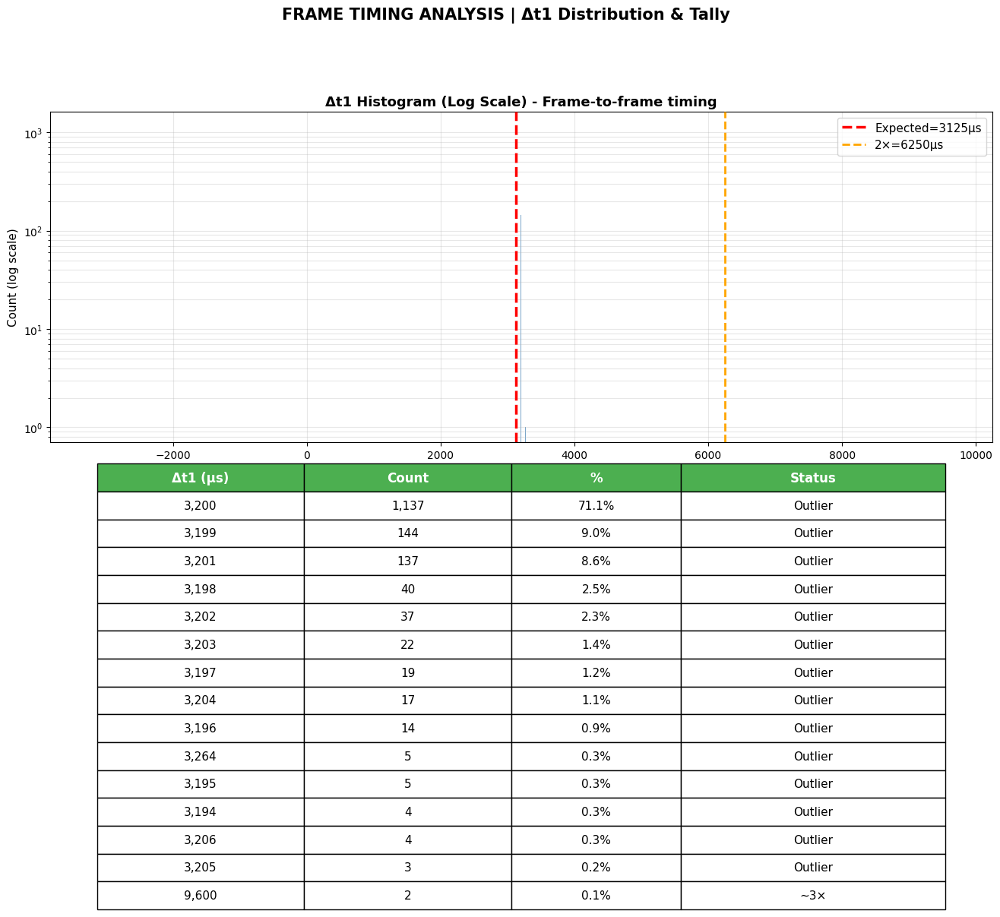

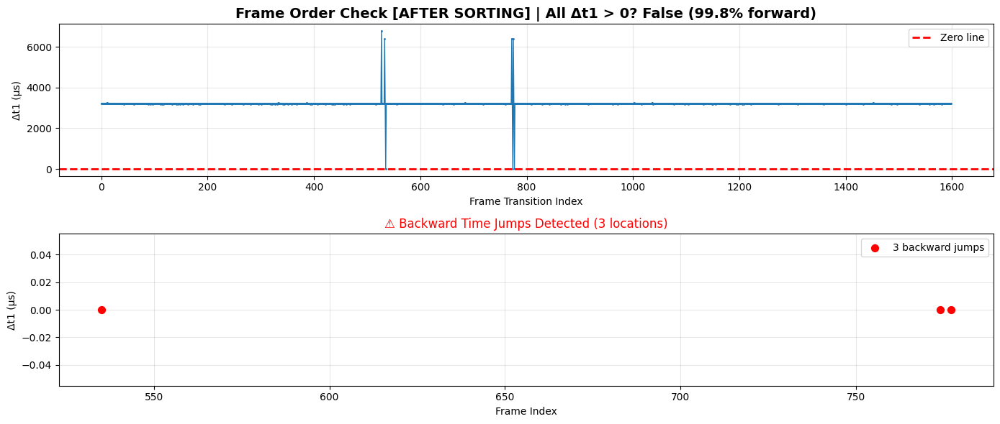

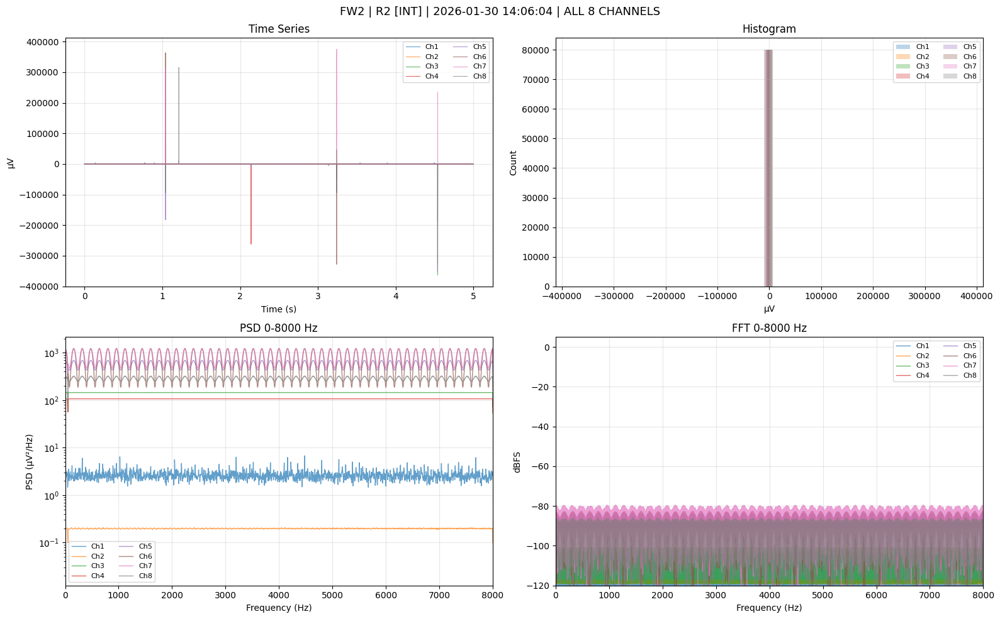

...

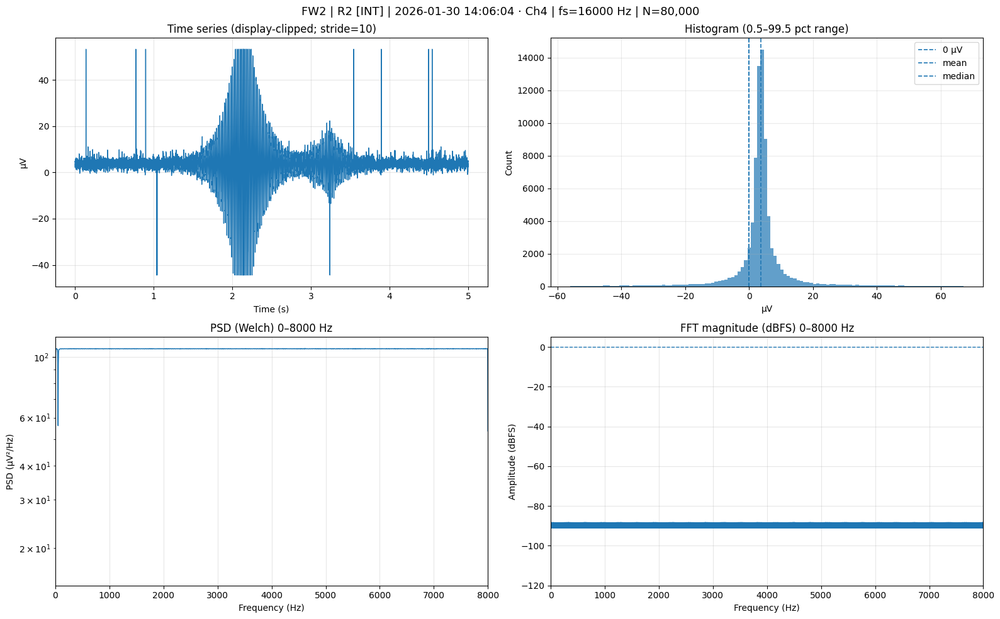

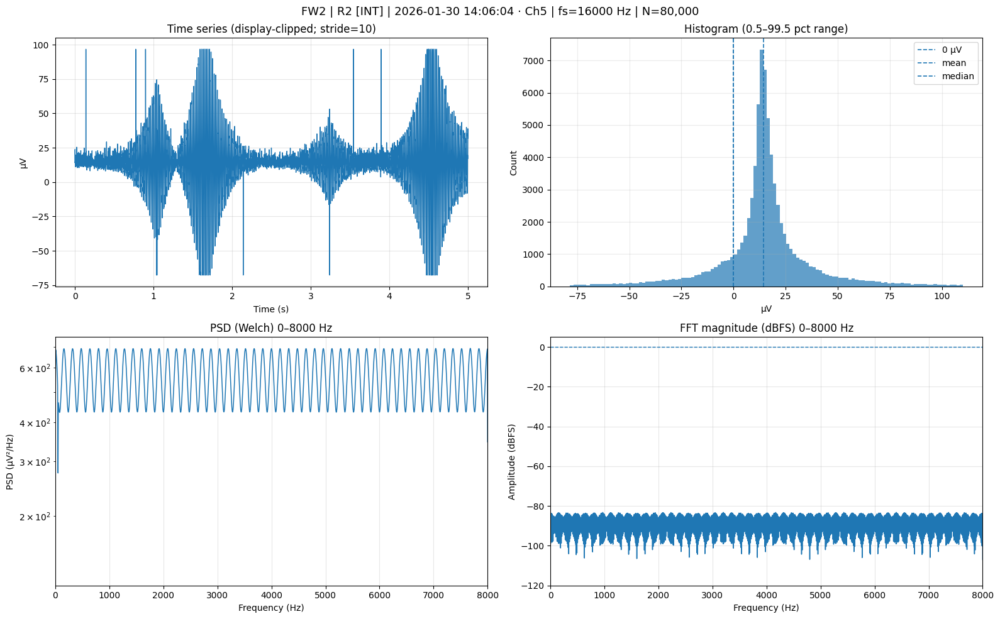

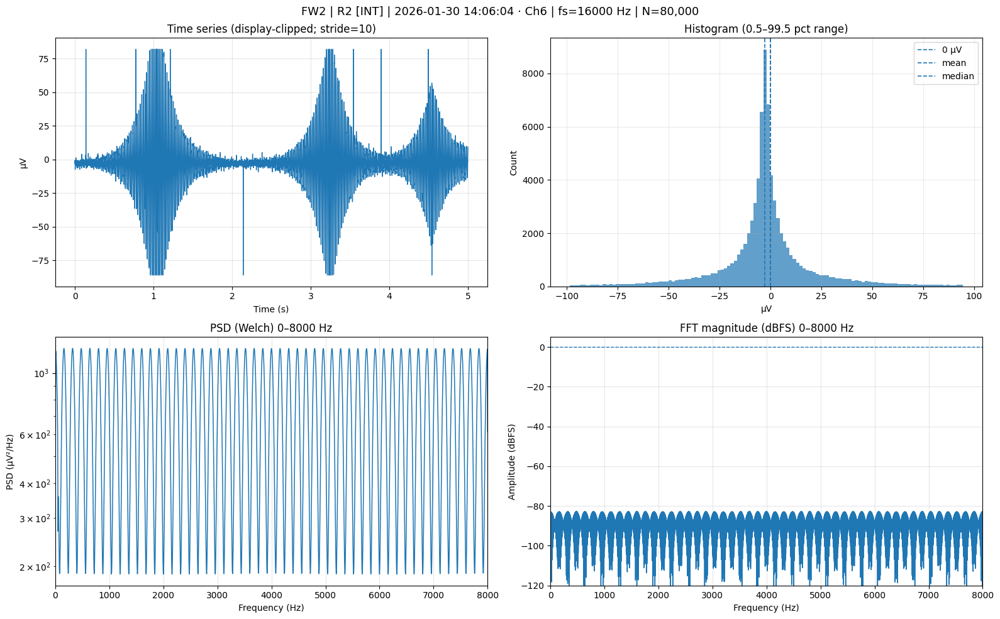

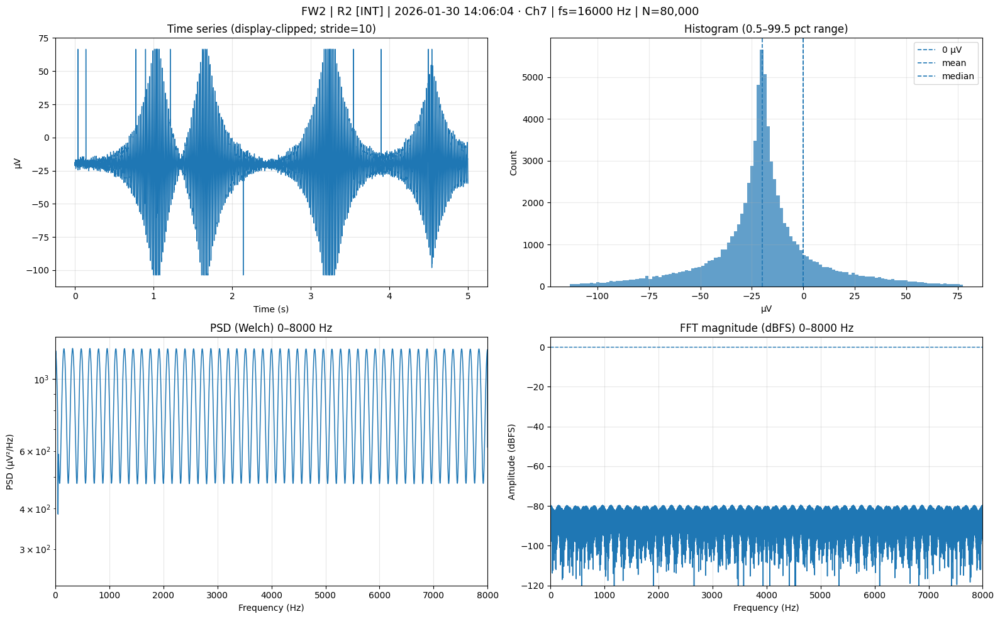

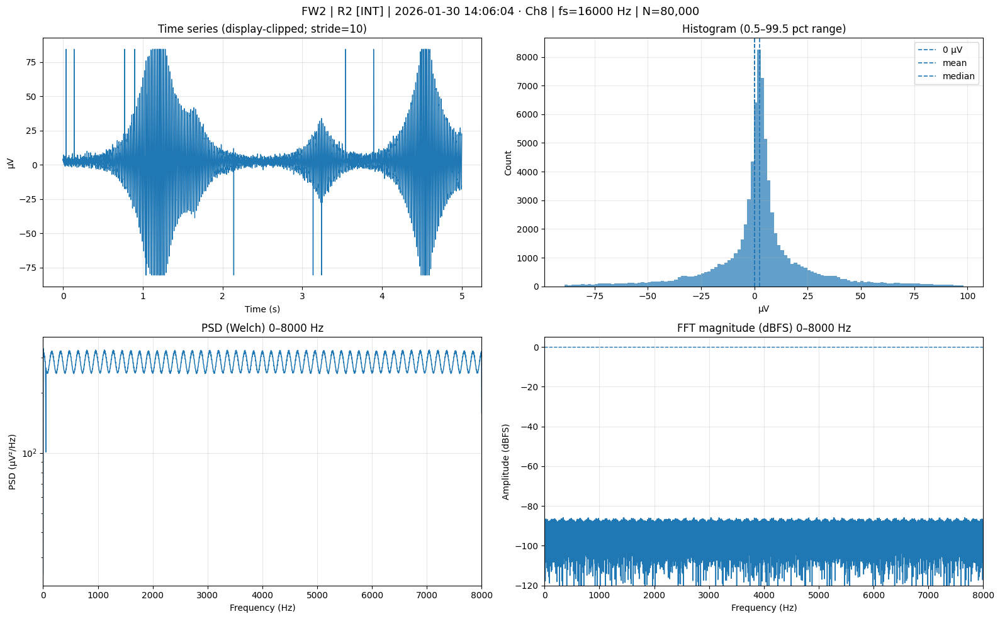


✓ Exporting PDF: 260130_140604_FW2_R2_INT_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ A1 Internal noise analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([1110925364, 1110928565, 1110931764, ..., 1116039796, 1116042996,
          1116046196], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([161, 162, 161, ...,  81,  82,  81], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 7000,  7050,  7100, ..., 86850, 86900, 86950],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([1110925364, 1110928565, 1110931764, ..., 1116039796, 1116042996,
          1116046196], shape=(1600,))},
  'header_first': {'t1

In [86]:
def run_internal_noise():
    """A1: Internal Noise Floor (Shorted Inputs)"""
    print("\n" + "="*80)
    print(" A1: INTERNAL NOISE FLOOR (SHORTED INPUTS) ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_INTERNAL_NOISE,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ A1 Internal noise analysis complete.")
    return results

run_internal_noise()


### Environmental Noise 


===================== A2: EXTERNAL NOISE (FLOATING INPUTS) =====================
================================ FILE METADATA =================================
File:       260130_140952_FW2_R2_EXT_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  EXT
Date:       2026-01-30 14:09:52
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
    M

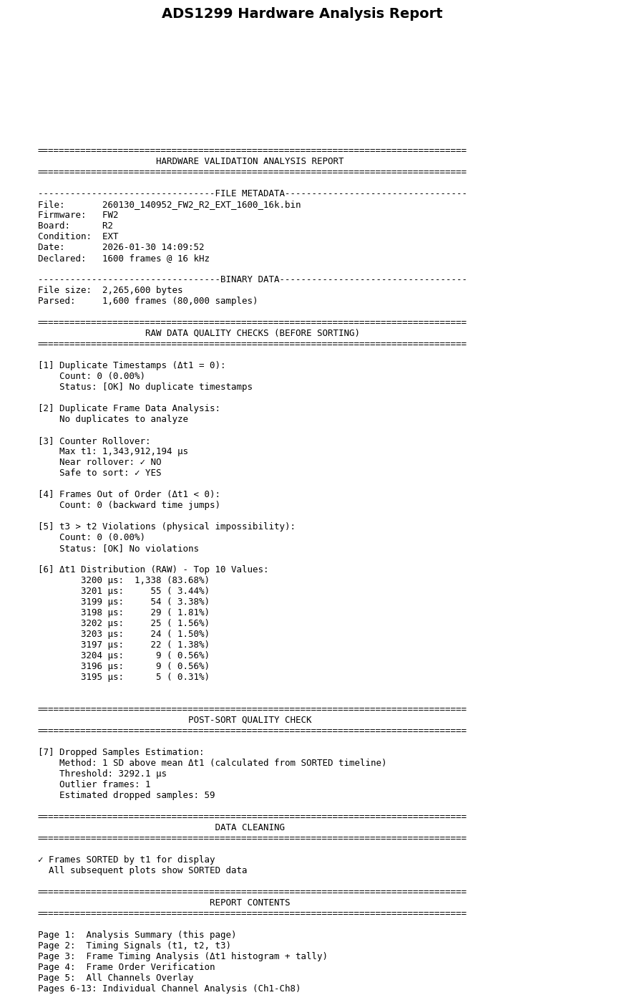

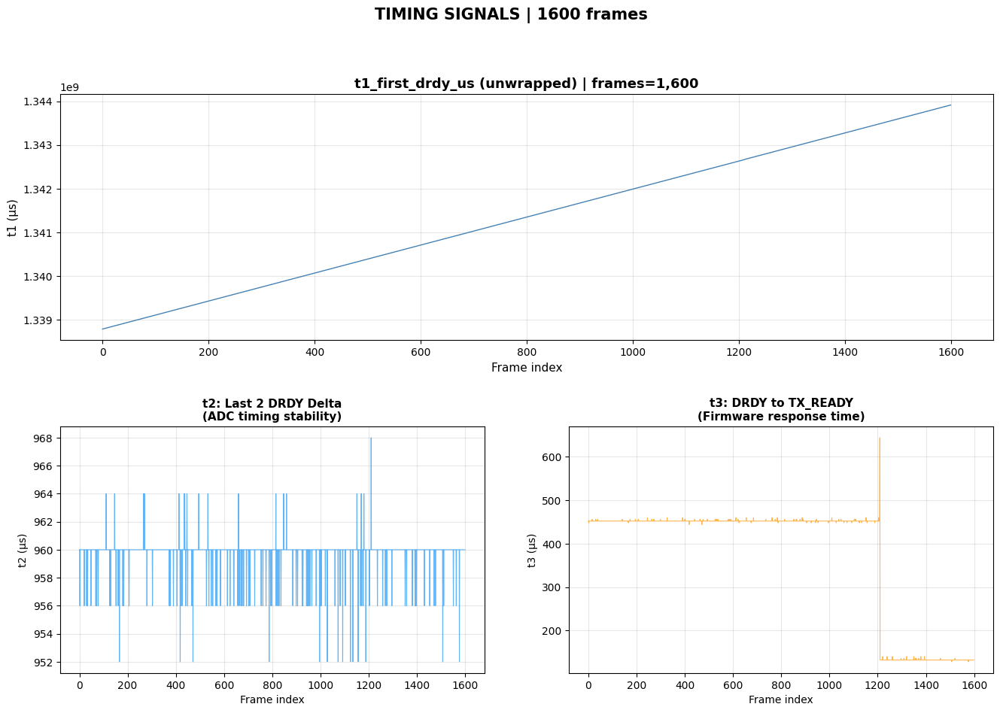

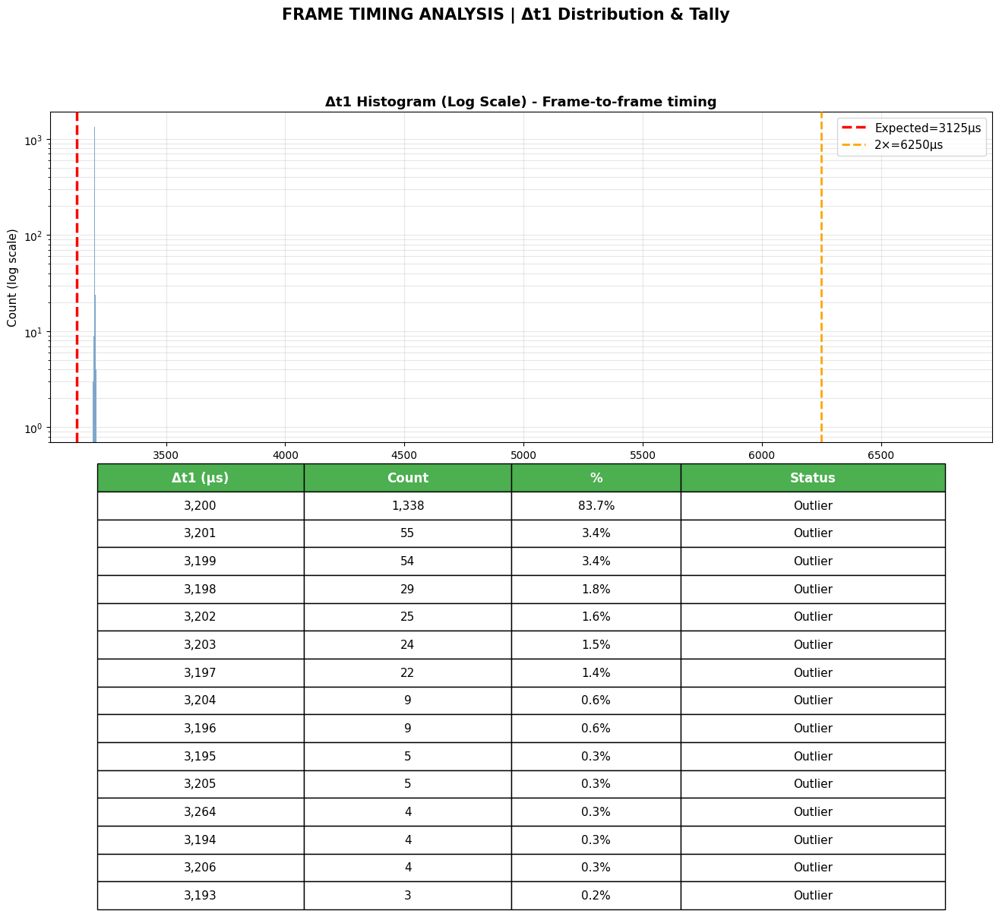

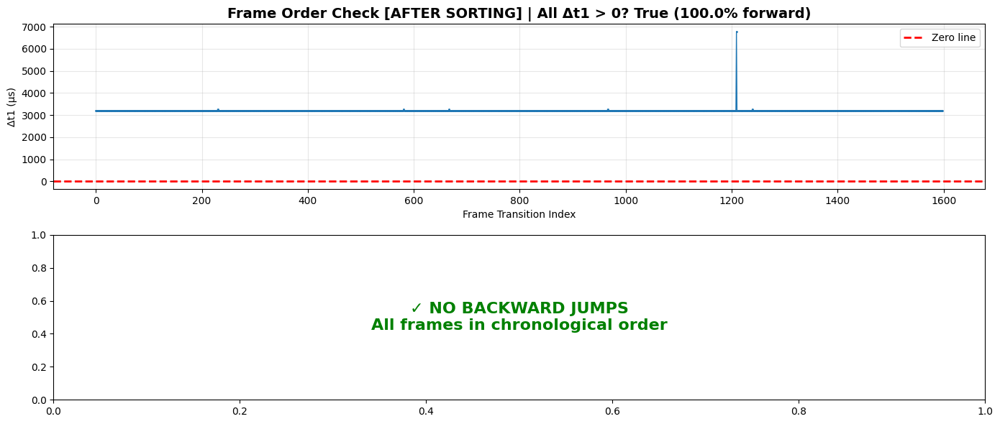

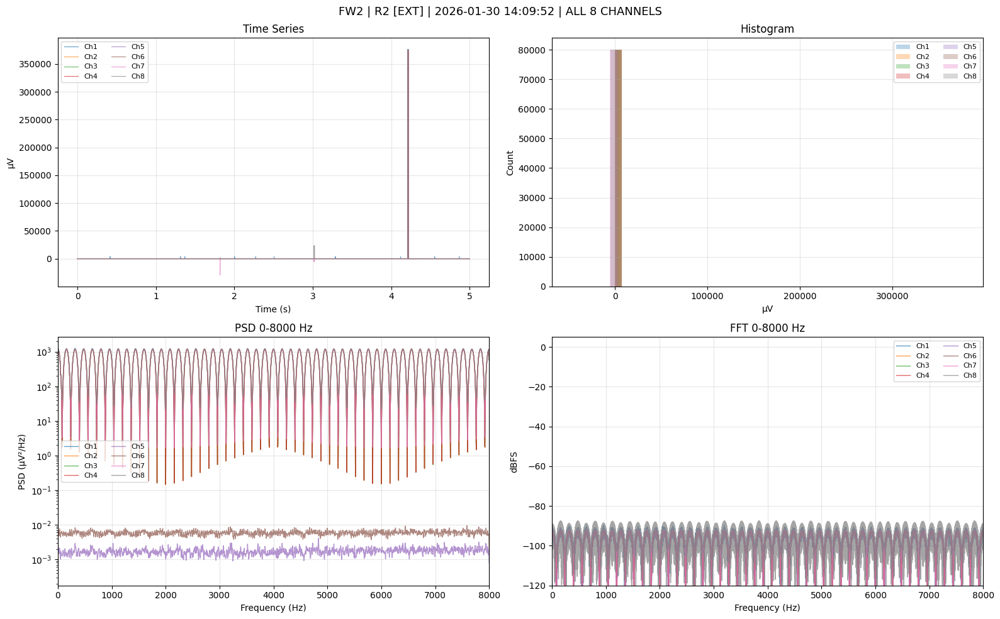

...

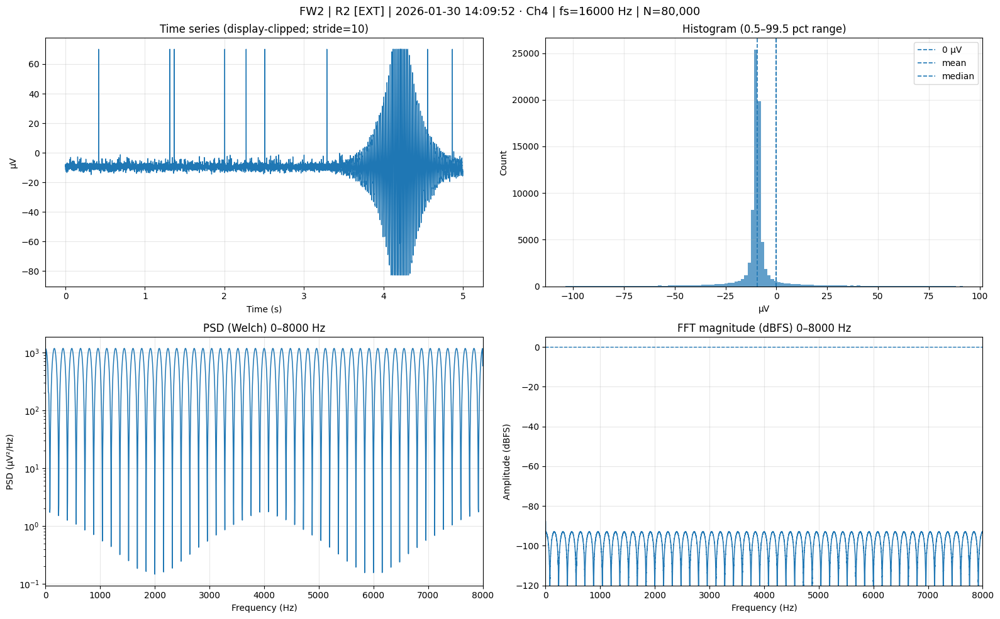

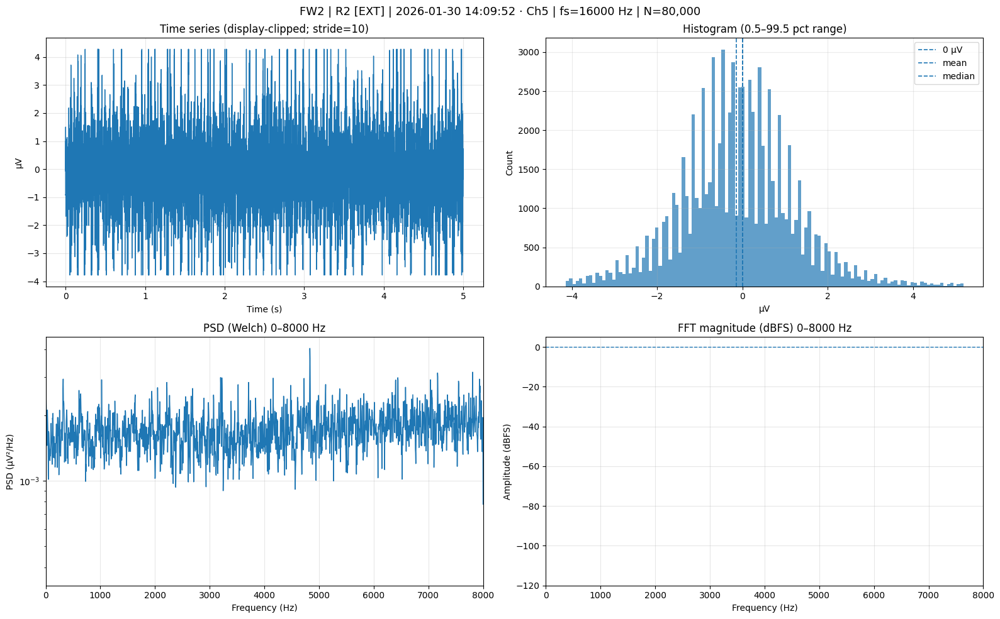

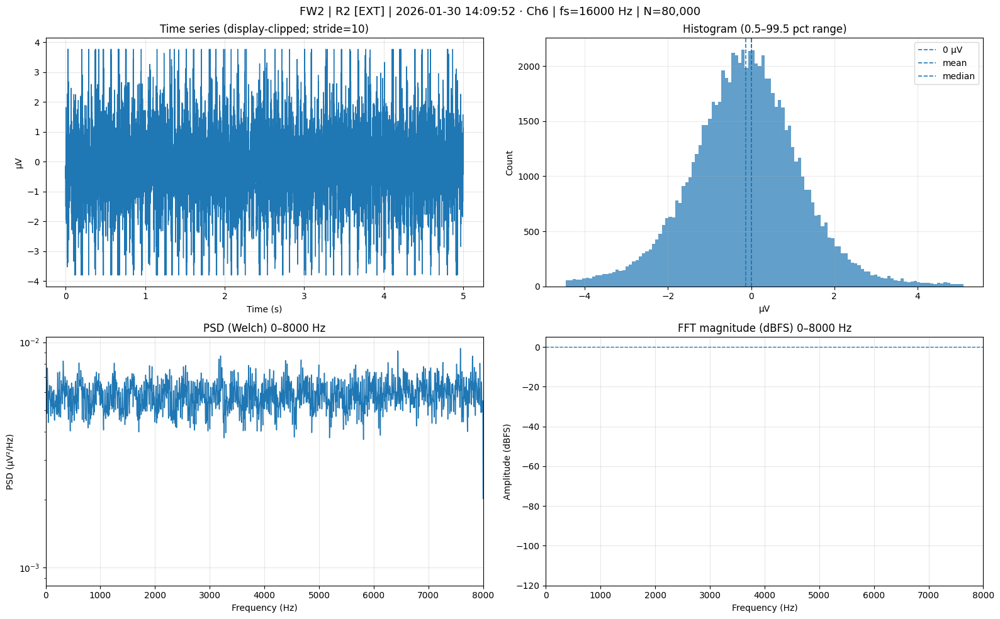

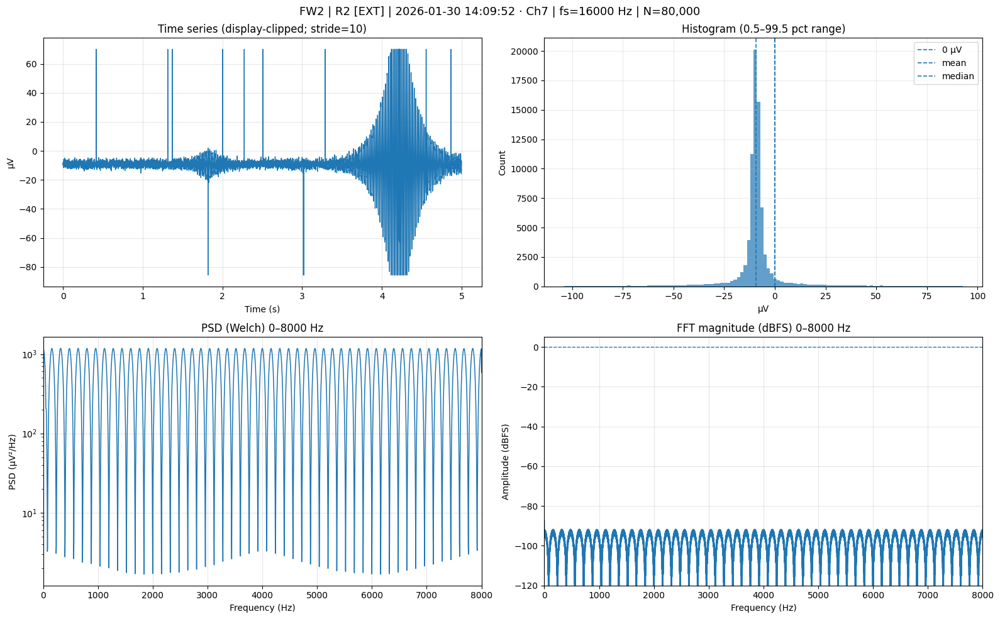

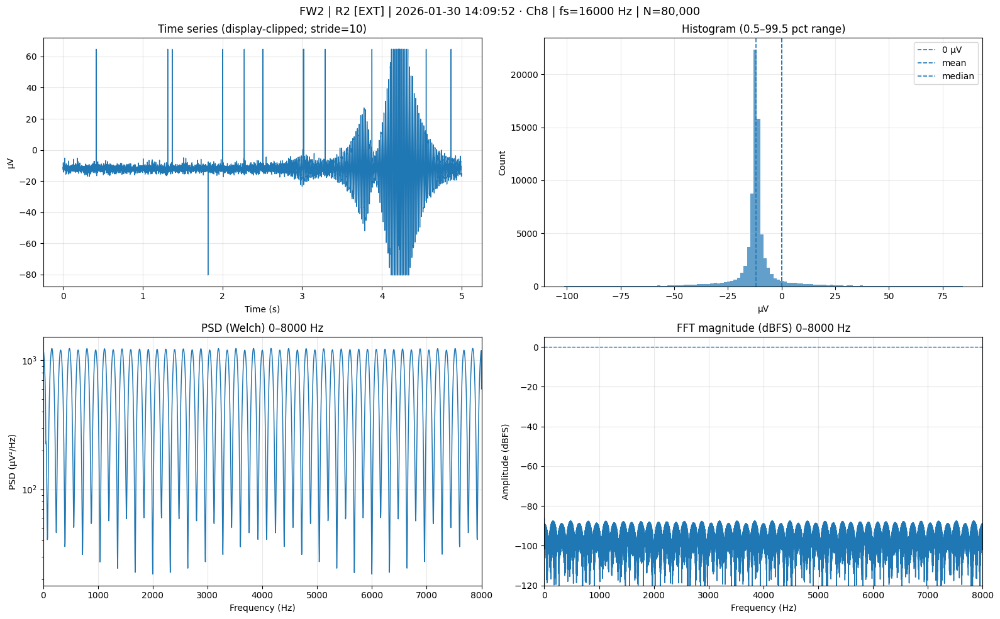


✓ Exporting PDF: 260130_140952_FW2_R2_EXT_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ A2 External noise analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([1338791490, 1338794690, 1338797894, ..., 1343905794, 1343908994,
          1343912194], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 239, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([113, 113, 112, ...,  33,  33,  33], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 7150,  7200,  7250, ..., 87000, 87050, 87100],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([1338791490, 1338794690, 1338797894, ..., 1343905794, 1343908994,
          1343912194], shape=(1600,))},
  'header_first': {'t1

In [87]:
def run_external_noise():
    """A2: External Noise (Floating Inputs)"""
    print("\n" + "="*80)
    print(" A2: EXTERNAL NOISE (FLOATING INPUTS) ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_EXTERNAL_NOISE,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ A2 External noise analysis complete.")
    return results

run_external_noise()


### Injected Noise 

In [88]:
def run_ksi_ch2():
    """B1: Known Signal Injection - Channel 2 @ 40Hz"""
    print("\n" + "="*80)
    print(" B1: KNOWN SIGNAL INJECTION - CH2 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH2,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B1 KSI CH2 analysis complete.")
    return results


def run_ksi_ch3():
    """B2: Known Signal Injection - Channel 3 @ 40Hz"""
    print("\n" + "="*80)
    print(" B2: KNOWN SIGNAL INJECTION - CH3 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH3,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B2 KSI CH3 analysis complete.")
    return results


def run_ksi_ch4():
    """B3: Known Signal Injection - Channel 4 @ 40Hz"""
    print("\n" + "="*80)
    print(" B3: KNOWN SIGNAL INJECTION - CH4 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH4,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B3 KSI CH4 analysis complete.")
    return results


def run_ksi_ch5():
    """B4: Known Signal Injection - Channel 5 @ 40Hz"""
    print("\n" + "="*80)
    print(" B4: KNOWN SIGNAL INJECTION - CH5 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH5,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B4 KSI CH5 analysis complete.")
    return results


def run_ksi_ch6():
    """B5: Known Signal Injection - Channel 6 @ 40Hz"""
    print("\n" + "="*80)
    print(" B5: KNOWN SIGNAL INJECTION - CH6 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH6,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B5 KSI CH6 analysis complete.")
    return results


def run_ksi_ch7():
    """B6: Known Signal Injection - Channel 7 @ 40Hz"""
    print("\n" + "="*80)
    print(" B6: KNOWN SIGNAL INJECTION - CH7 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH7,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B6 KSI CH7 analysis complete.")
    return results


def run_ksi_ch8():
    """B7: Known Signal Injection - Channel 8 @ 40Hz"""
    print("\n" + "="*80)
    print(" B7: KNOWN SIGNAL INJECTION - CH8 @ 40Hz ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_KSI_CH8,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ B7 KSI CH8 analysis complete.")
    return results


def run_all_ksi():
    """Run all KSI tests (CH2-CH8) sequentially"""
    print("\n" + "="*80)
    print(" RUNNING ALL KSI TESTS (CH2-CH8) ".center(80, "="))
    print("="*80)
    
    channels = [
        (2, BIN_KSI_CH2),
        (3, BIN_KSI_CH3),
        (4, BIN_KSI_CH4),
        (5, BIN_KSI_CH5),
        (6, BIN_KSI_CH6),
        (7, BIN_KSI_CH7),
        (8, BIN_KSI_CH8),
    ]
    
    results = {}
    for ch_num, bin_path in channels:
        print(f"\n▶ Processing CH{ch_num}...")
        results[f'ch{ch_num}'] = analyze_bin_file(
            bin_path,
            display_plots=False,  # Don't show plots during batch
            export_pdf=True,
        )
    
    print("\n" + "="*80)
    print("✓ ALL KSI TESTS COMPLETE")
    print("="*80)
    return results



=================== B1: KNOWN SIGNAL INJECTION - CH2 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142125_FW2_R2_KSI_CH2_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:21:25
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

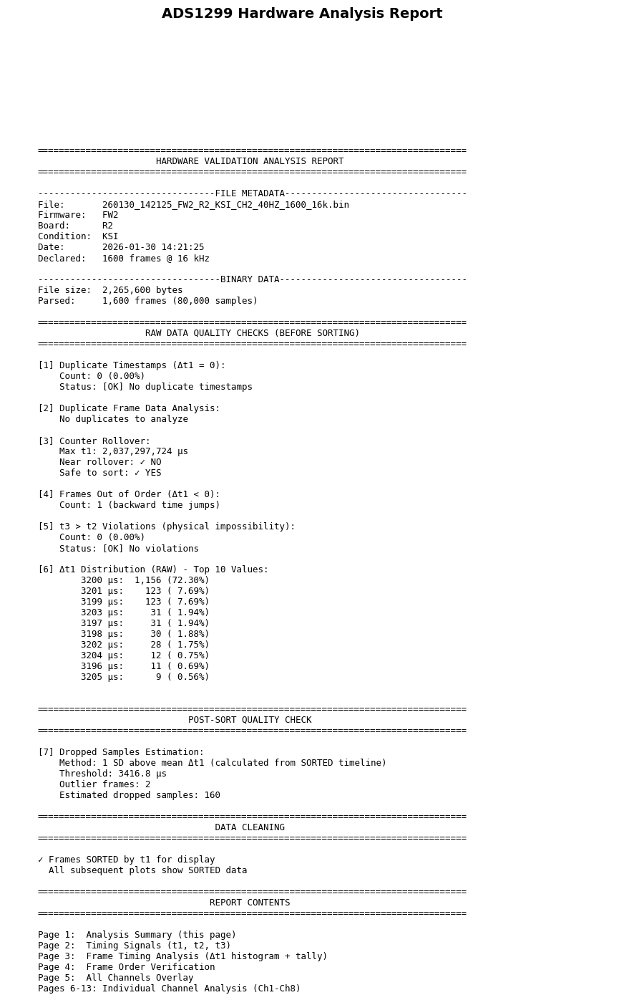

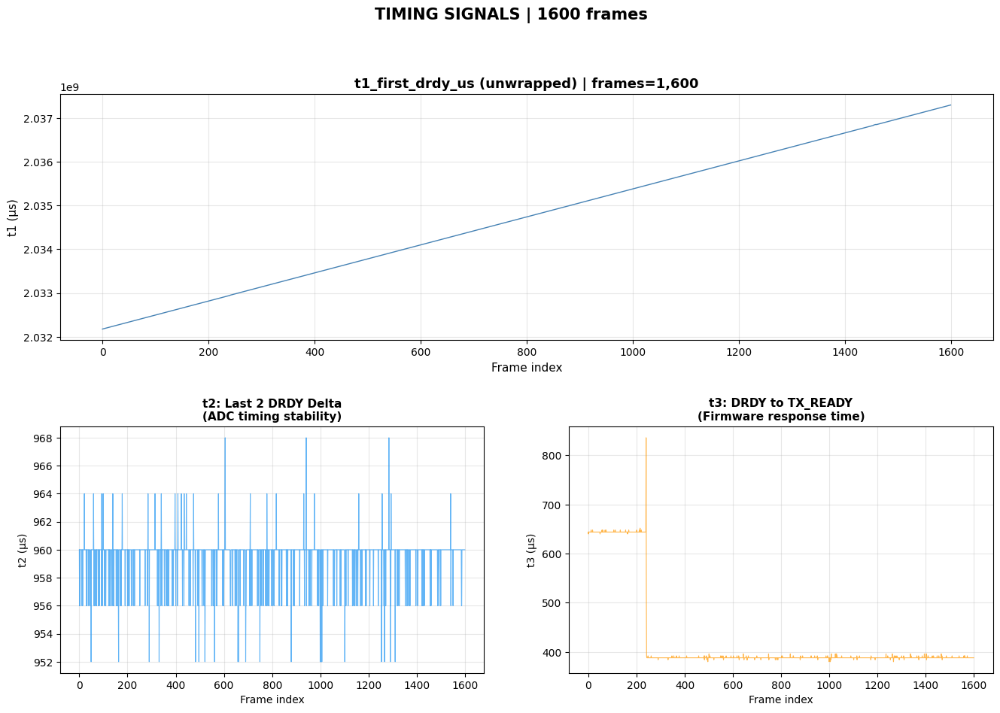

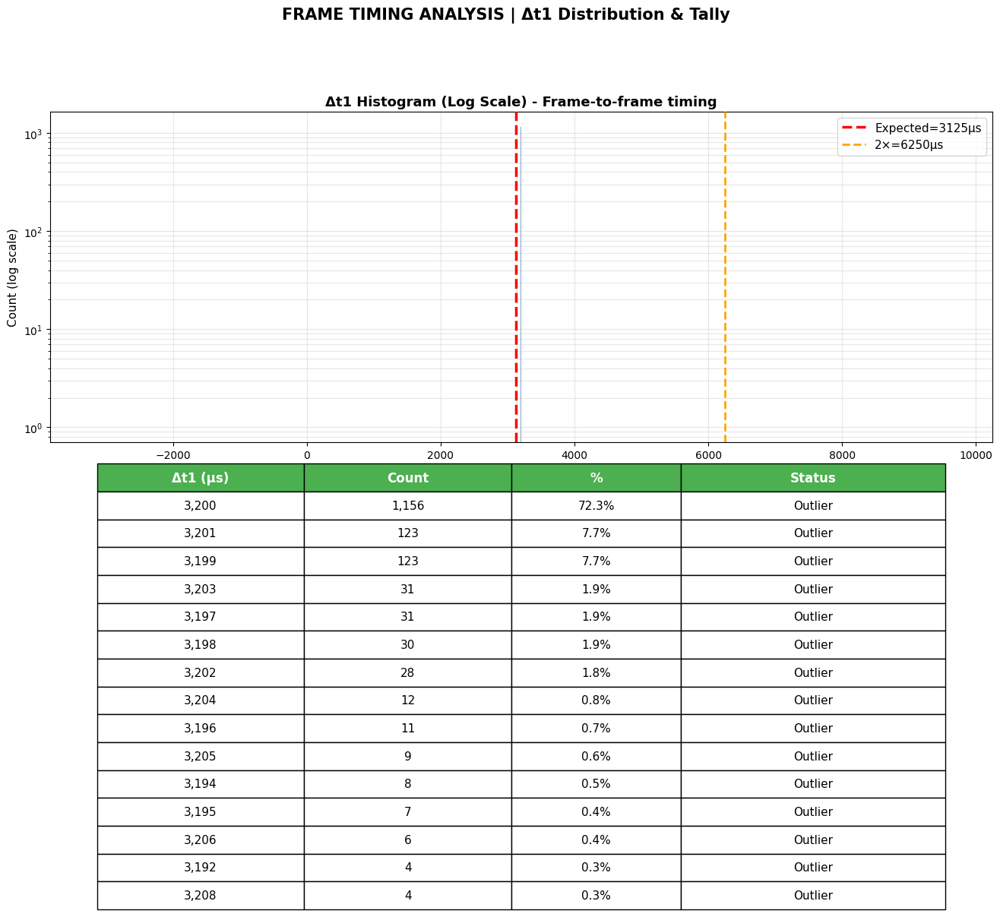

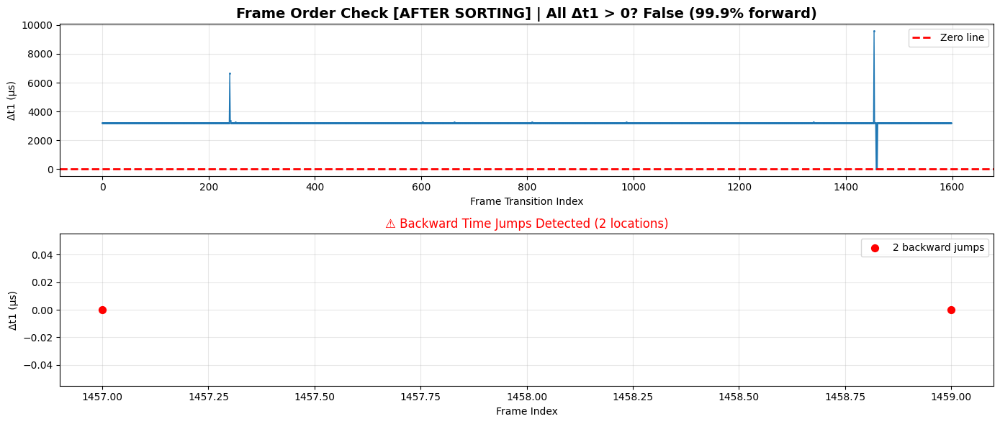

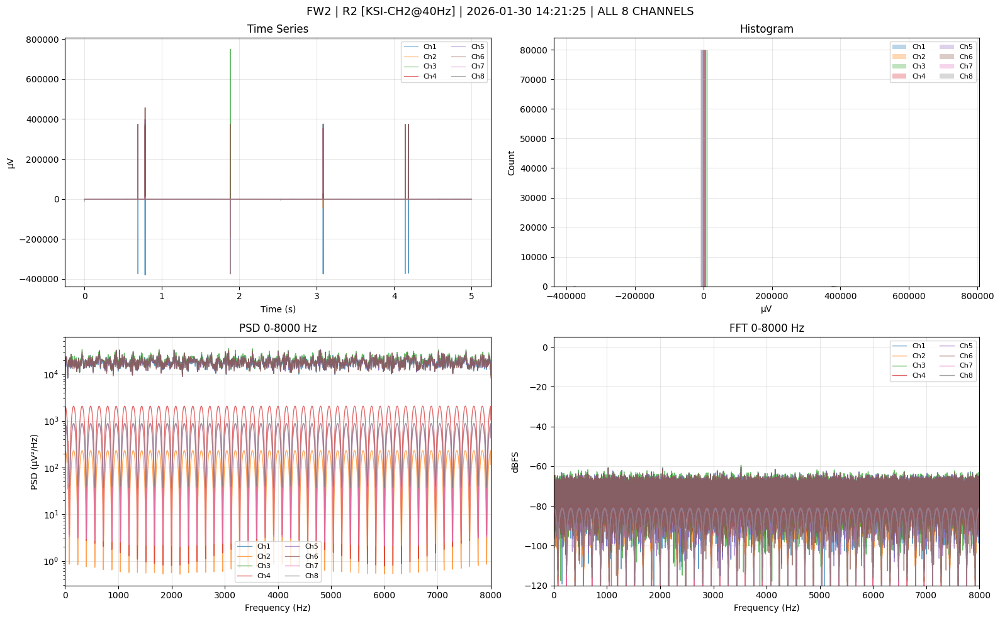

...

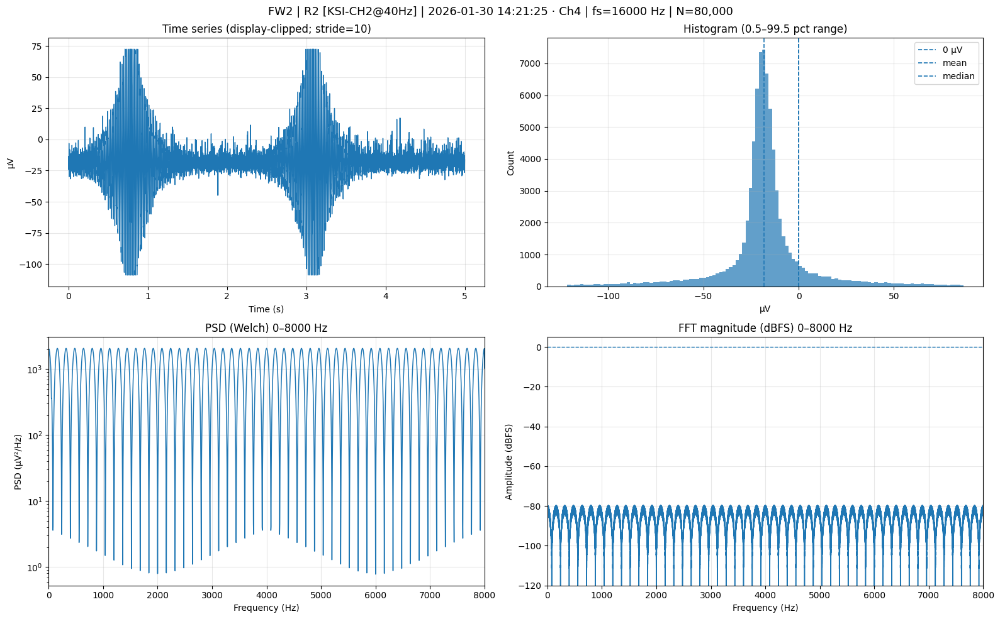

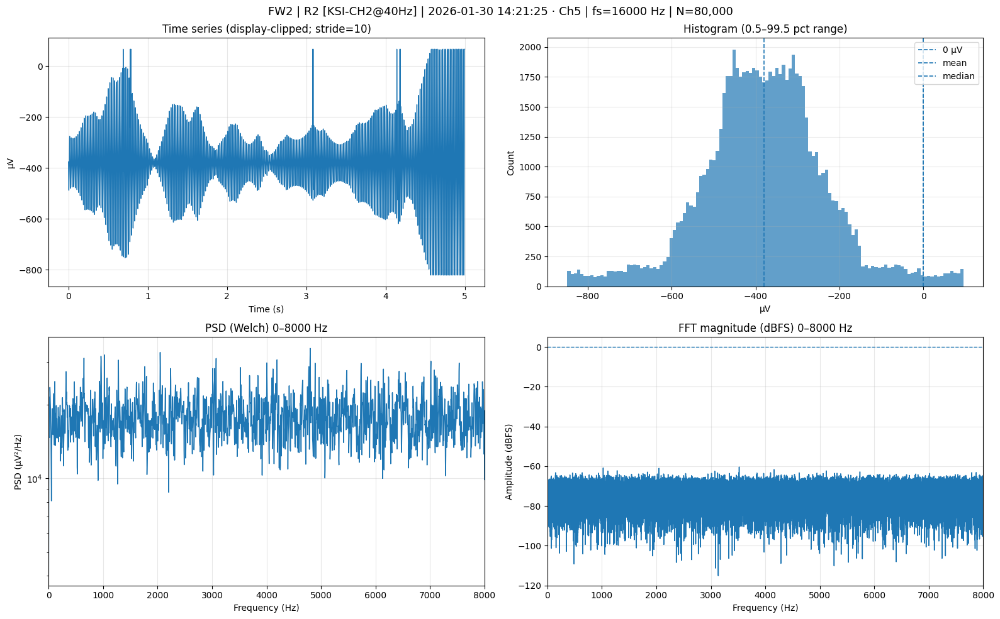

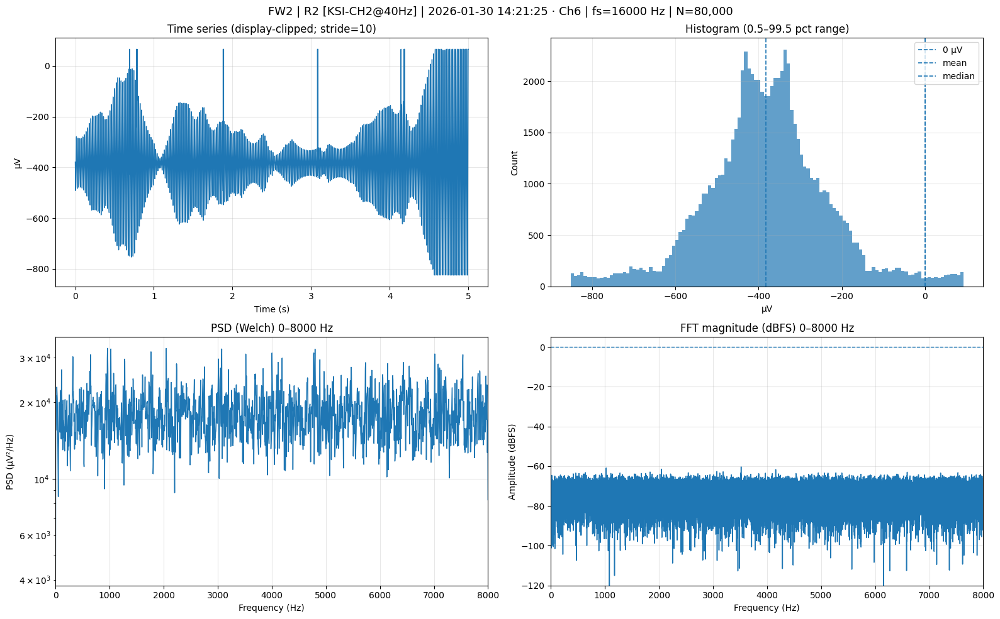

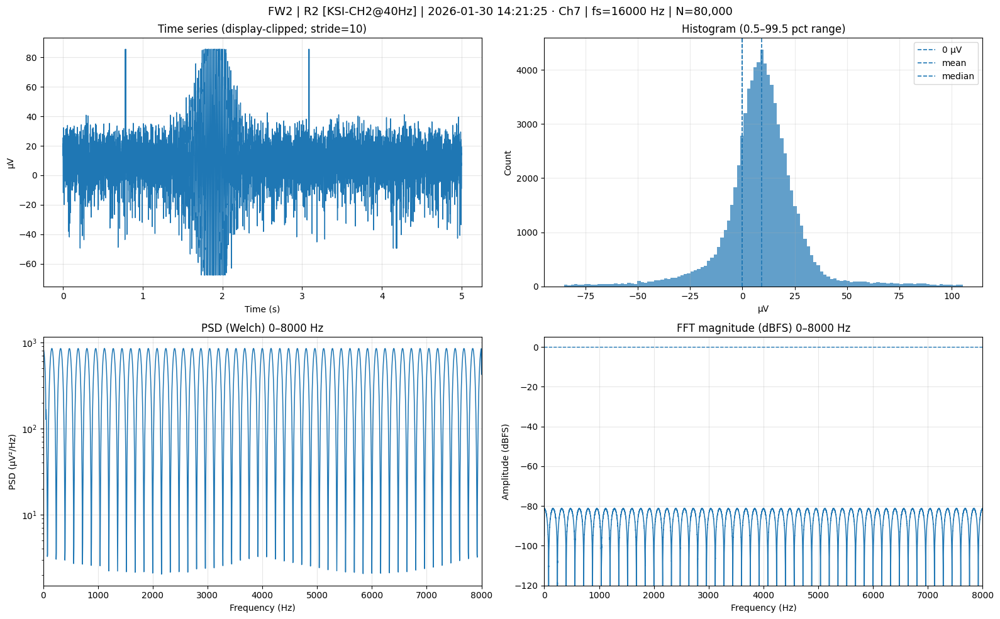

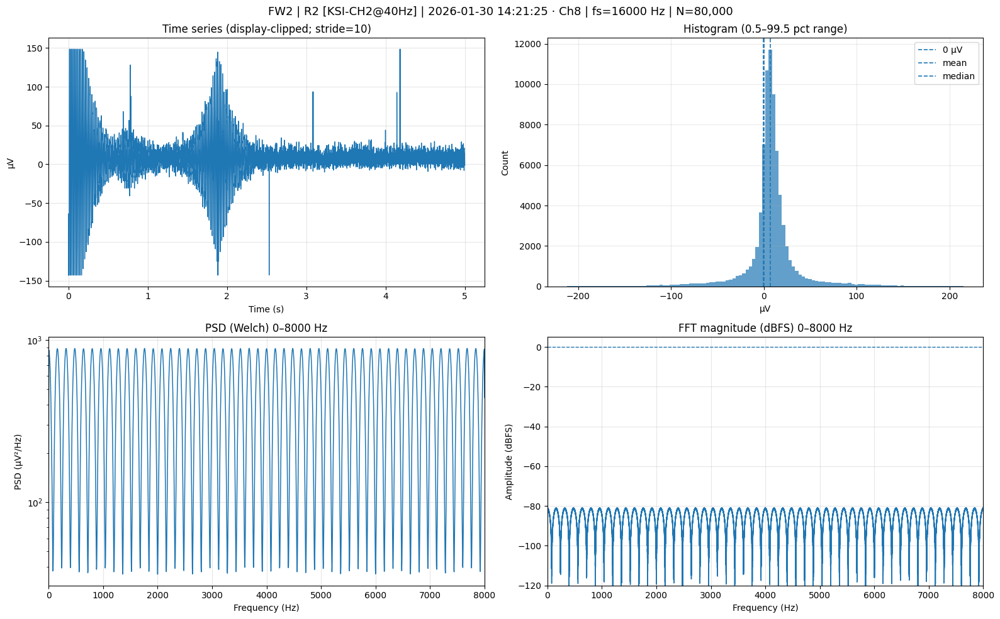


✓ Exporting PDF: 260130_142125_FW2_R2_KSI_CH2_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B1 KSI CH2 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2032176956, 2032180161, 2032183356, ..., 2037291324, 2037294524,
          2037297724], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 239, 240, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([161, 160, 161, ...,  97,  97,  97], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 6800,  6850,  6900, ..., 86650, 86700, 86750],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2032176956, 2032180161, 2032183356, ..., 2037291324, 2037294524,
          2037297724], shape=(1600,))},
  'header_first': {'t1

In [89]:
run_ksi_ch2()


=================== B2: KNOWN SIGNAL INJECTION - CH3 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142322_FW2_R2_KSI_CH3_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:23:22
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

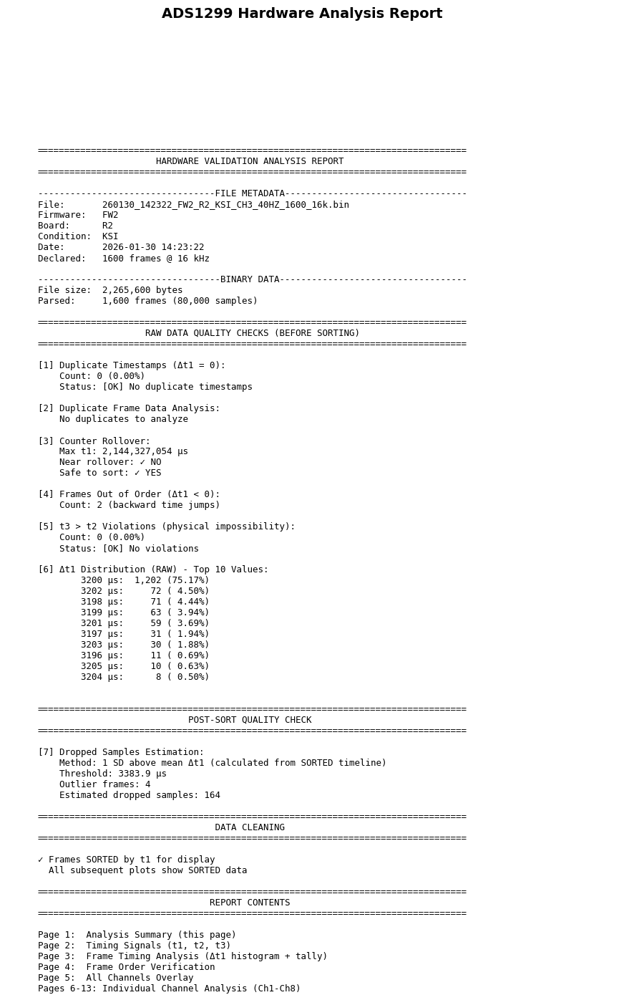

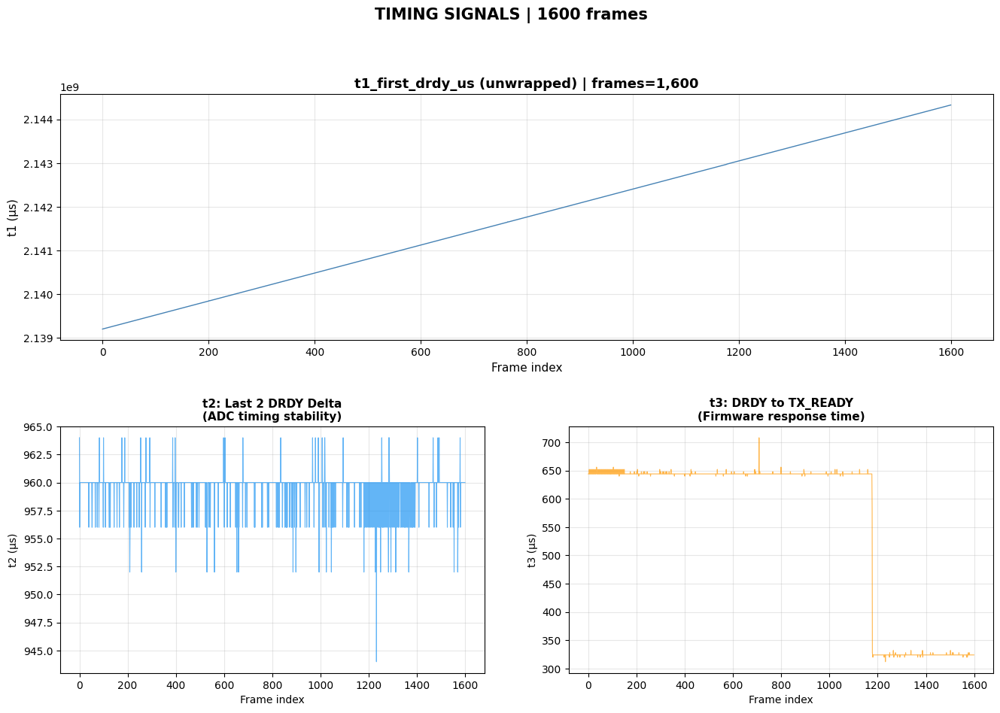

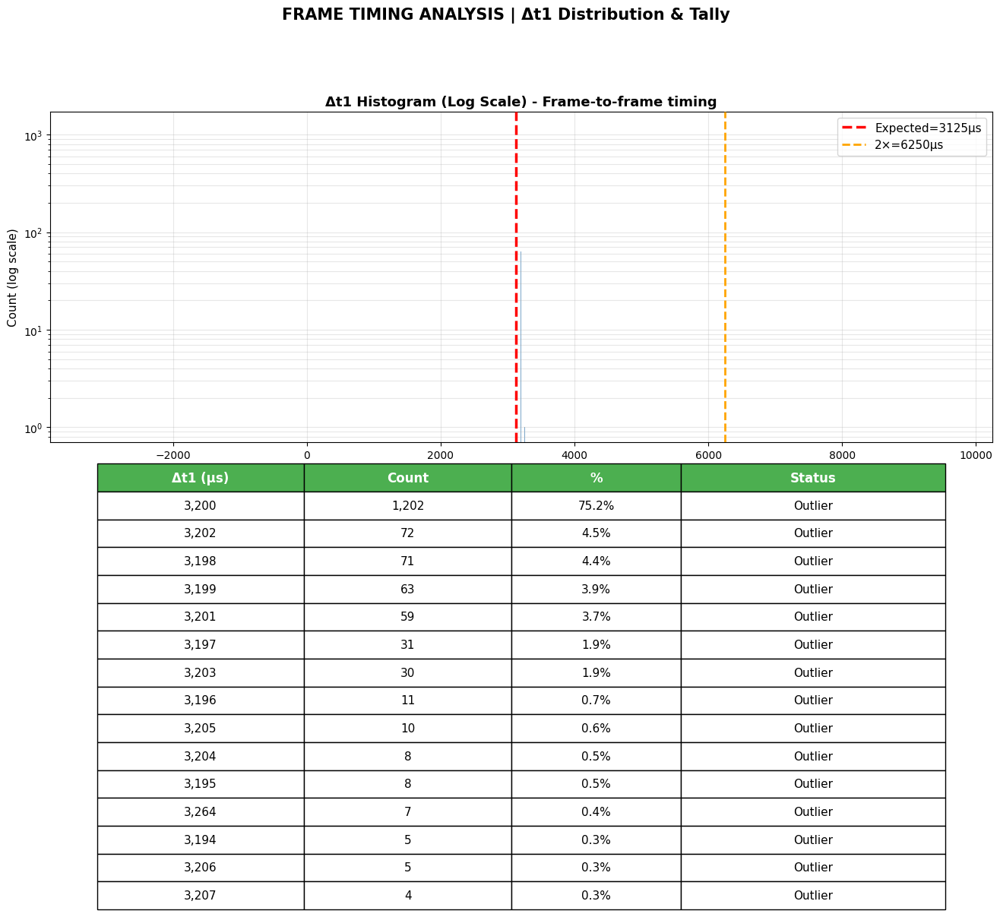

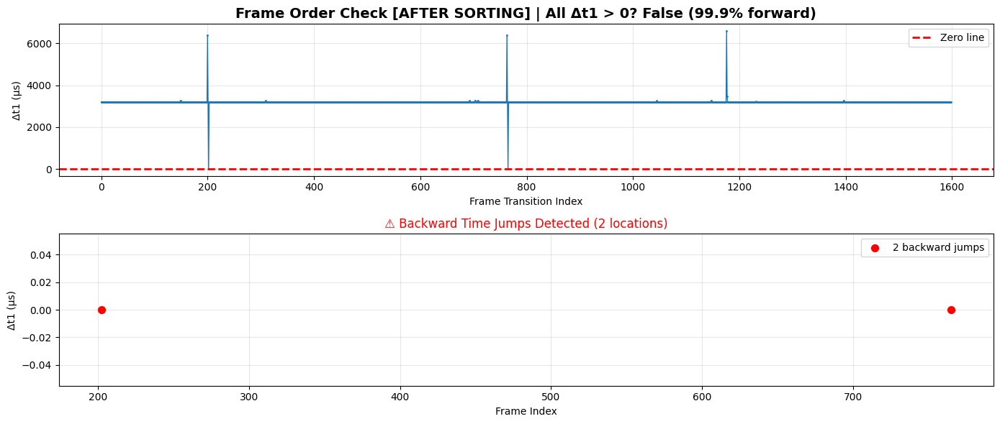

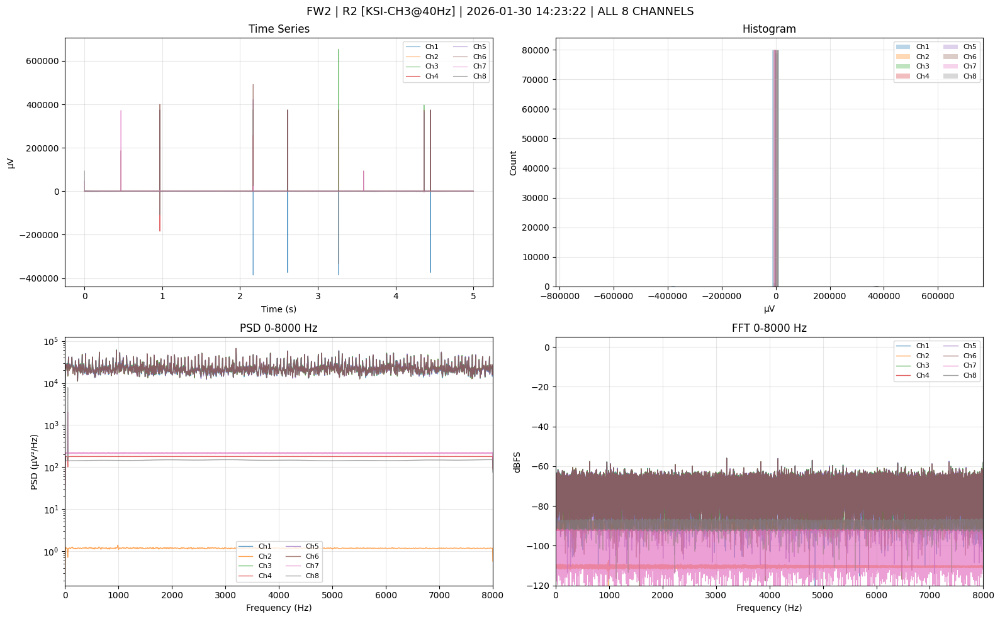

...

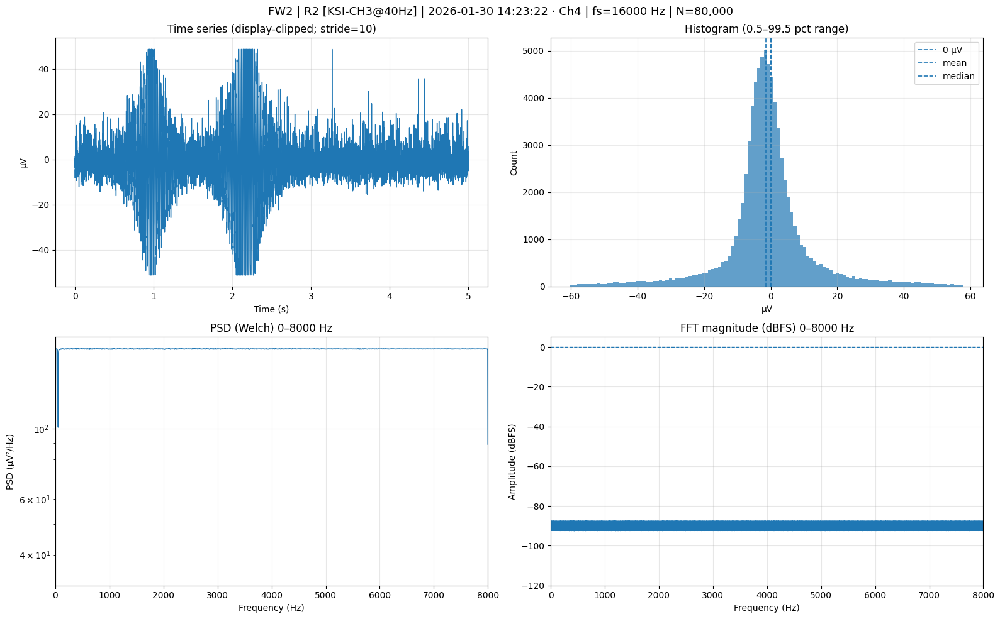

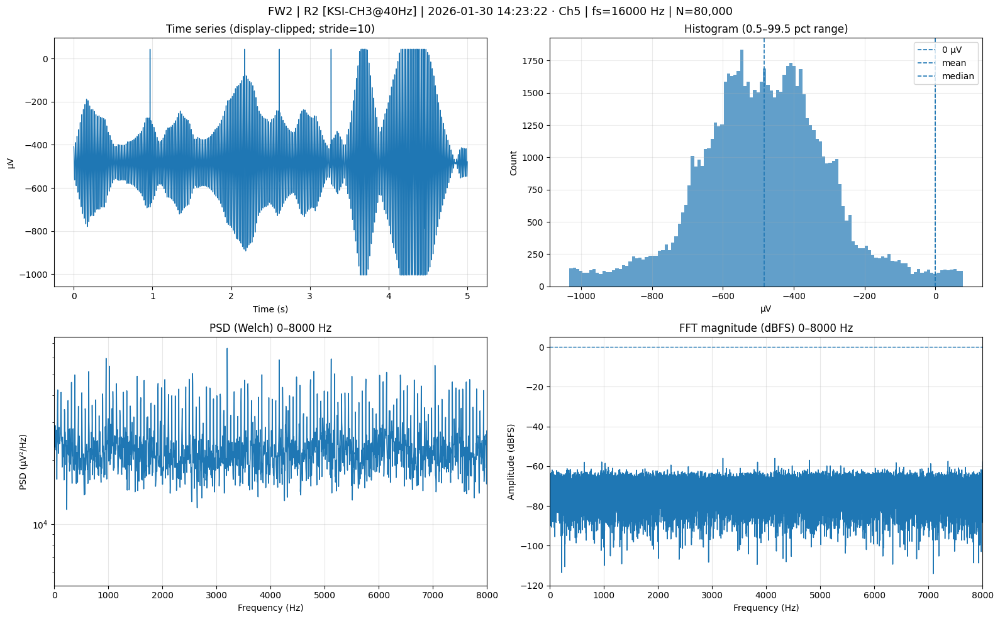

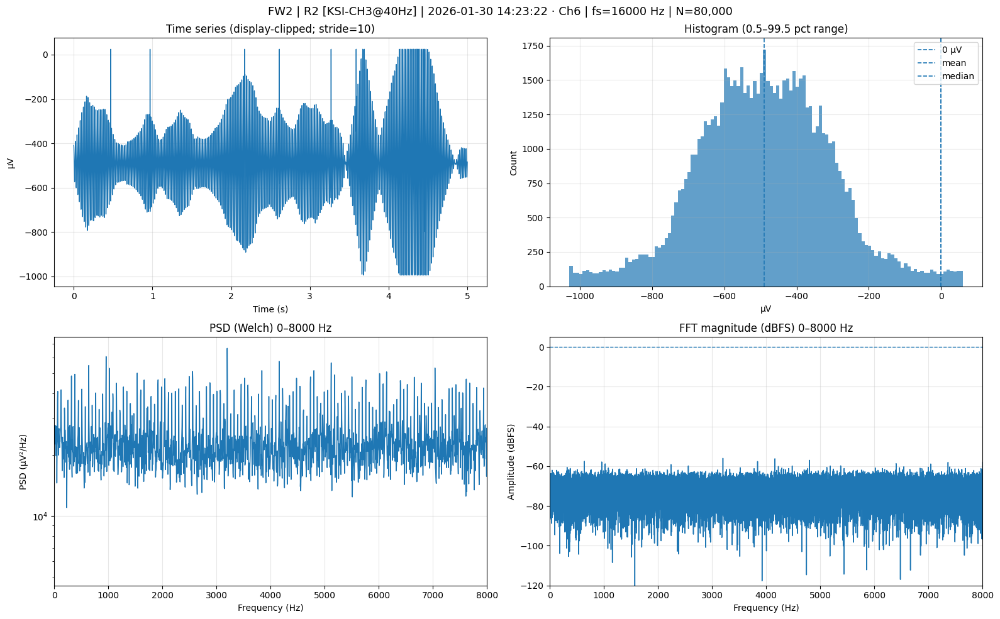

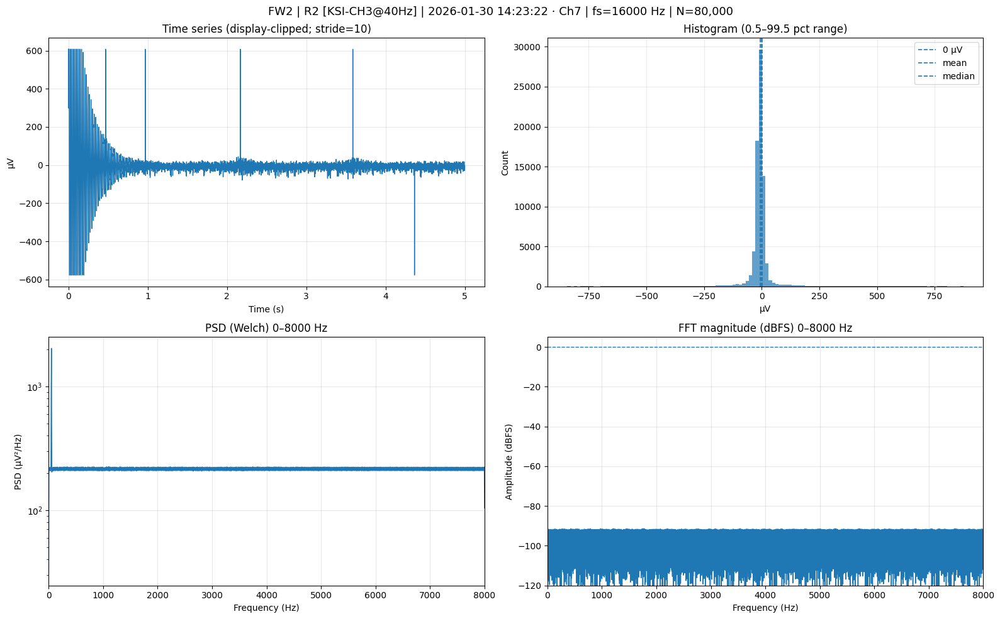

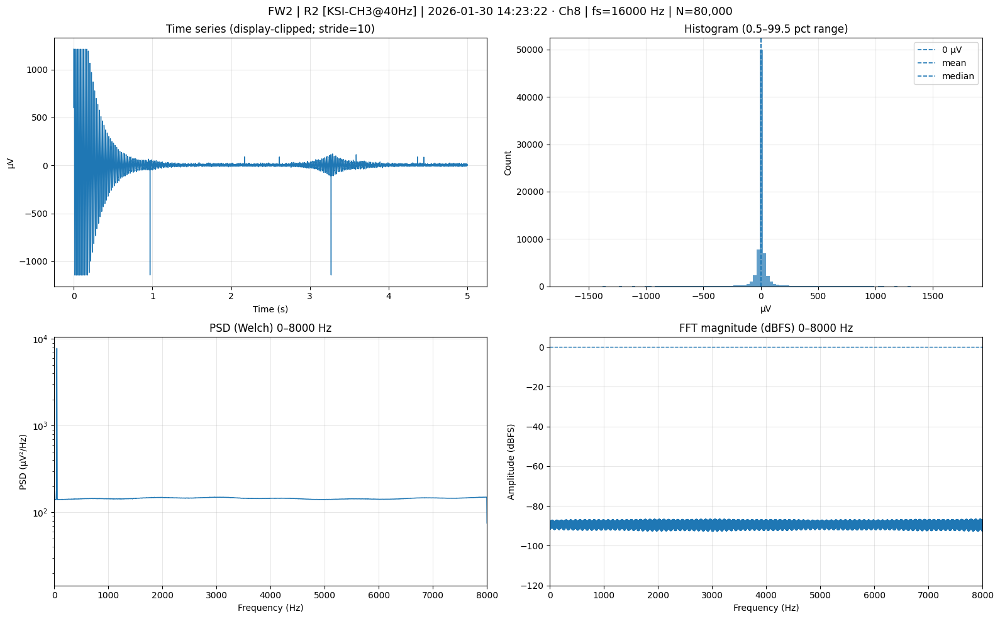


✓ Exporting PDF: 260130_142322_FW2_R2_KSI_CH3_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B2 KSI CH3 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2139206094, 2139209297, 2139212494, ..., 2144320654, 2144323854,
          2144327054], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([241, 239, 240, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([161, 161, 161, ...,  81,  81,  81], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 7150,  7200,  7250, ..., 87000, 87050, 87100],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2139206094, 2139209297, 2139212494, ..., 2144320654, 2144323854,
          2144327054], shape=(1600,))},
  'header_first': {'t1

In [90]:
run_ksi_ch3()


=================== B3: KNOWN SIGNAL INJECTION - CH4 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142403_FW2_R2_KSI_CH4_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:24:03
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

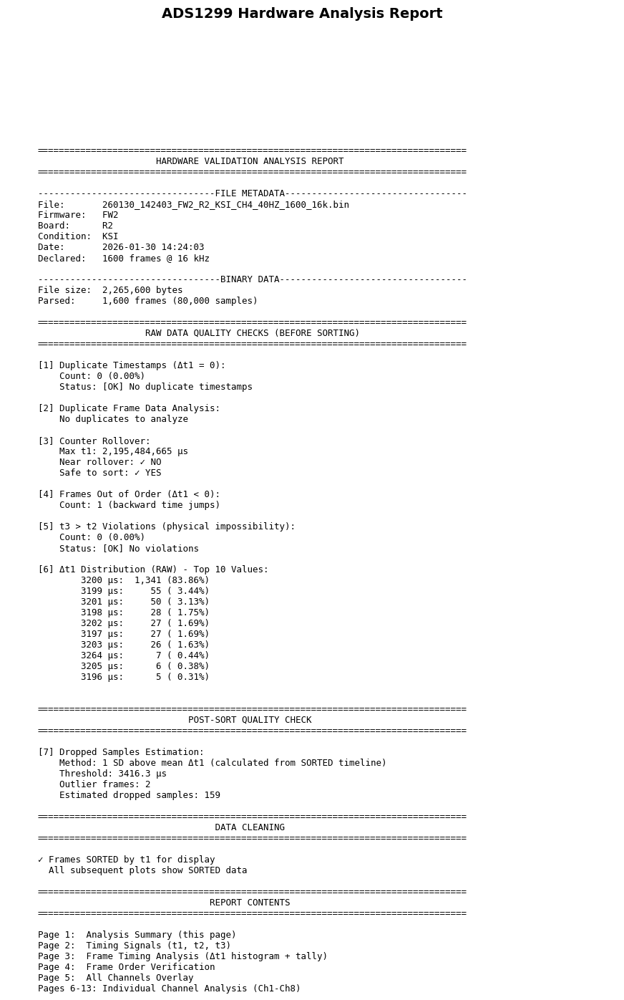

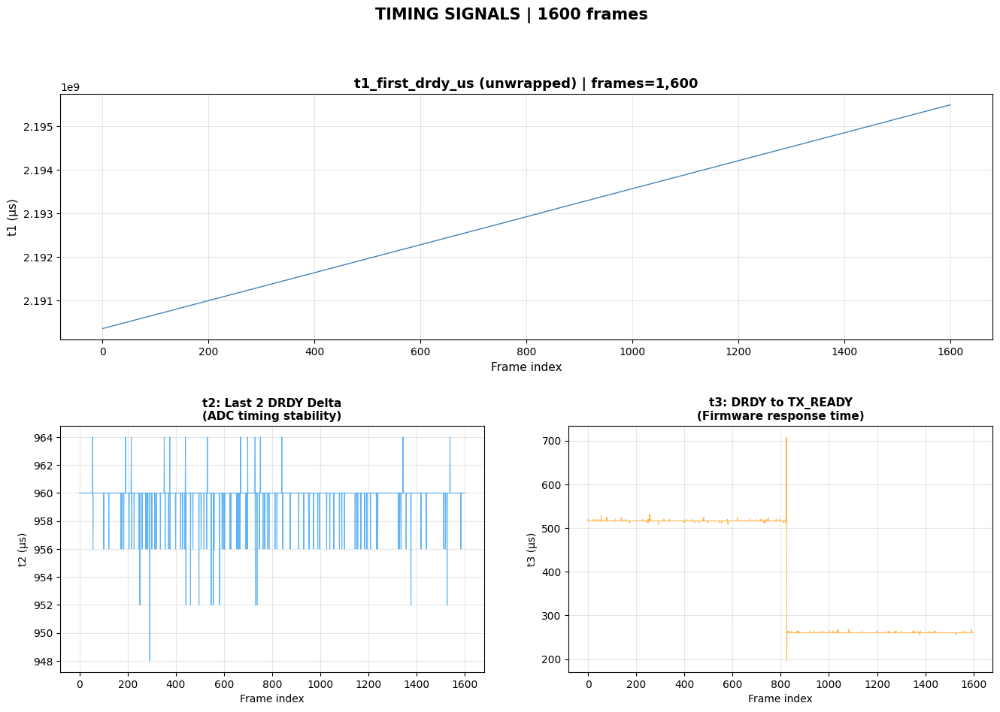

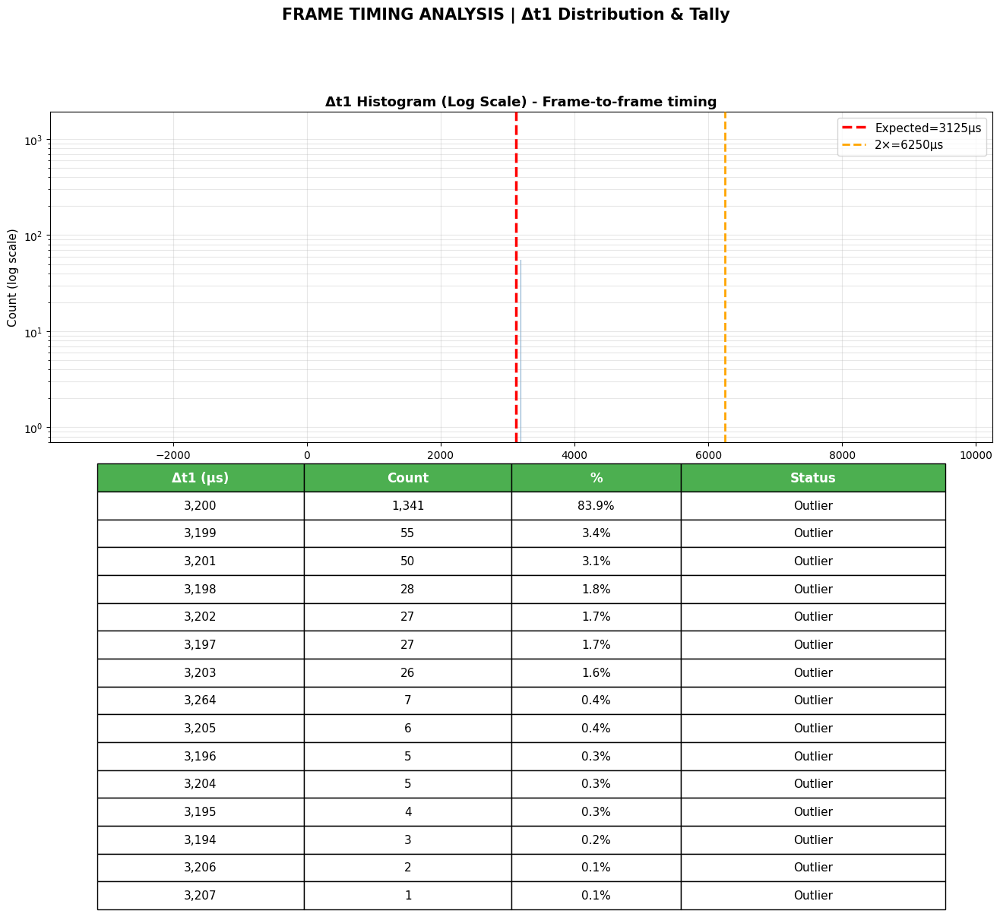

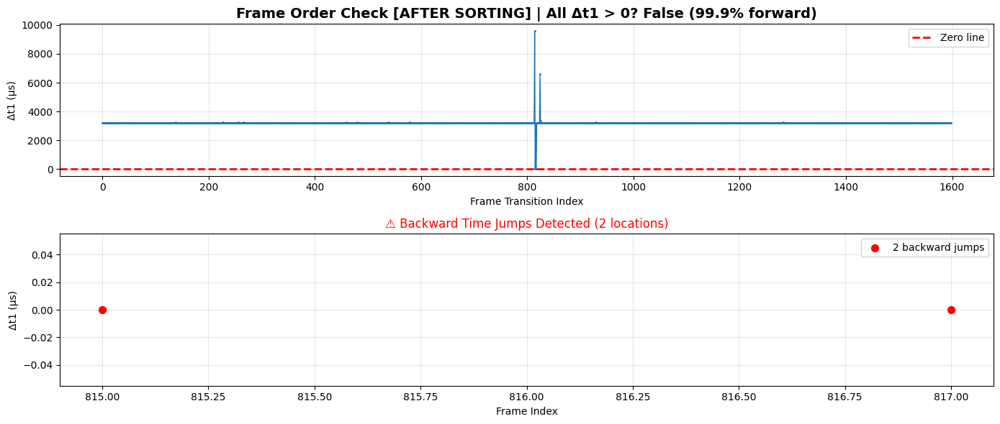

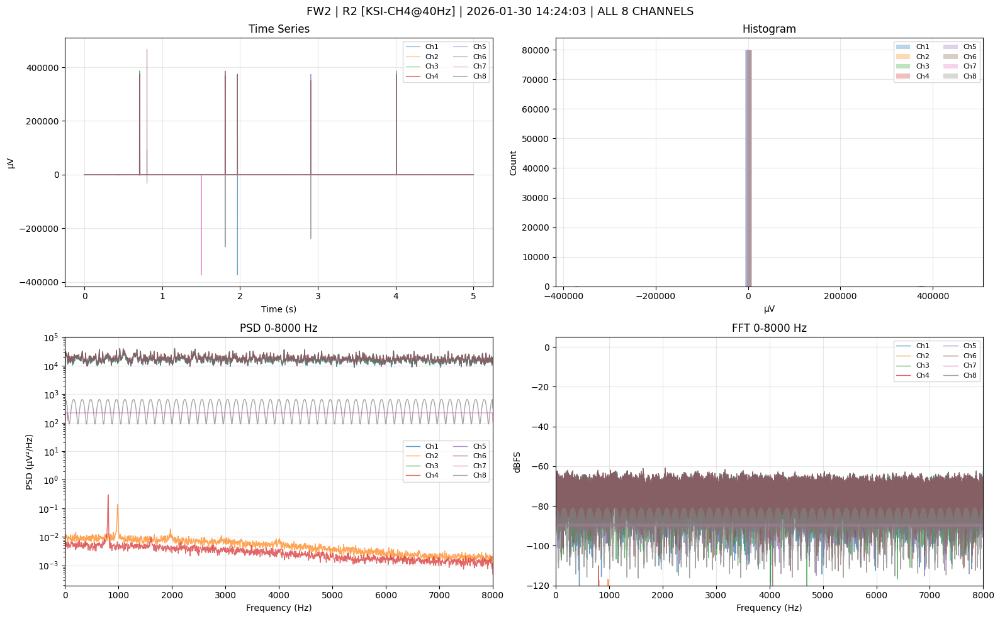

...

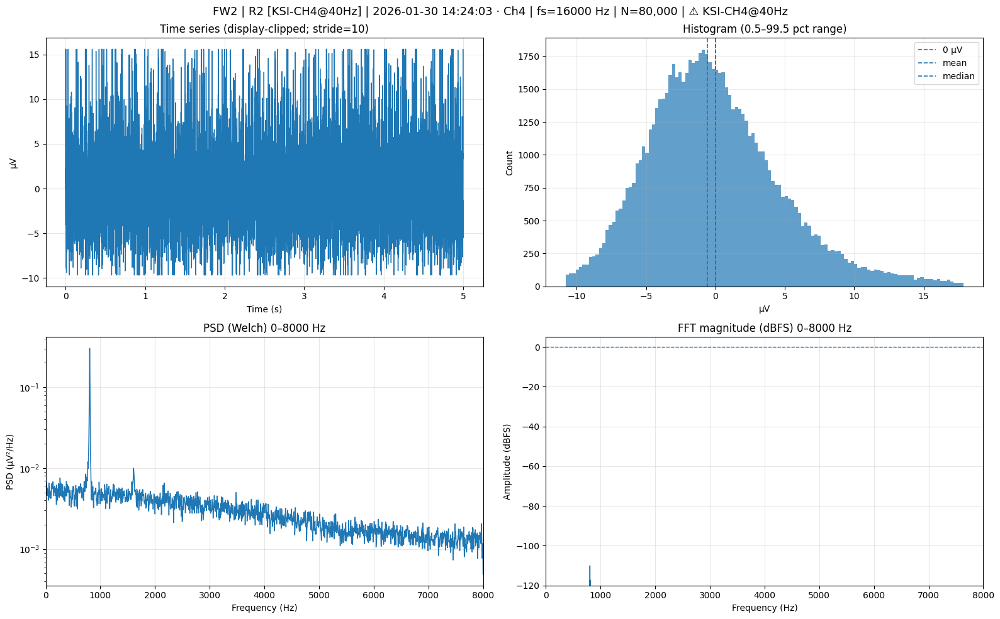

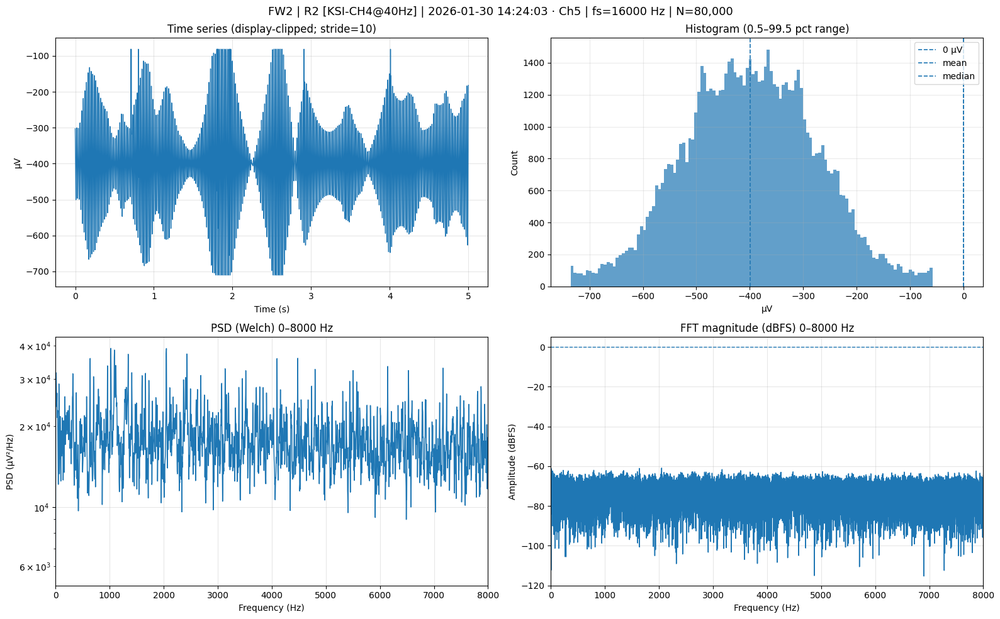

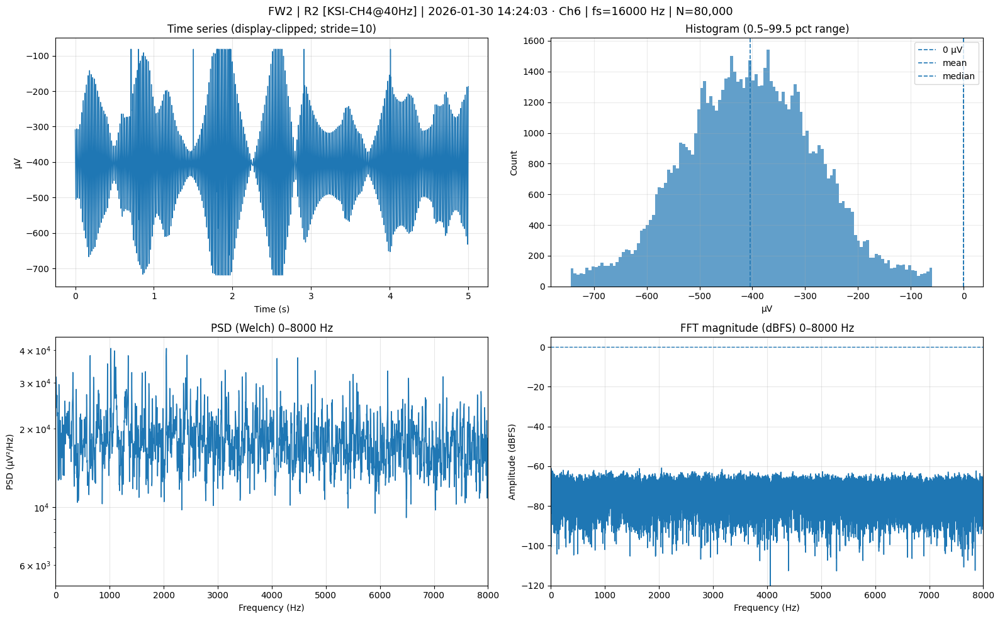

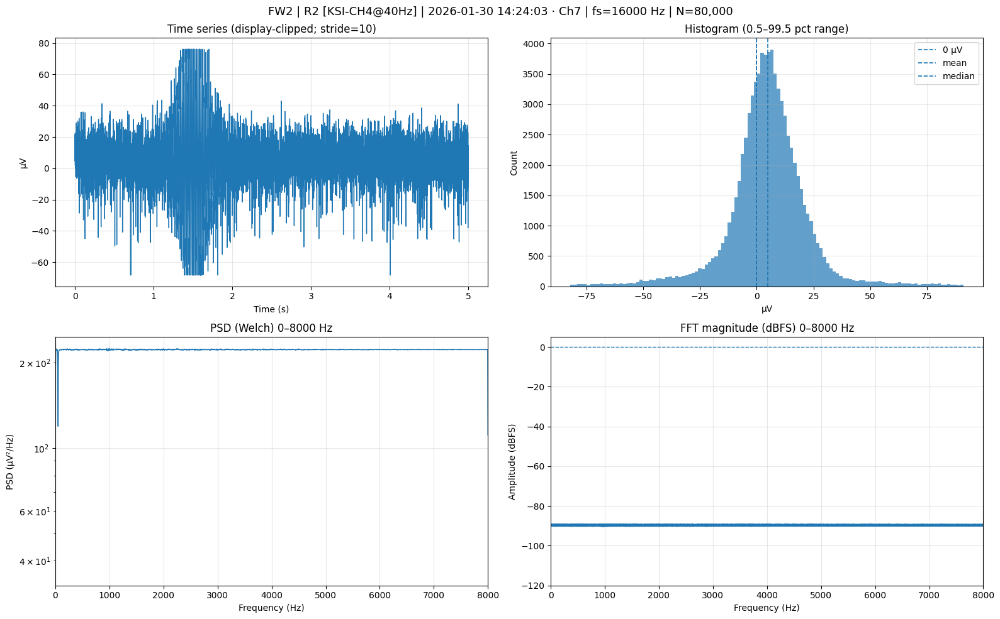

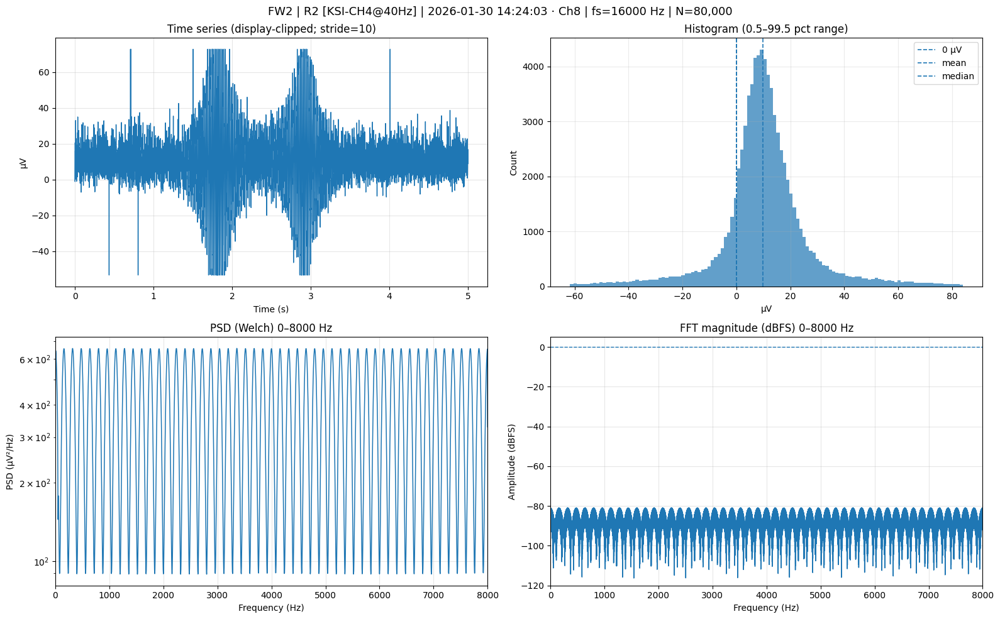


✓ Exporting PDF: 260130_142403_FW2_R2_KSI_CH4_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B3 KSI CH4 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2190363705, 2190366905, 2190370105, ..., 2195478265, 2195481465,
          2195484665], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([129, 130, 129, ...,  65,  65,  65], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 6450,  6500,  6550, ..., 86300, 86350, 86400],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2190363705, 2190366905, 2190370105, ..., 2195478265, 2195481465,
          2195484665], shape=(1600,))},
  'header_first': {'t1

In [91]:
run_ksi_ch4()


=================== B4: KNOWN SIGNAL INJECTION - CH5 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142502_FW2_R2_KSI_CH5_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:25:02
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

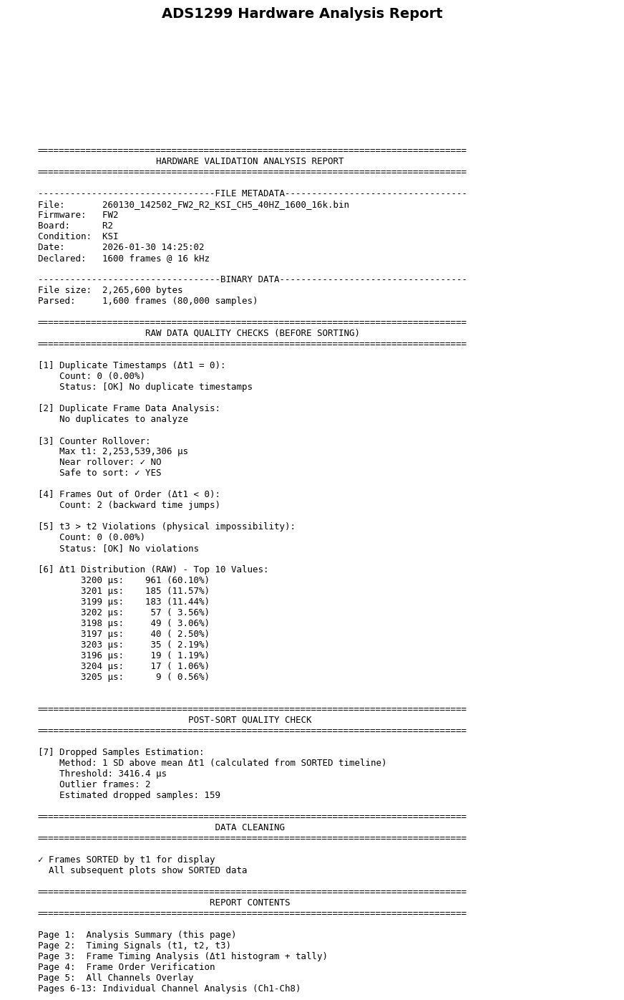

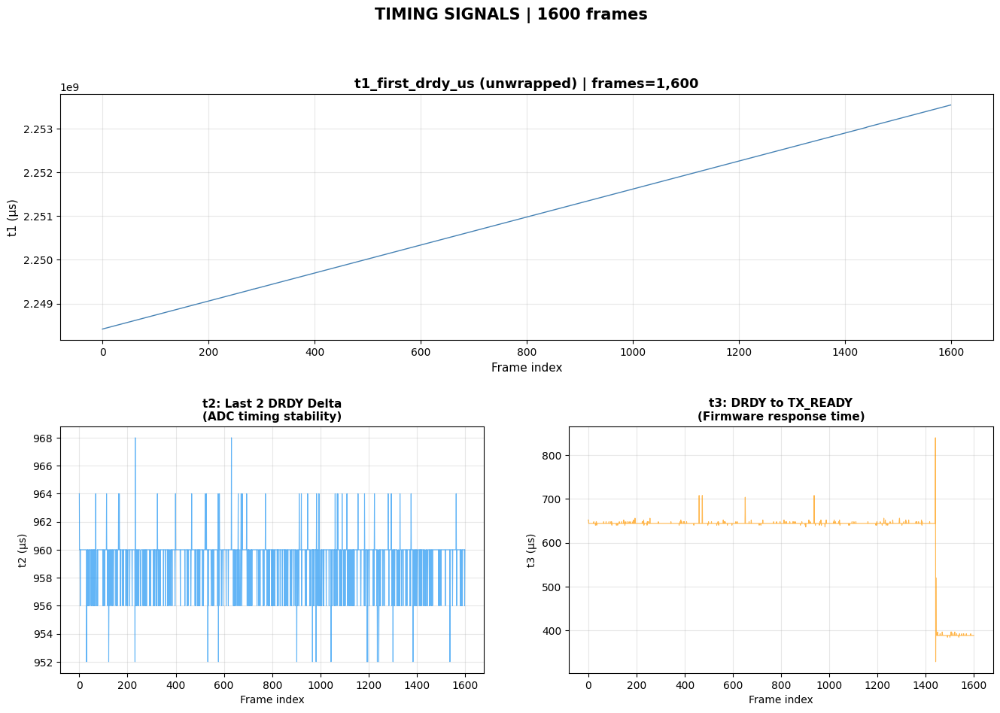

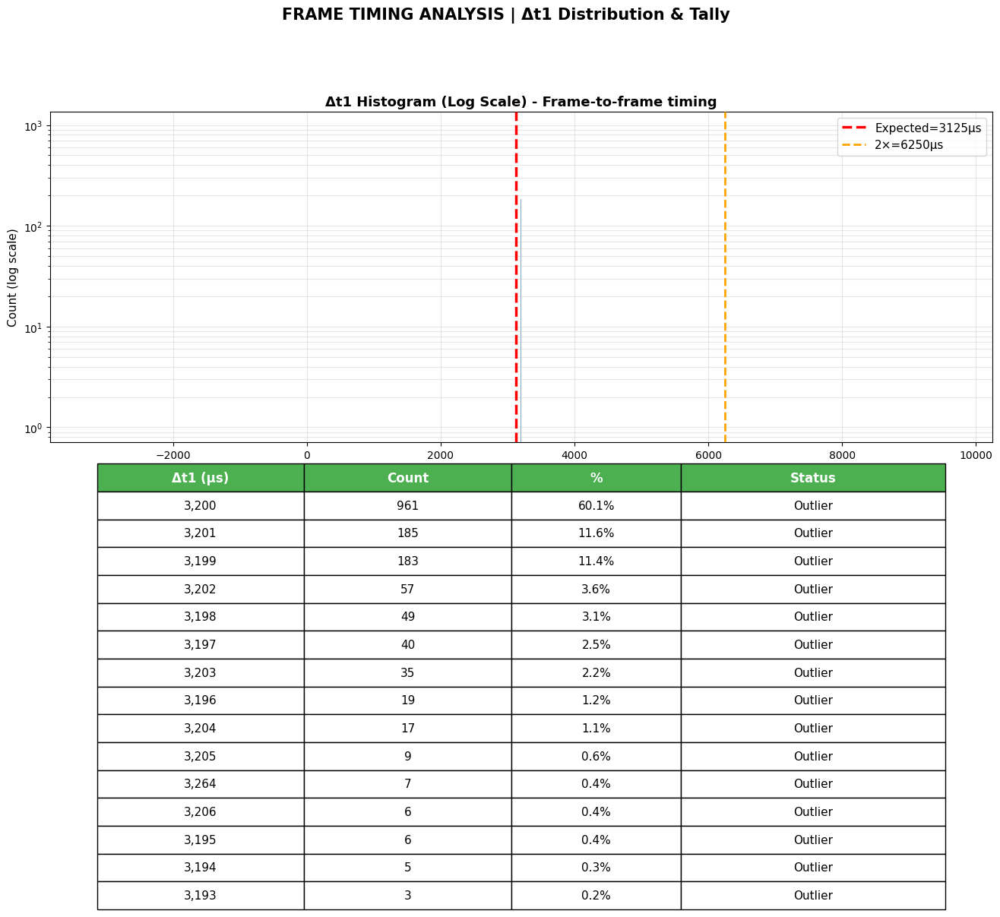

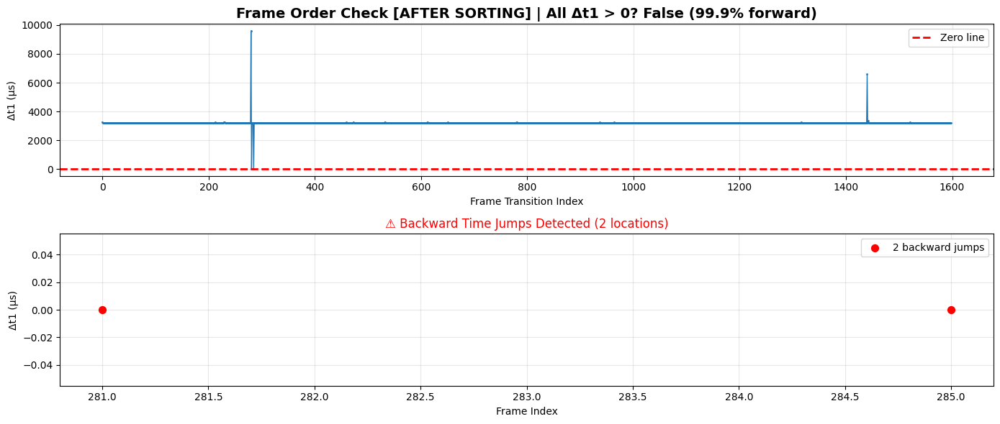

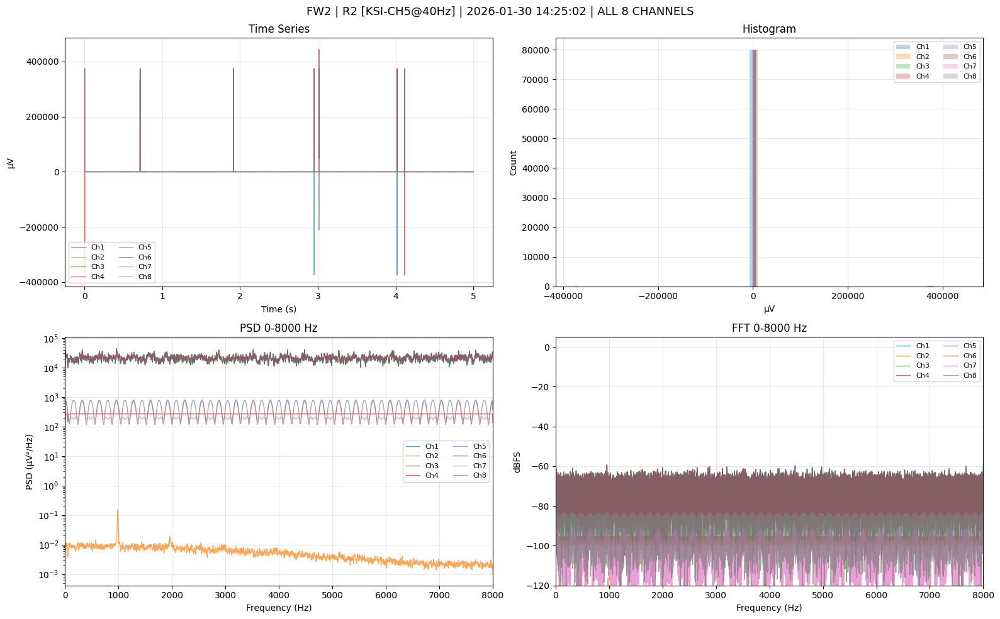

...

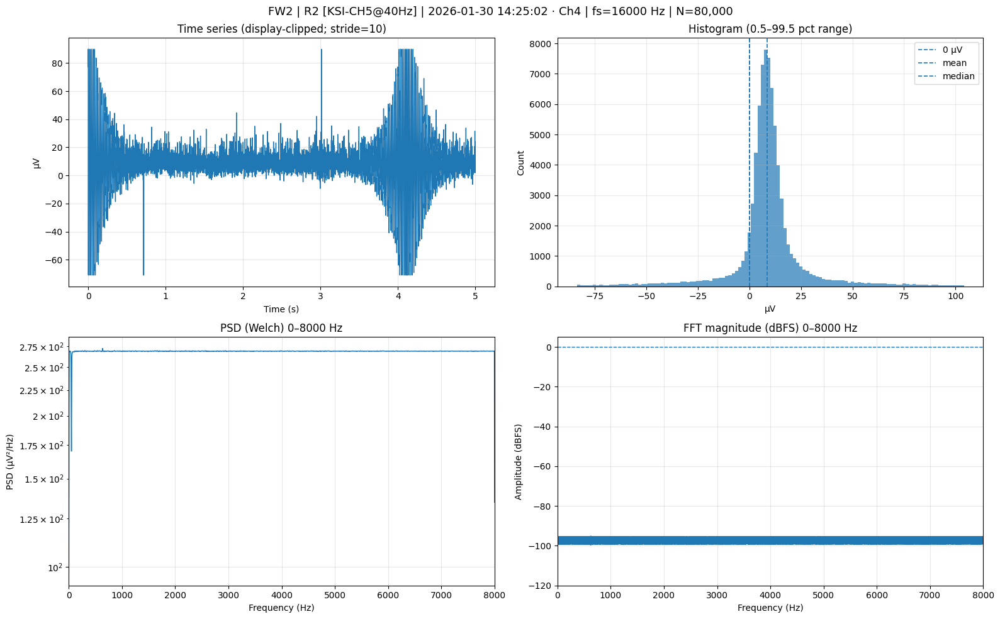

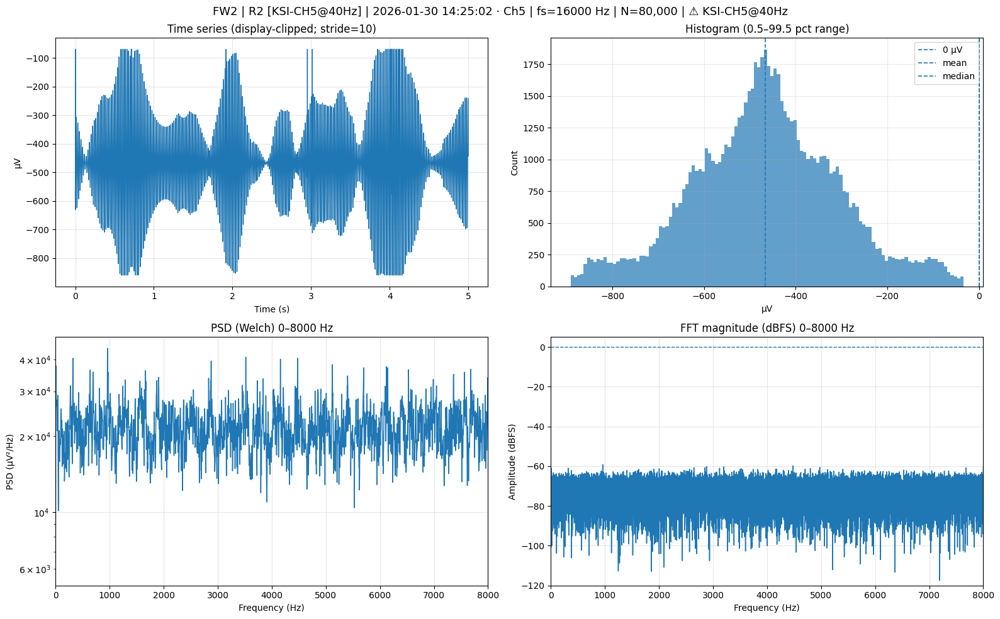

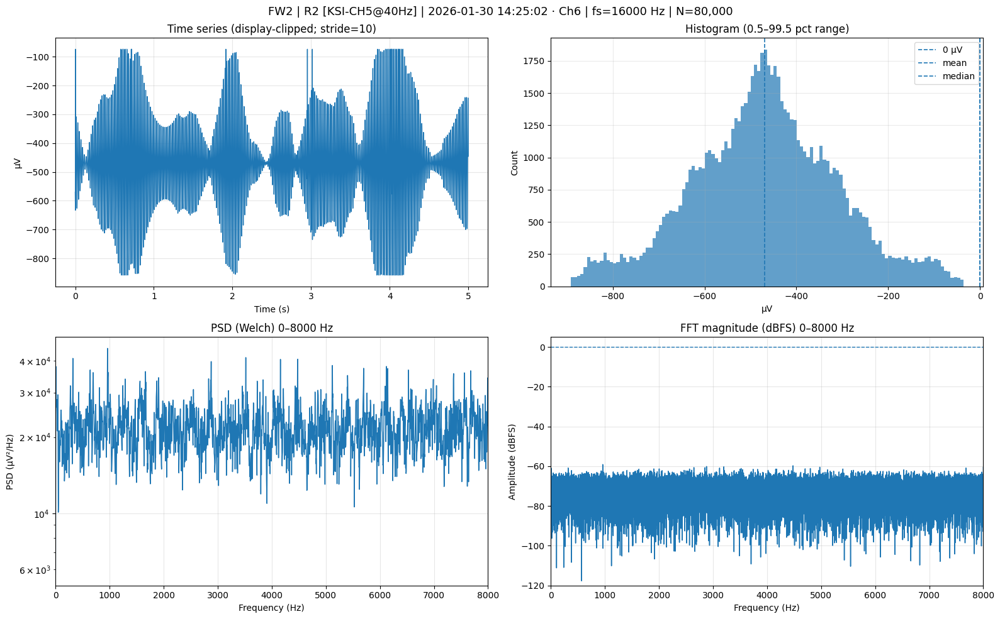

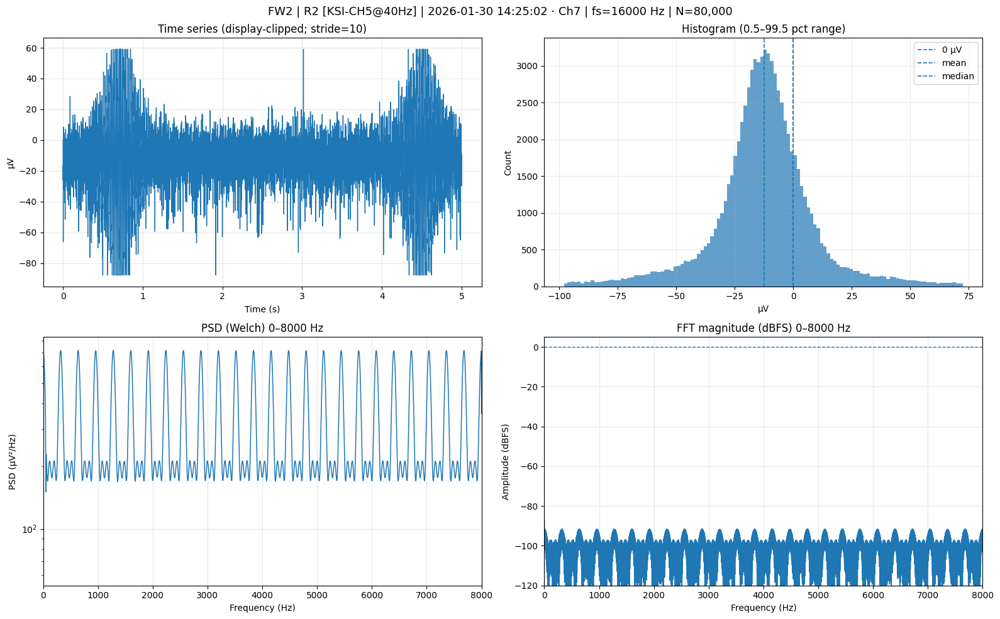

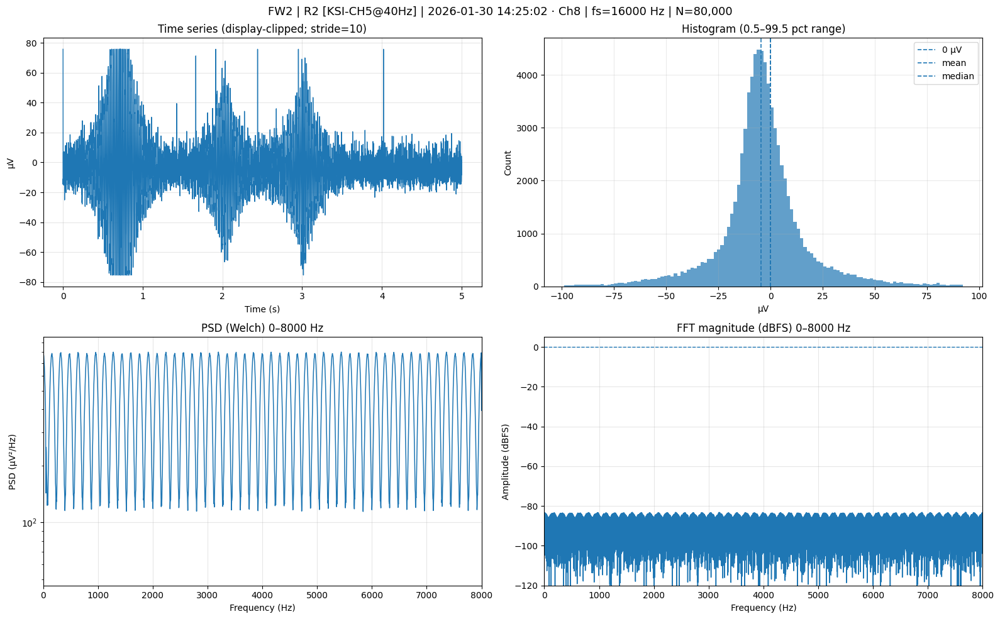


✓ Exporting PDF: 260130_142502_FW2_R2_KSI_CH5_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B4 KSI CH5 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2248418090, 2248421355, 2248424554, ..., 2253532906, 2253536110,
          2253539306], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([241, 240, 240, ..., 240, 239, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([163, 163, 161, ...,  97,  97,  97], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([10100, 10150, 10200, ..., 89950, 90000, 90050],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2248418090, 2248421355, 2248424554, ..., 2253532906, 2253536110,
          2253539306], shape=(1600,))},
  'header_first': {'t1

In [92]:
run_ksi_ch5()


=================== B5: KNOWN SIGNAL INJECTION - CH6 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142541_FW2_R2_KSI_CH6_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:25:41
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

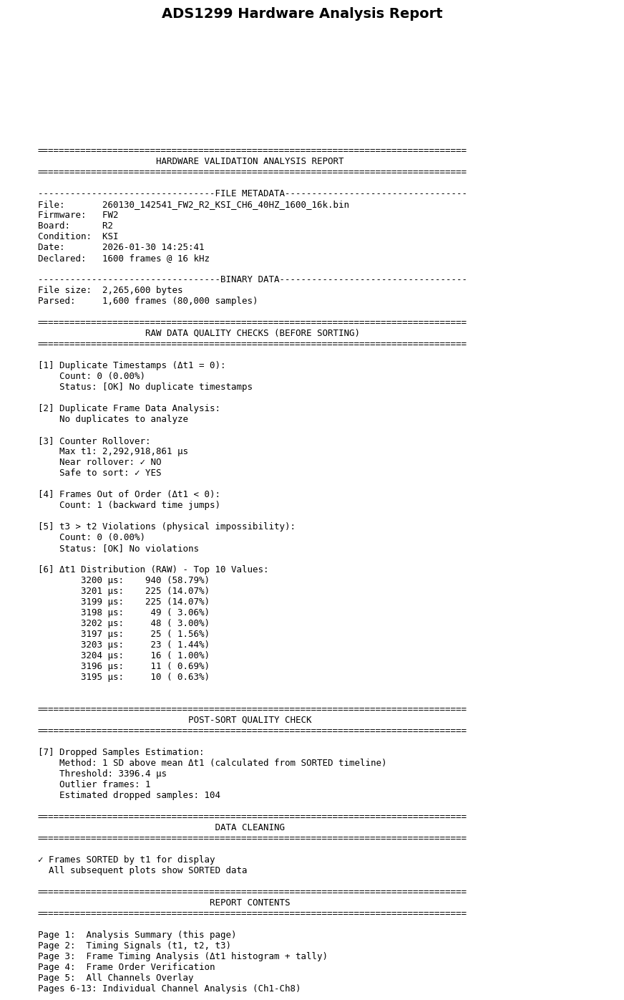

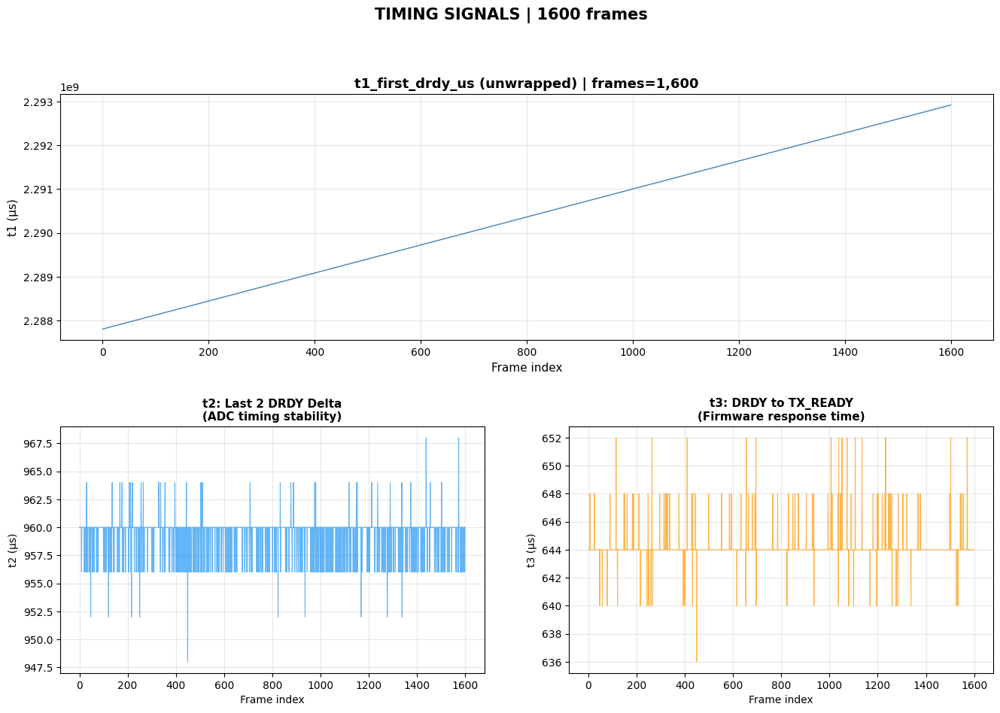

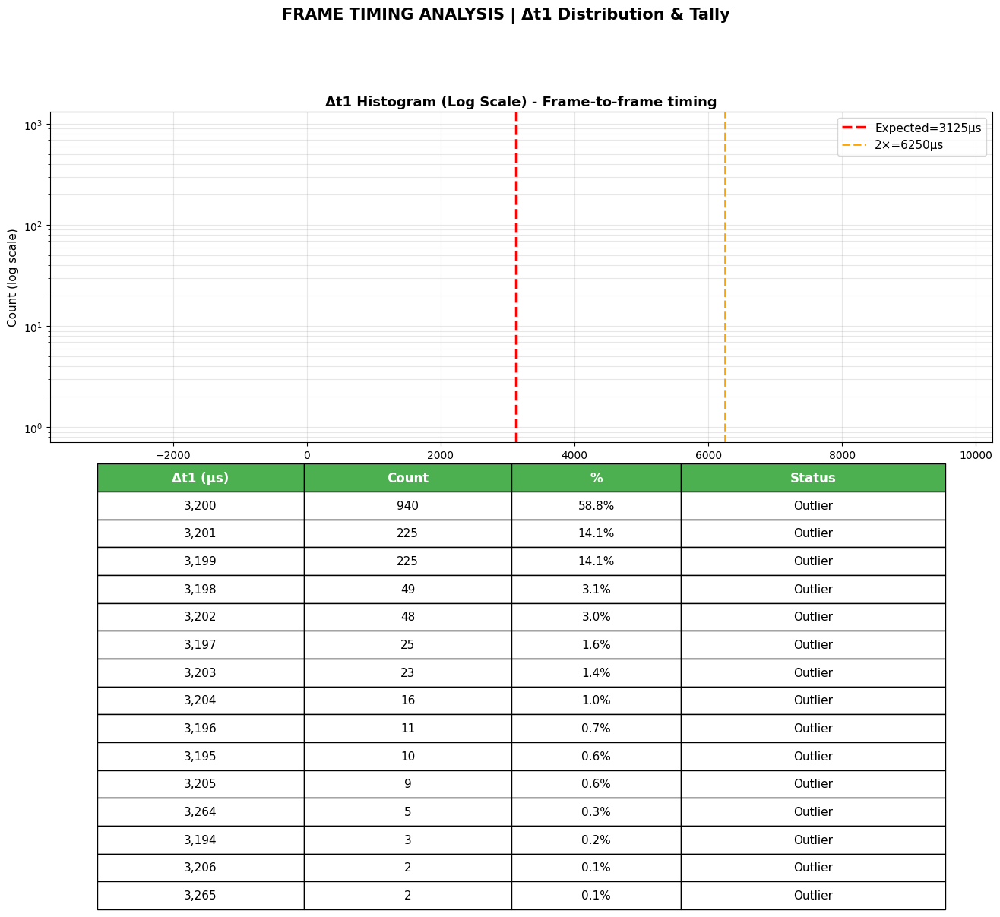

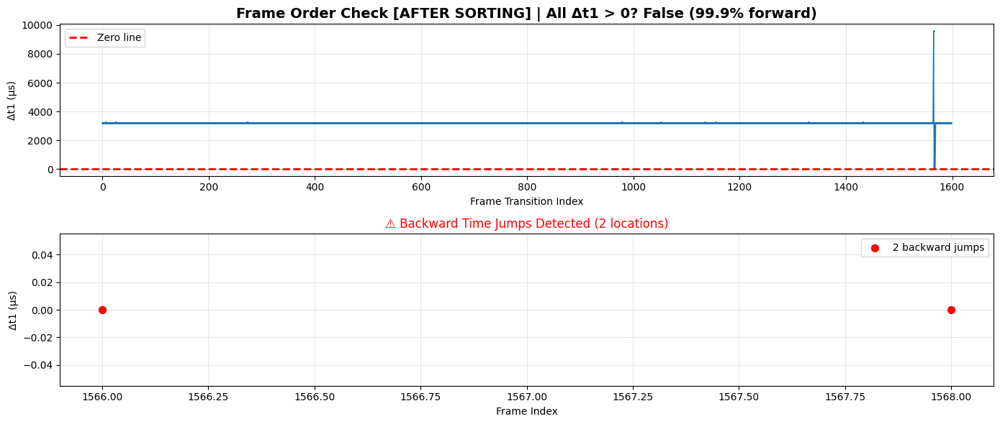

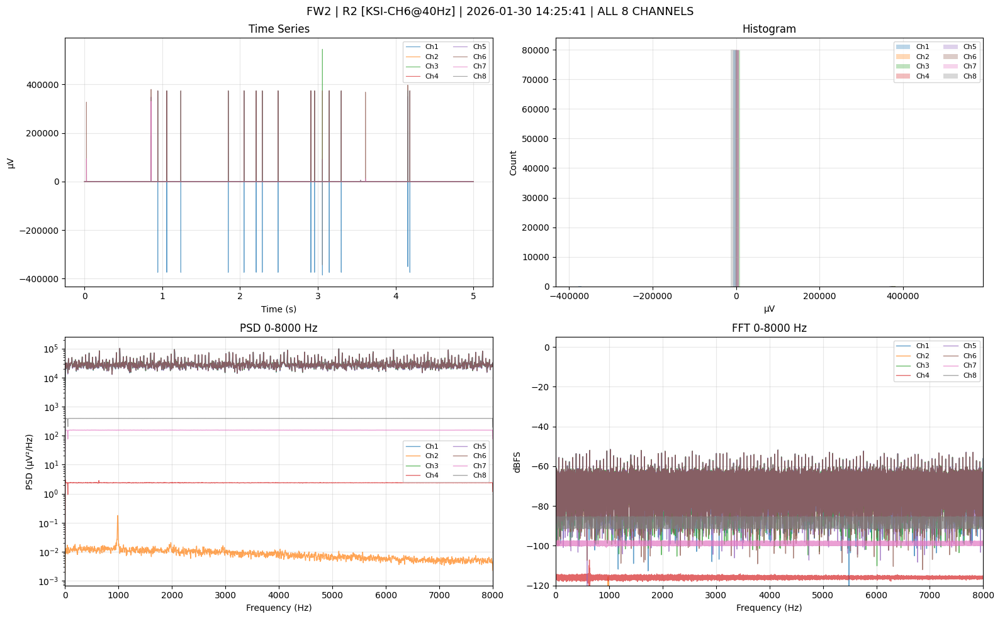

...

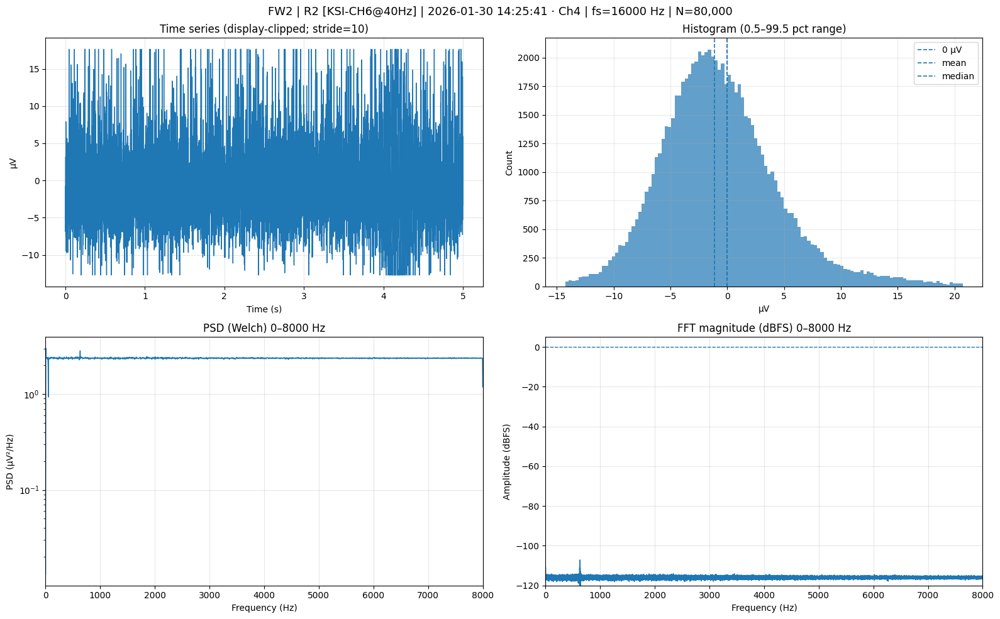

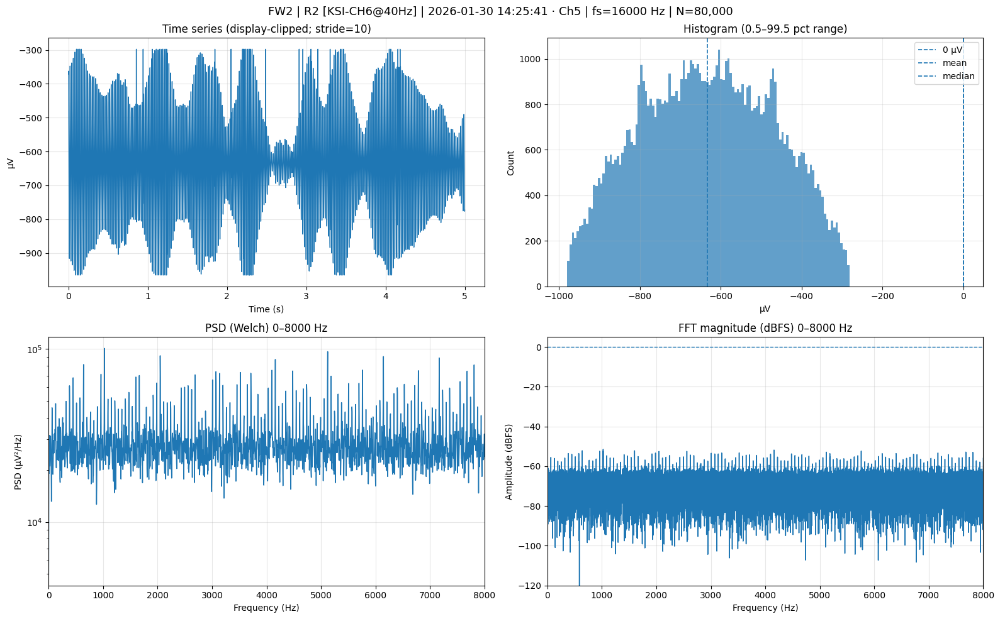

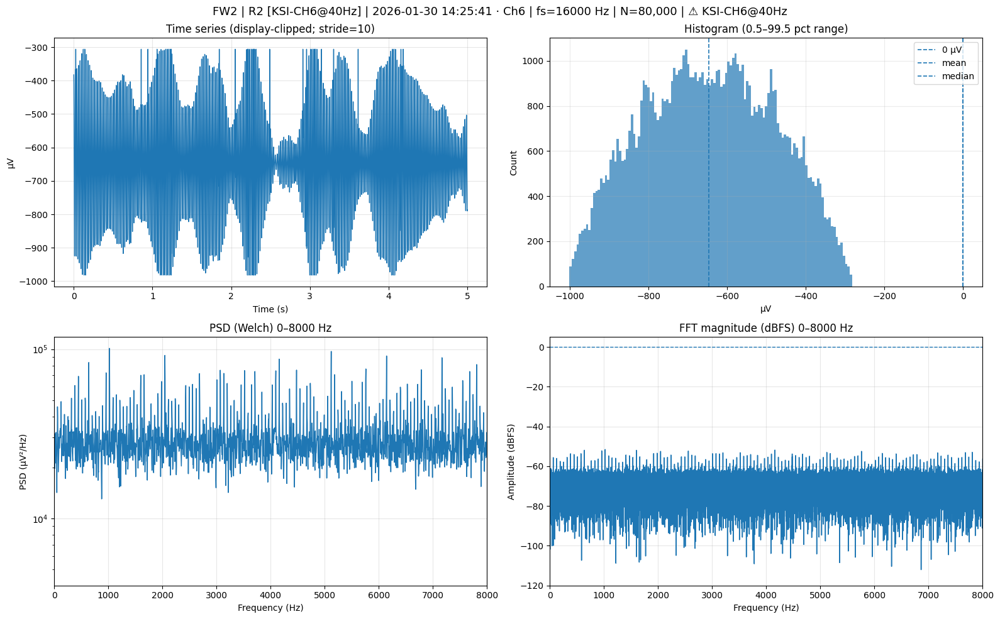

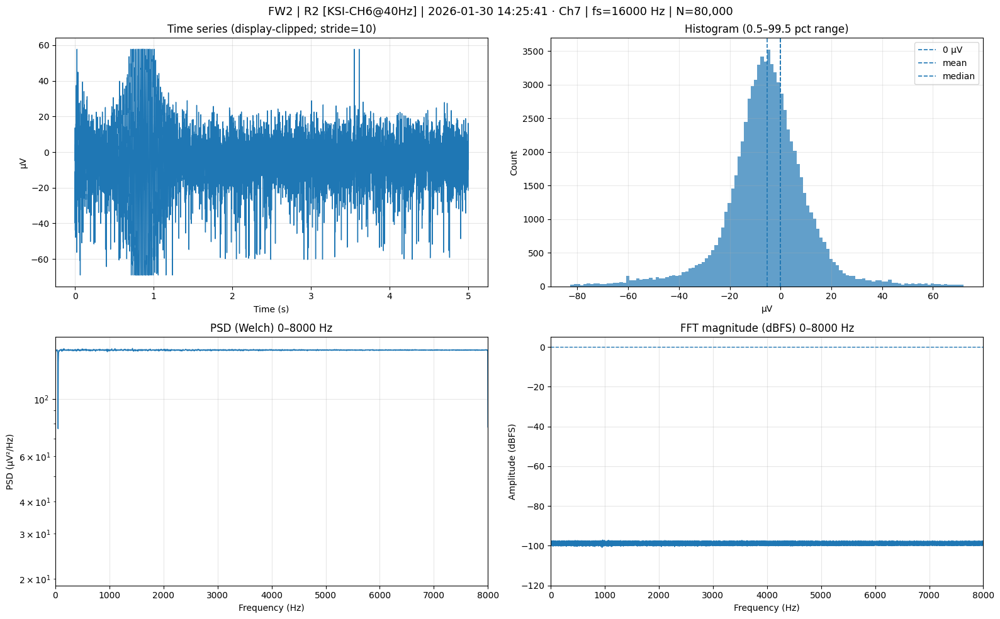

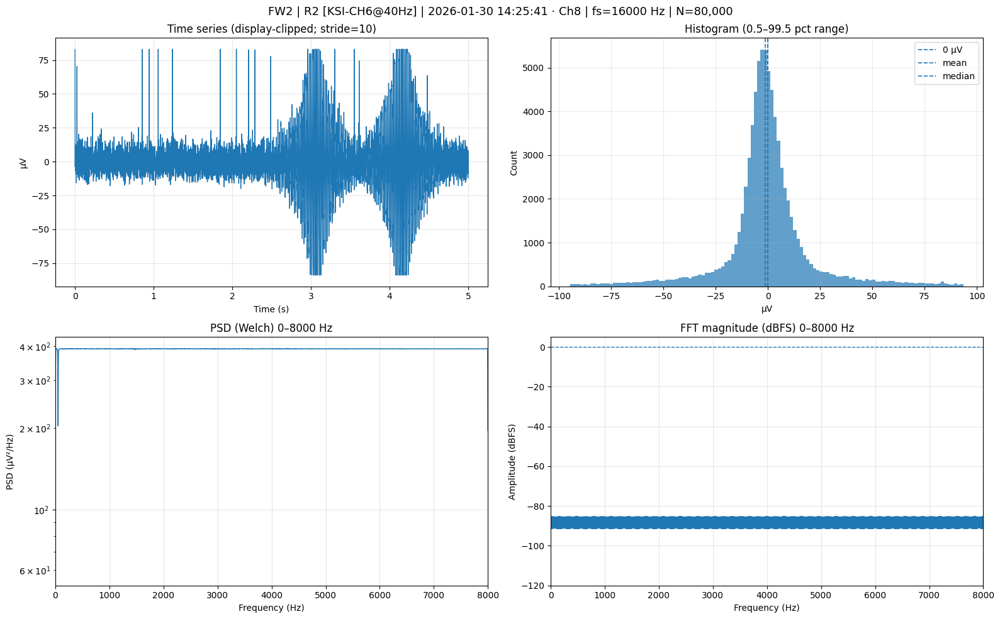


✓ Exporting PDF: 260130_142541_FW2_R2_KSI_CH6_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B5 KSI CH6 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2287801485, 2287804686, 2287807885, ..., 2292912461, 2292915662,
          2292918861], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 240, 239, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([161, 161, 161, ..., 161, 161, 161], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 6900,  6950,  7000, ..., 86750, 86800, 86850],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2287801485, 2287804686, 2287807885, ..., 2292912461, 2292915662,
          2292918861], shape=(1600,))},
  'header_first': {'t1

In [93]:
run_ksi_ch6()


=================== B6: KNOWN SIGNAL INJECTION - CH7 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142622_FW2_R2_KSI_CH7_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:26:22
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

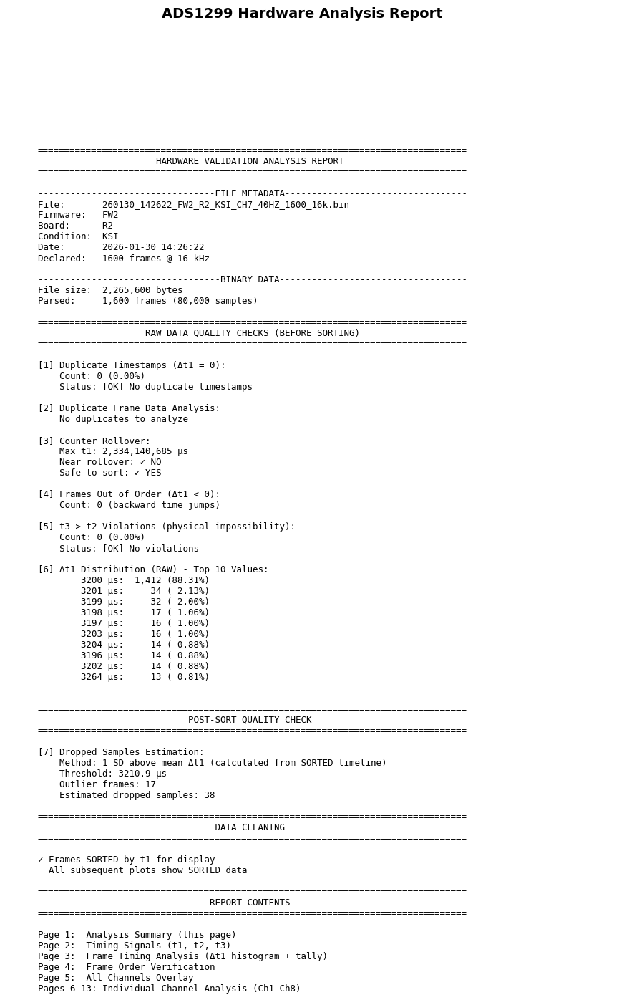

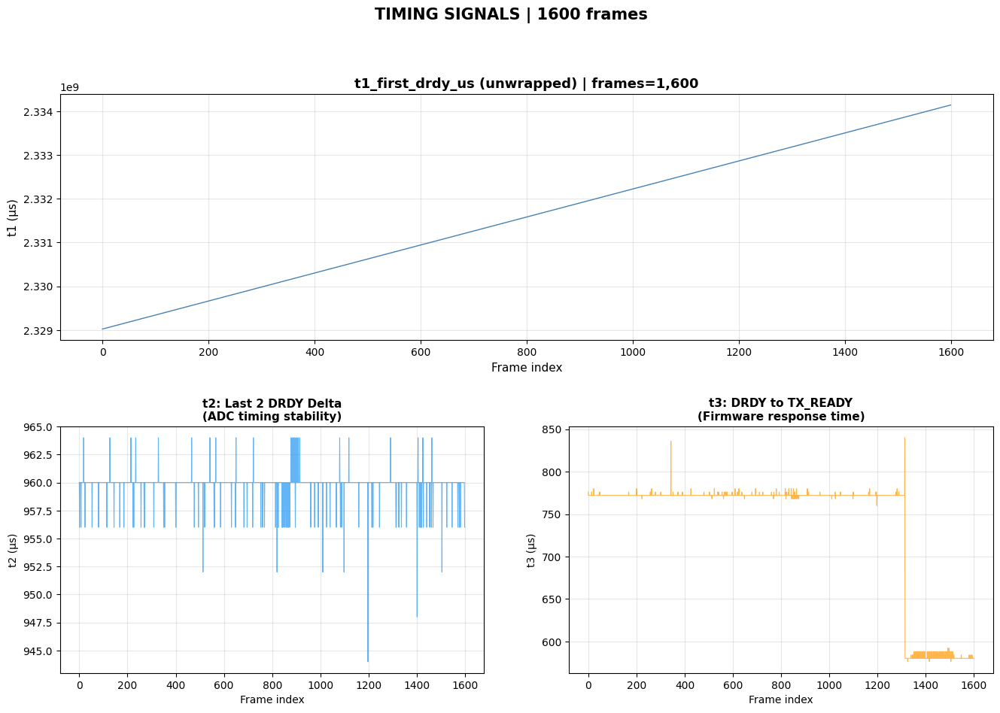

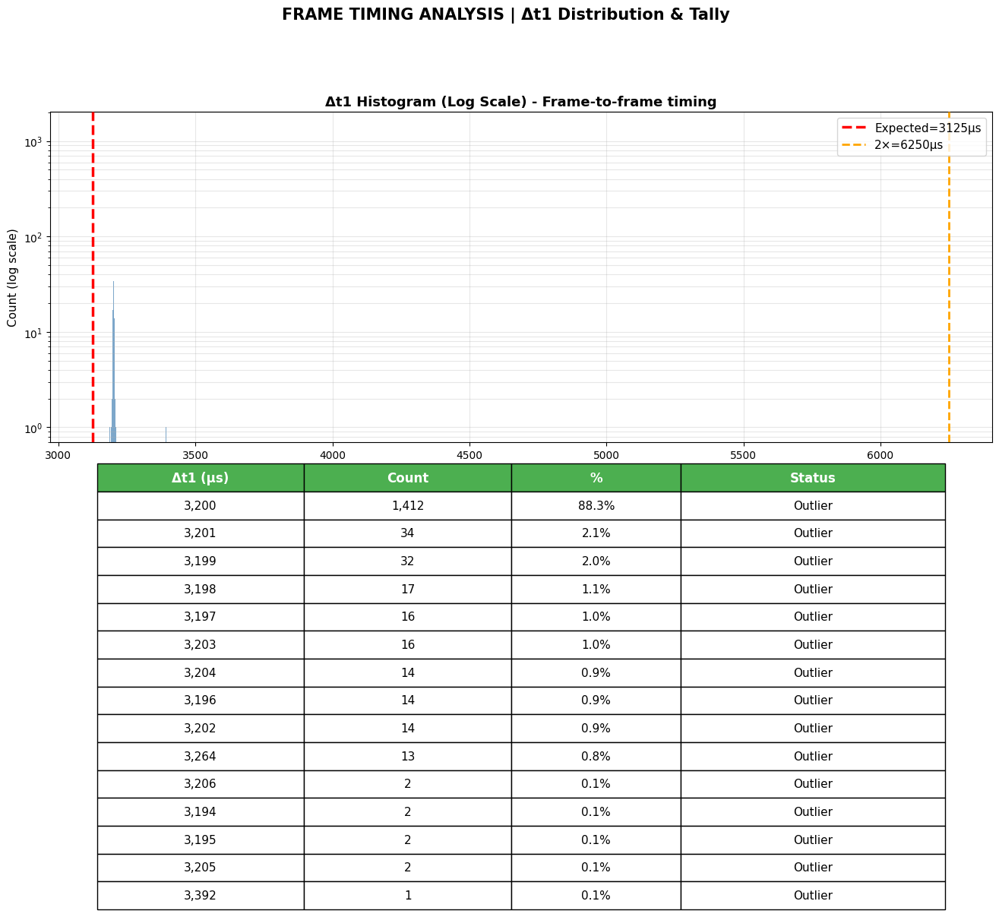

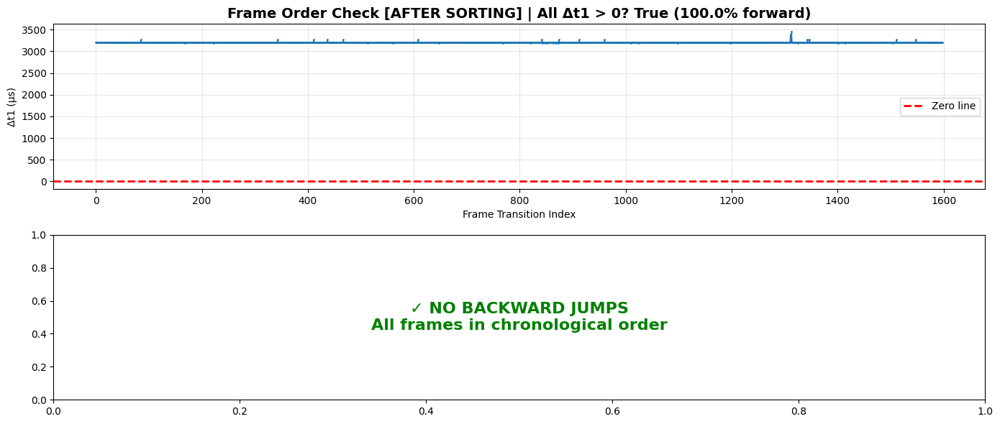

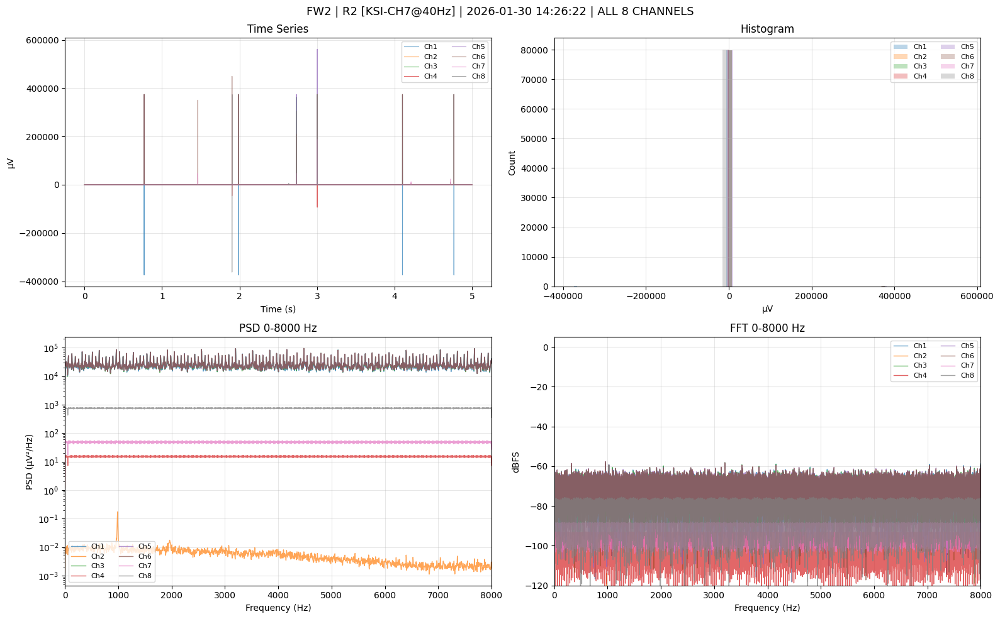

...

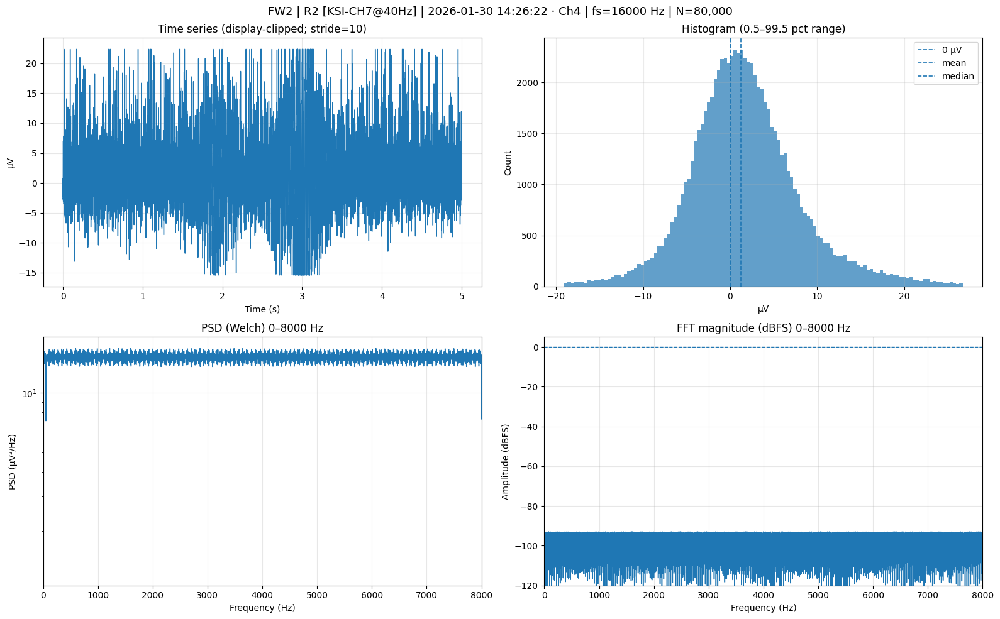

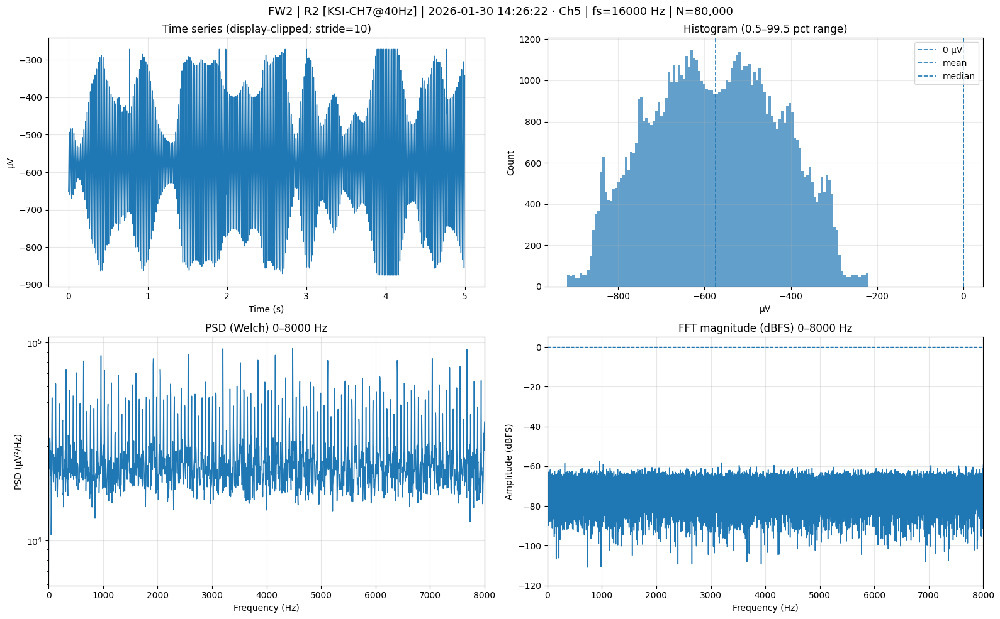

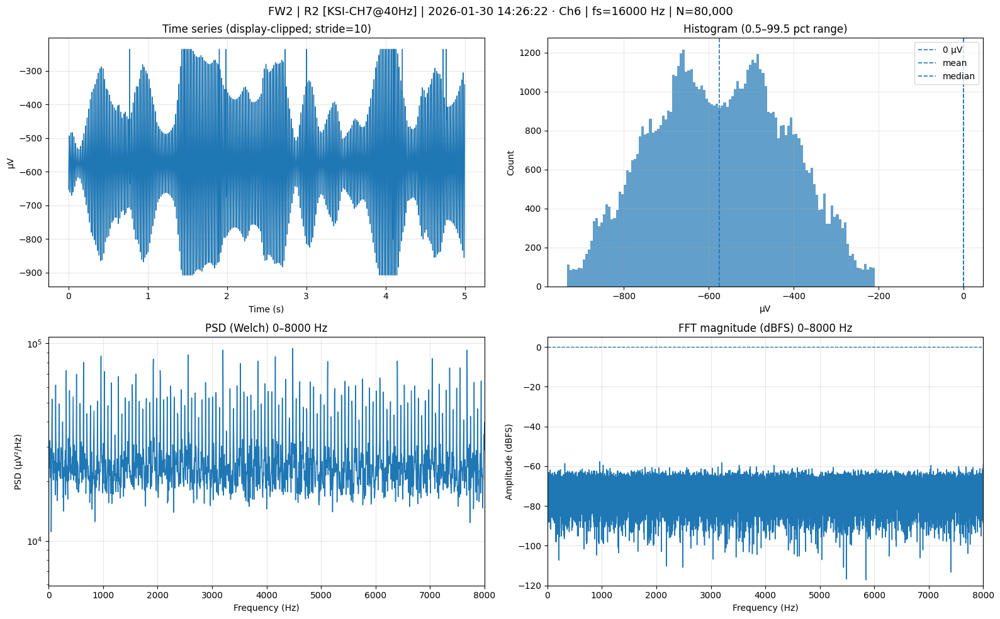

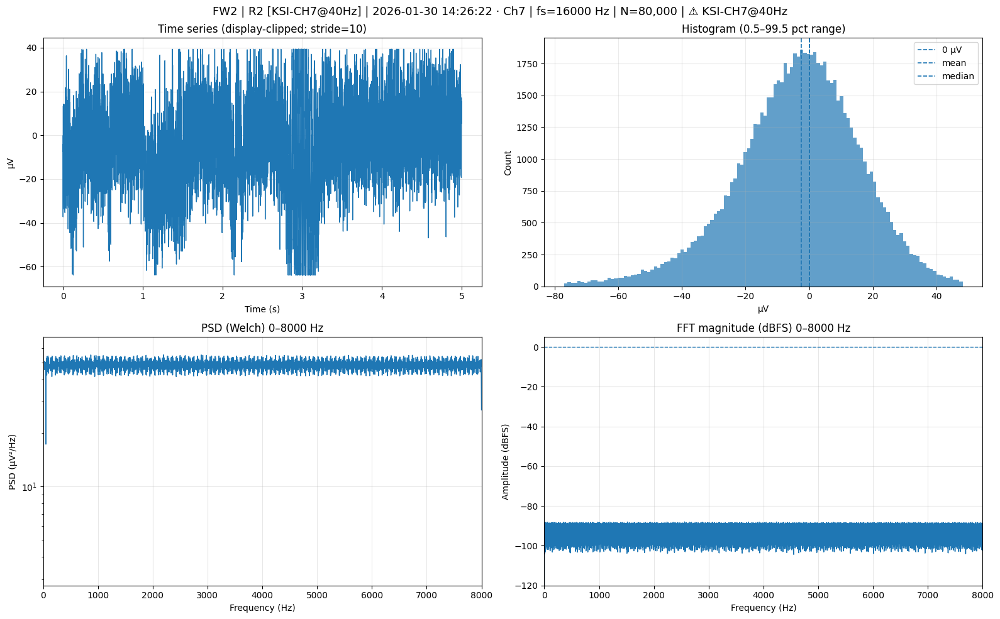

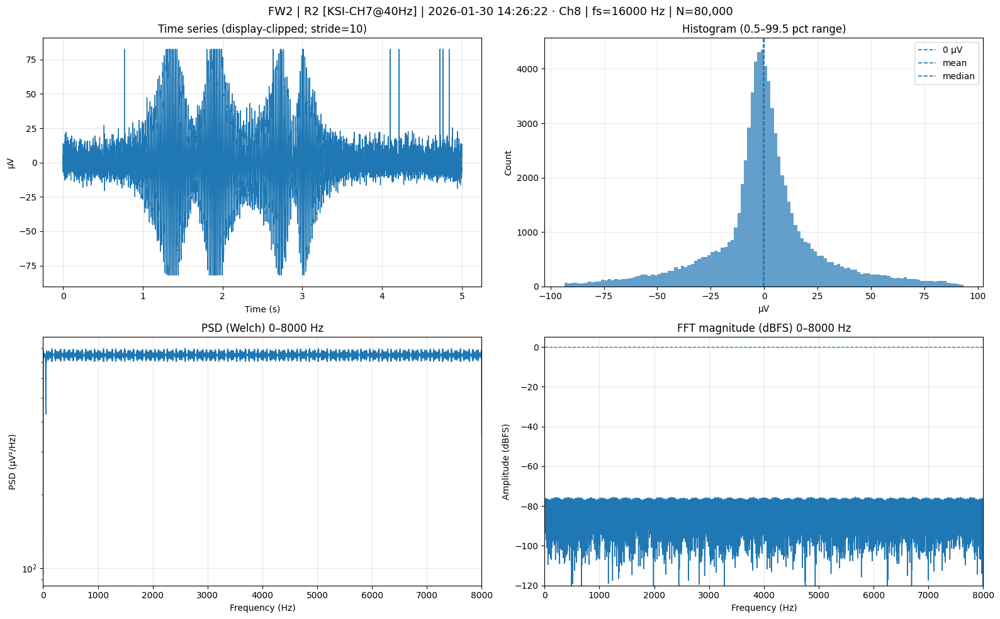


✓ Exporting PDF: 260130_142622_FW2_R2_KSI_CH7_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B6 KSI CH7 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2329022540, 2329025742, 2329028940, ..., 2334134284, 2334137485,
          2334140685], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 239, 240, ..., 240, 239, 239], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([194, 193, 193, ..., 145, 145, 145], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 6500,  6550,  6600, ..., 86350, 86400, 86450],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2329022540, 2329025742, 2329028940, ..., 2334134284, 2334137485,
          2334140685], shape=(1600,))},
  'header_first': {'t1

In [94]:
run_ksi_ch7()


=================== B7: KNOWN SIGNAL INJECTION - CH8 @ 40Hz ====================
================================ FILE METADATA =================================
File:       260130_142722_FW2_R2_KSI_CH8_40HZ_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  KSI
Date:       2026-01-30 14:27:22
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollov

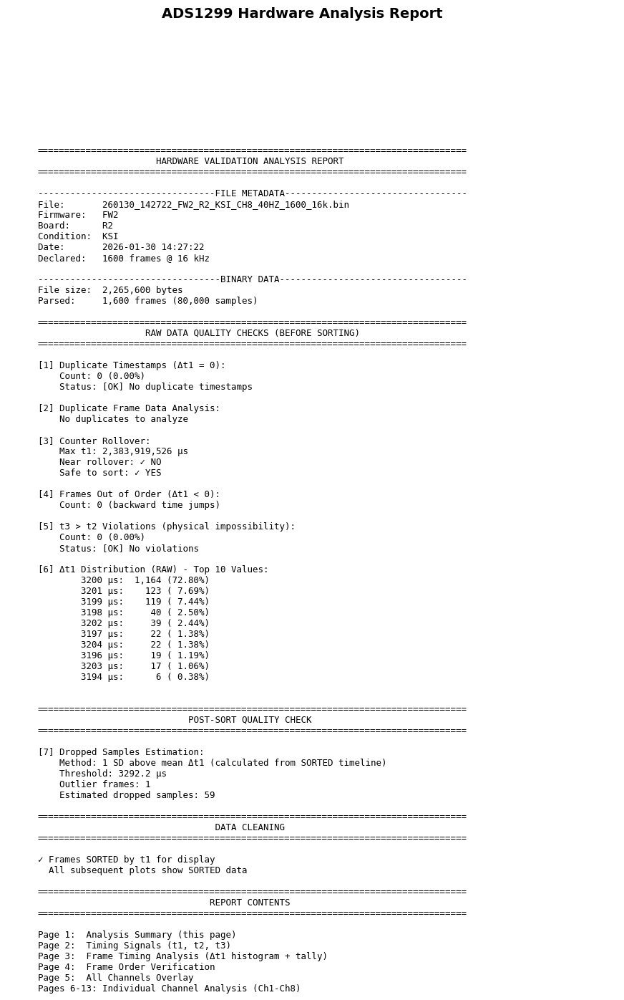

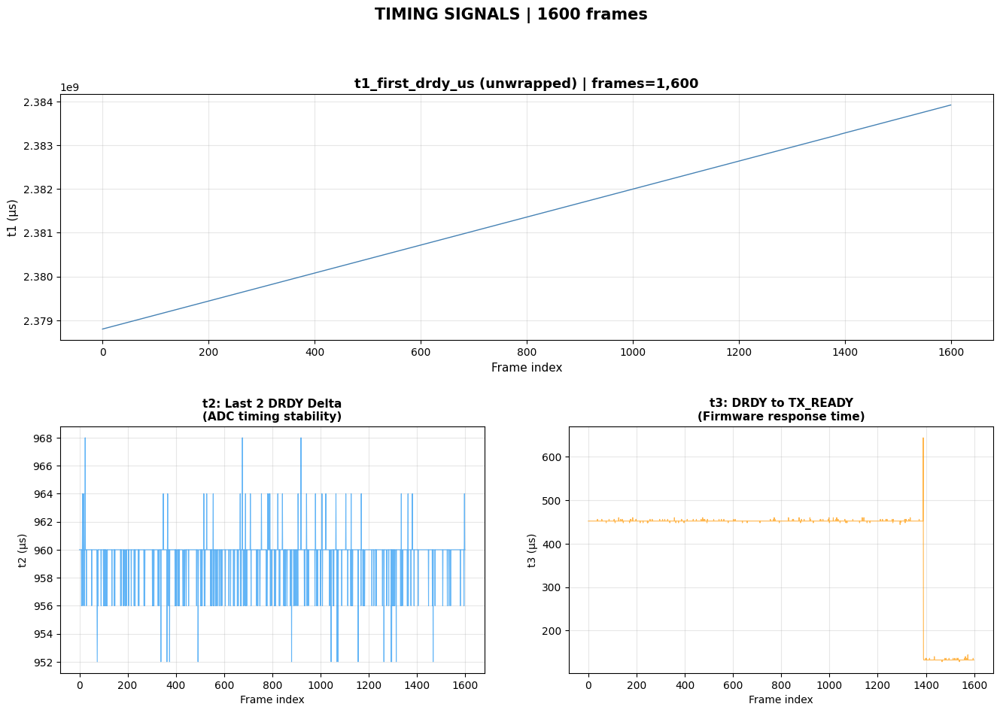

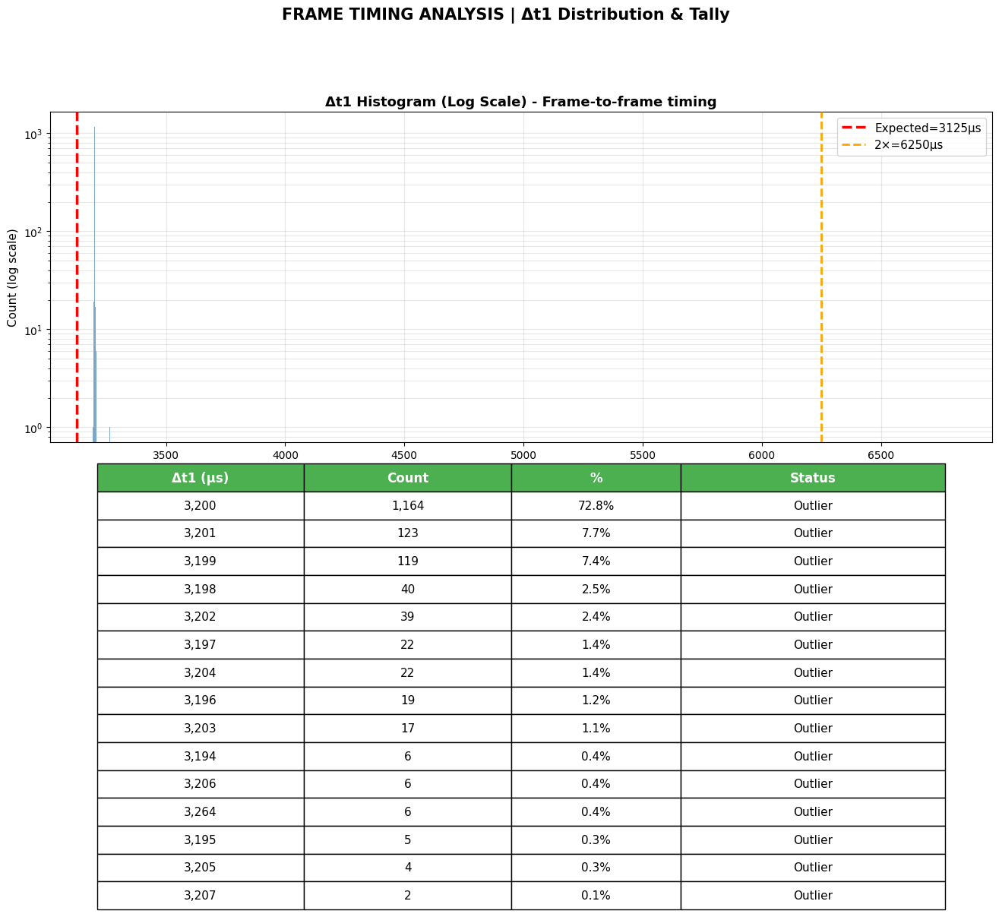

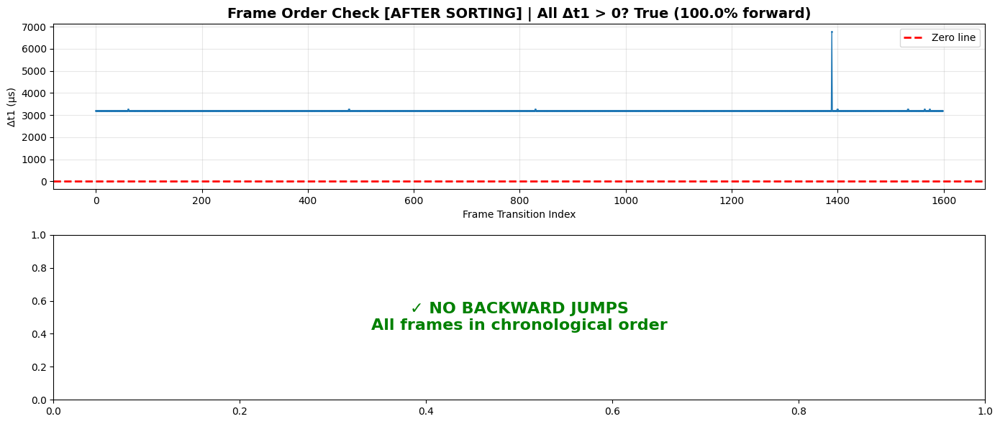

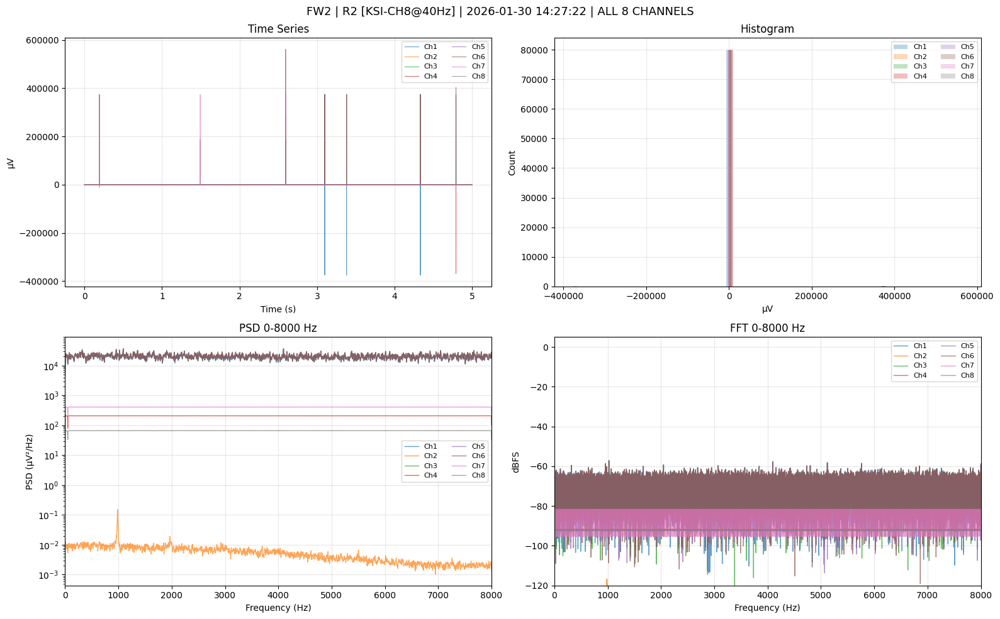

...

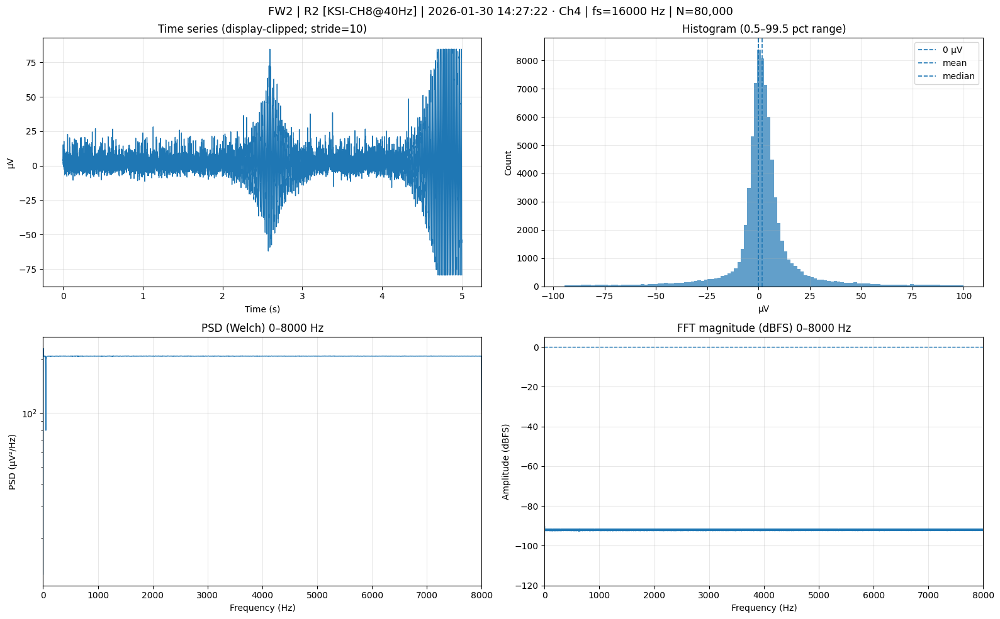

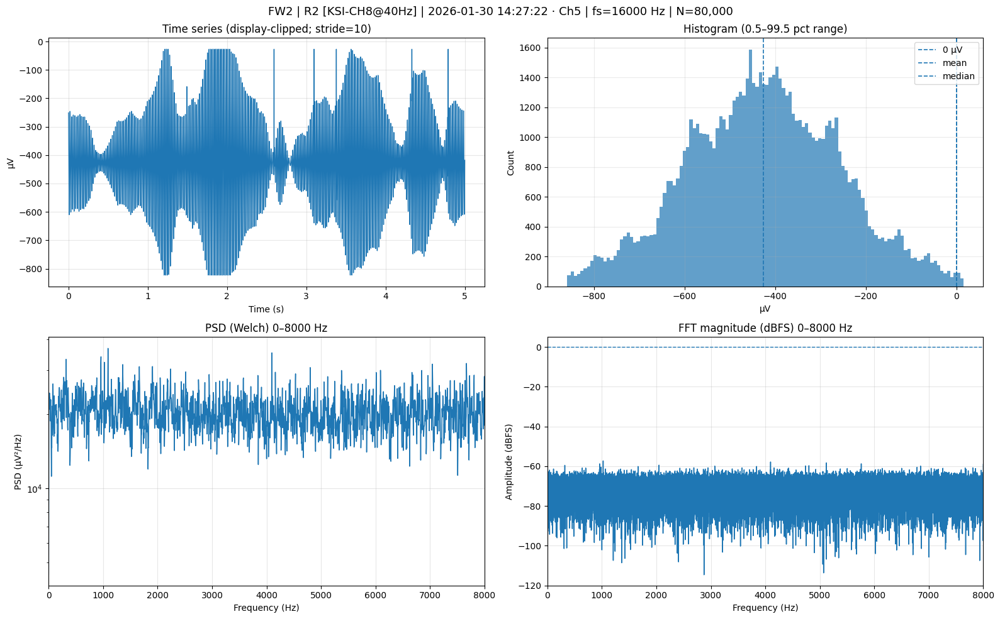

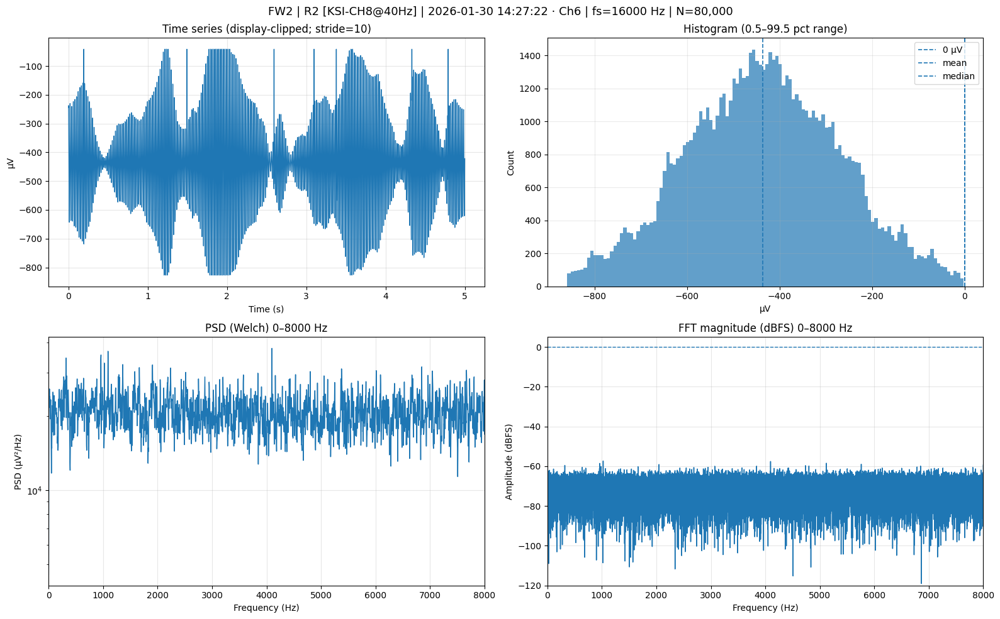

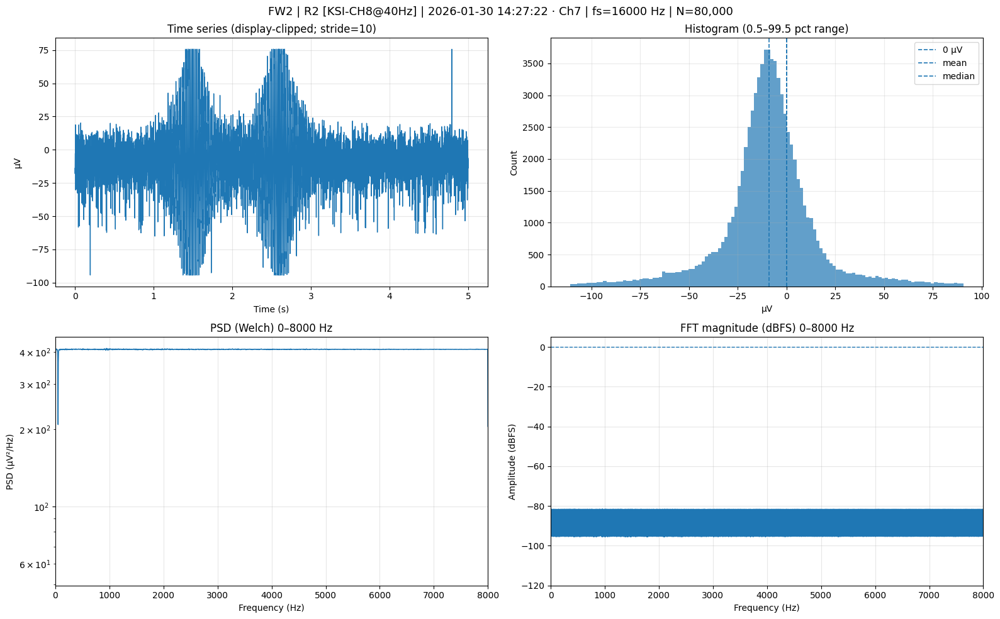

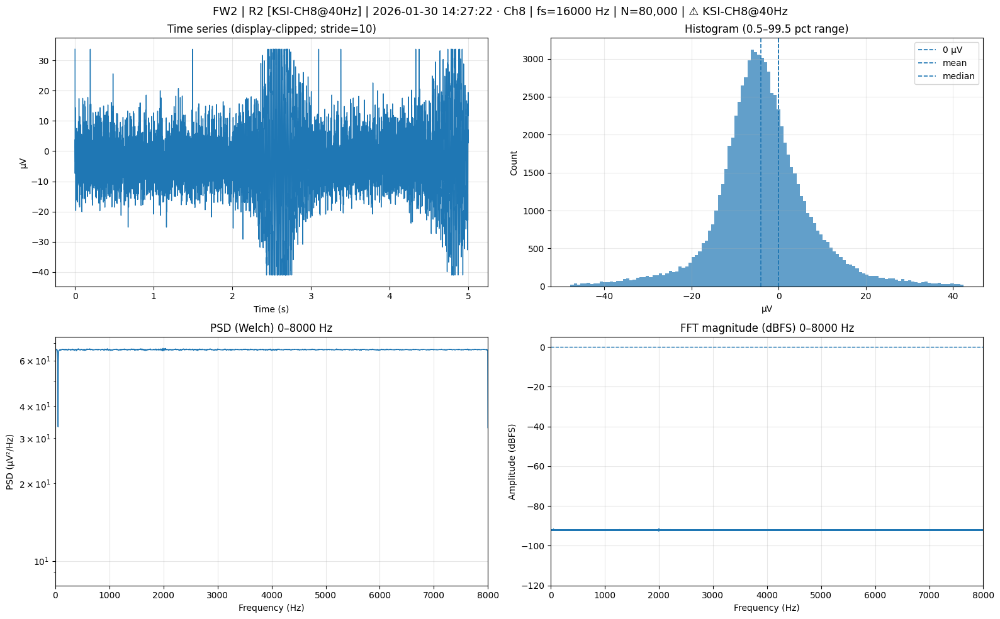


✓ Exporting PDF: 260130_142722_FW2_R2_KSI_CH8_40HZ_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ B7 KSI CH8 analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([2378798694, 2378801894, 2378805094, ..., 2383913126, 2383916326,
          2383919526], shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 241, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([113, 113, 113, ...,  33,  33,  33], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 7200,  7250,  7300, ..., 87050, 87100, 87150],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([2378798694, 2378801894, 2378805094, ..., 2383913126, 2383916326,
          2383919526], shape=(1600,))},
  'header_first': {'t1

In [95]:
run_ksi_ch8()

### Functional analysis

In [96]:
def run_eyes_open():
    """C1: Functional Test - Eyes Open"""
    print("\n" + "="*80)
    print(" C1: FUNCTIONAL TEST - EYES OPEN ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_EYES_OPEN,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ C1 Eyes open analysis complete.")
    return results


def run_eyes_closed():
    """C2: Functional Test - Eyes Closed"""
    print("\n" + "="*80)
    print(" C2: FUNCTIONAL TEST - EYES CLOSED ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_EYES_CLOSED,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ C2 Eyes closed analysis complete.")
    return results


def run_eyes_blink():
    """C3: Functional Test - Eye Blinks"""
    print("\n" + "="*80)
    print(" C3: FUNCTIONAL TEST - EYE BLINKS ".center(80, "="))
    print("="*80)
    
    results = analyze_bin_file(
        BIN_EYES_BLINK,
        display_plots=True,
        export_pdf=True,
    )
    print("\n✓ C3 Eye blink analysis complete.")
    return results


def run_all_functional():
    """Run all functional tests sequentially"""
    print("\n" + "="*80)
    print(" RUNNING ALL FUNCTIONAL TESTS ".center(80, "="))
    print("="*80)
    
    results = {
        'eyes_open': run_eyes_open(),
        'eyes_closed': run_eyes_closed(),
        'eyes_blink': run_eyes_blink(),
    }
    
    print("\n" + "="*80)
    print("✓ ALL FUNCTIONAL TESTS COMPLETE")
    print("="*80)
    return results





======================= C1: FUNCTIONAL TEST - EYES OPEN ========================
================================ FILE METADATA =================================
File:       260130_153012_FW2_R2_FUNEO_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  FUNEO
Date:       2026-01-30 15:30:12
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
 

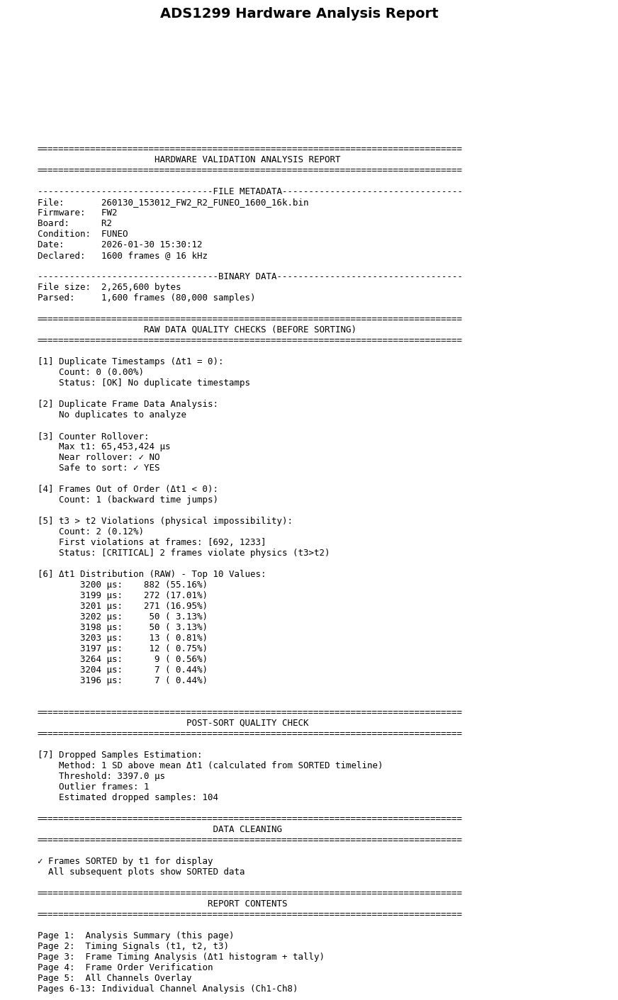

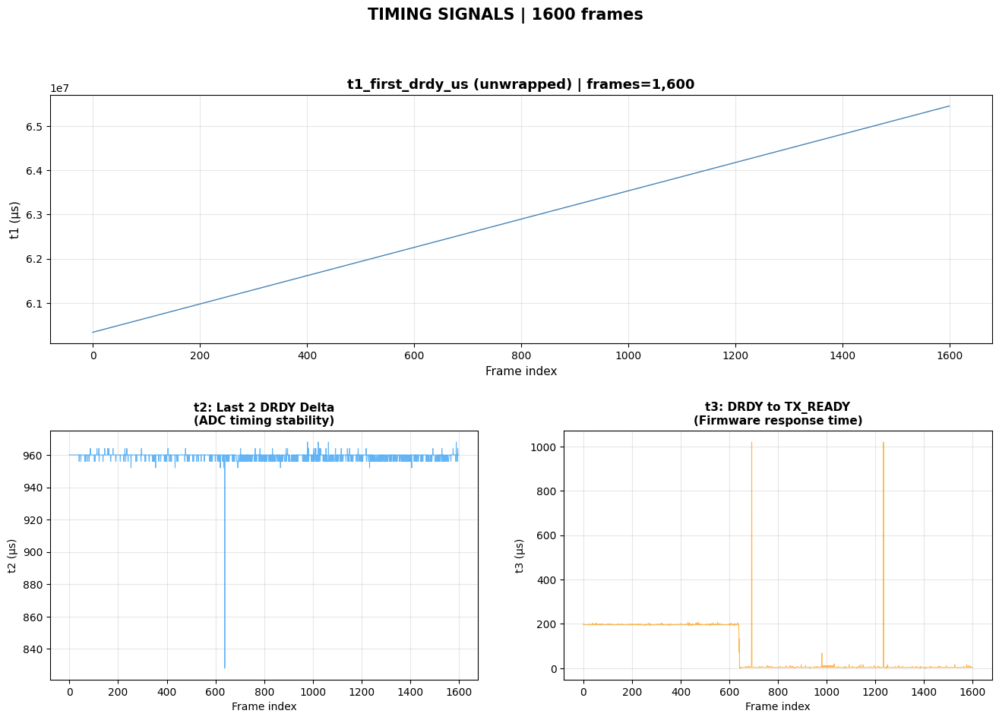

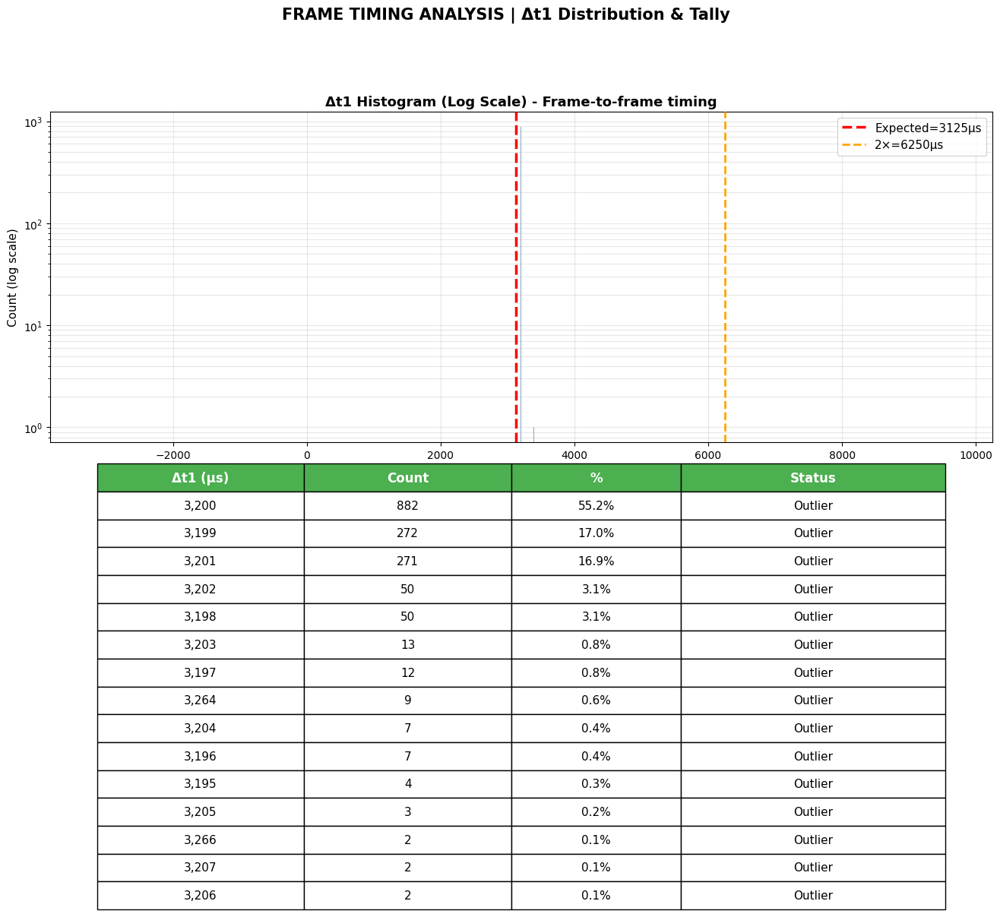

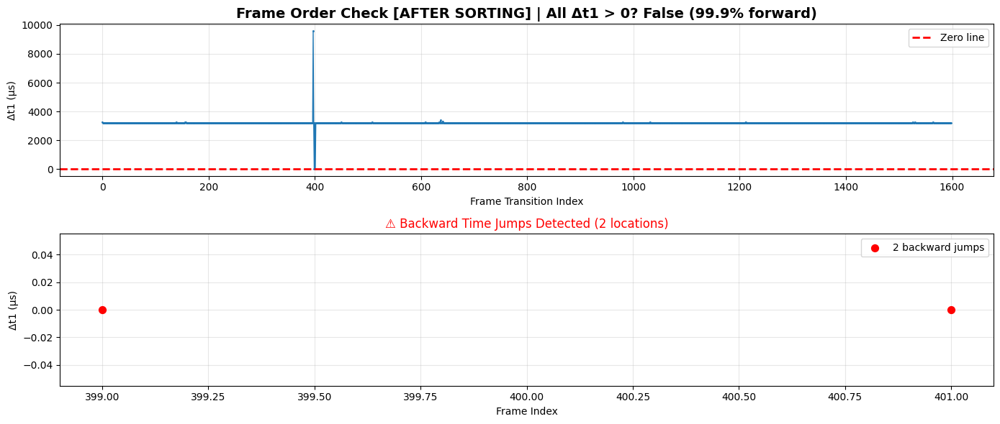

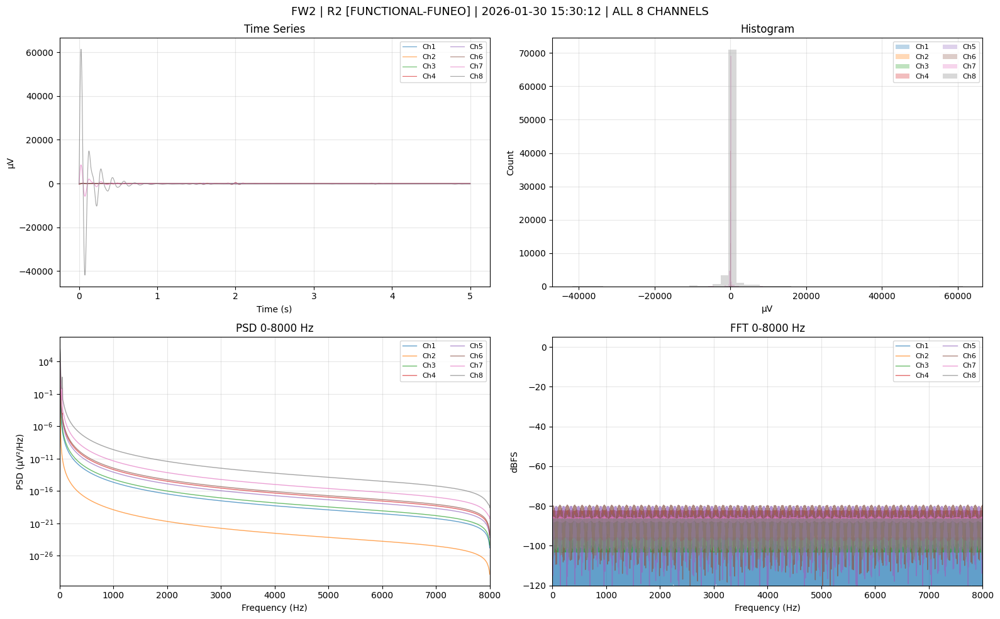

...

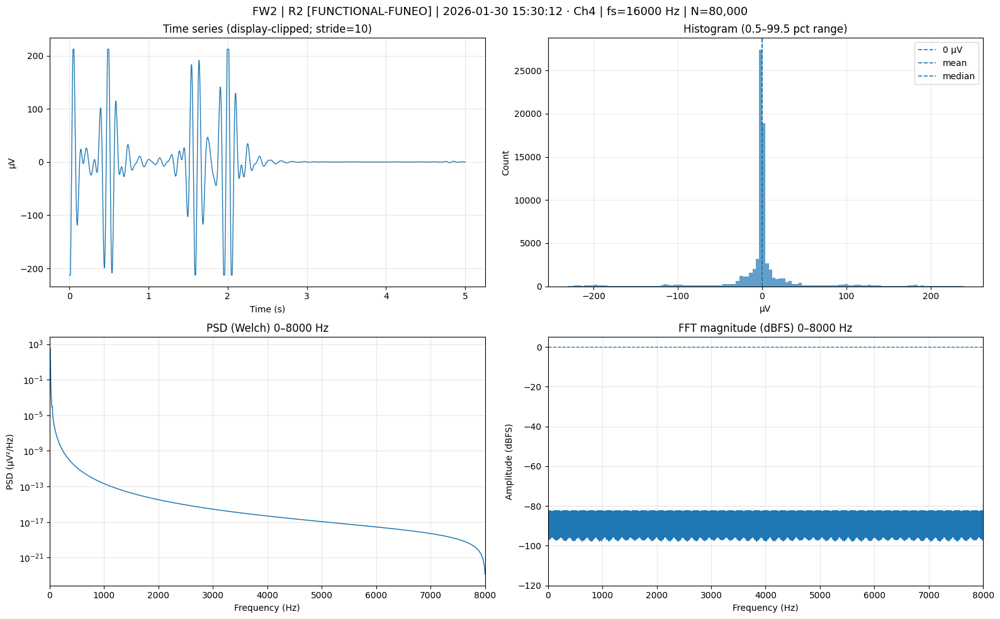

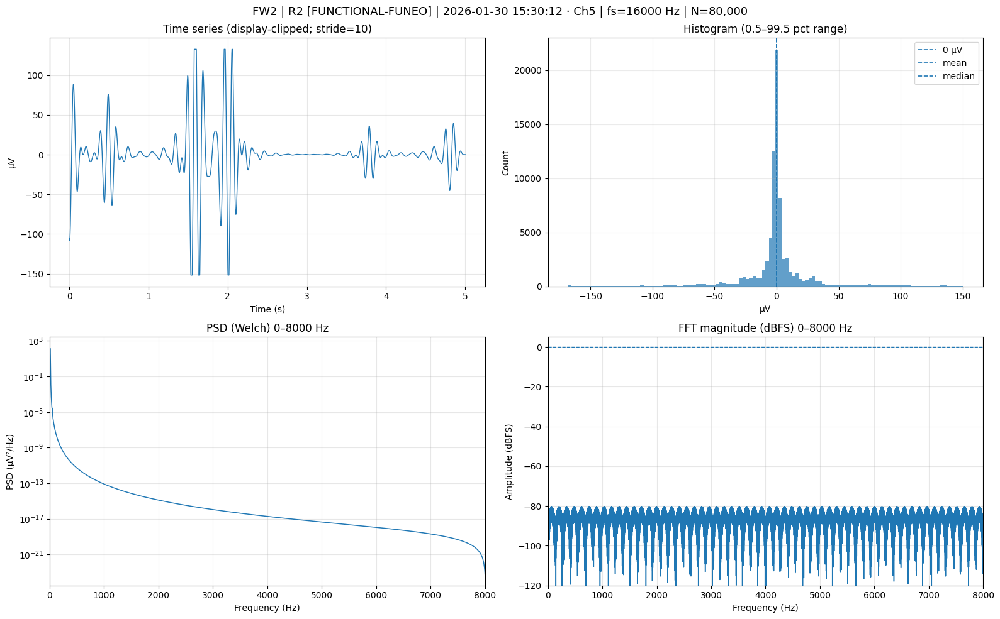

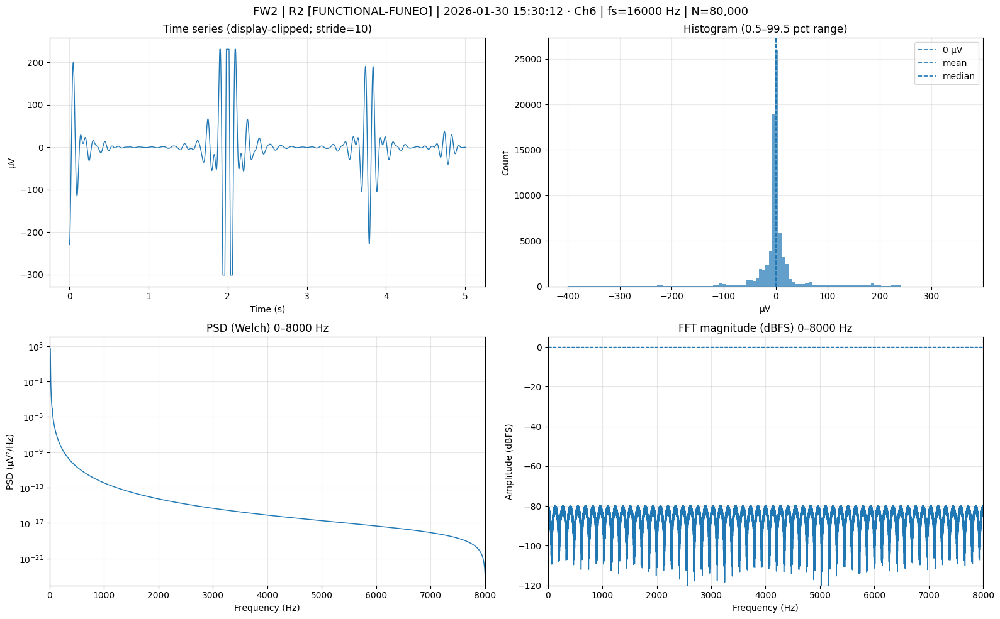

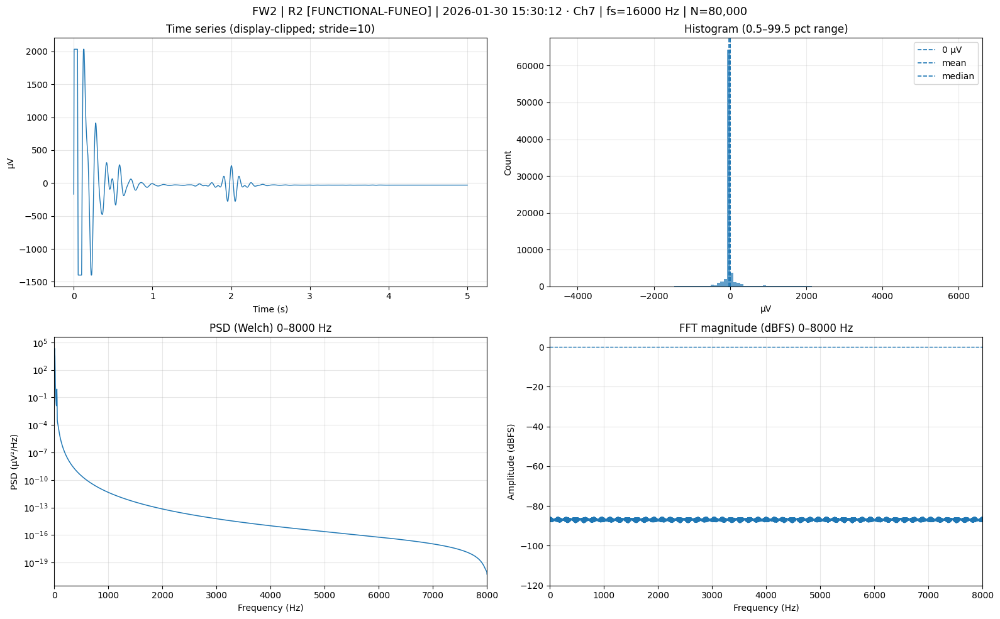

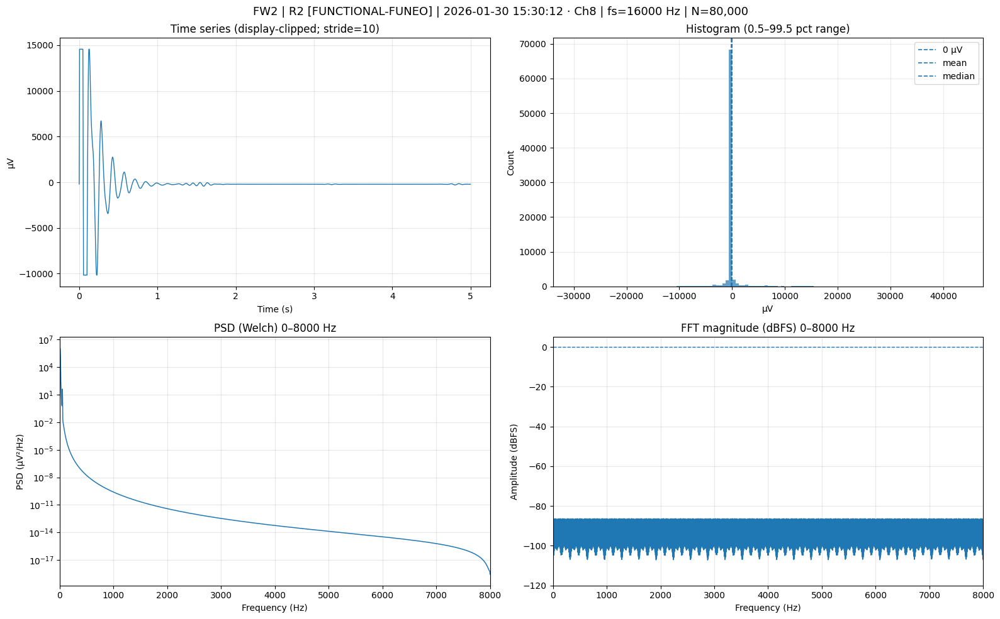


✓ Exporting PDF: 260130_153012_FW2_R2_FUNEO_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ C1 Eyes open analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([60335344, 60338608, 60341808, ..., 65447025, 65450224, 65453424],
         shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 240, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([50, 49, 49, ...,  1,  1,  1], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([10600, 10650, 10700, ..., 90450, 90500, 90550],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([60335344, 60338608, 60341808, ..., 65447025, 65450224, 65453424],
         shape=(1600,))},
  'header_first': {'t1_first_drdy_us': 60335344,
   't

In [102]:
run_eyes_open()  


====================== C2: FUNCTIONAL TEST - EYES CLOSED =======================
================================ FILE METADATA =================================
File:       260130_153215_FW2_R2_FUNEC_1600_16k.bin
Firmware:   FW2
Board:      R2
Condition:  FUNEC
Date:       2026-01-30 15:32:15
Declared:   1600 frames @ 16 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 2,265,600 bytes
Parsed 1600 frames (80000 samples)
Duration: 5.000 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 1599 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
 

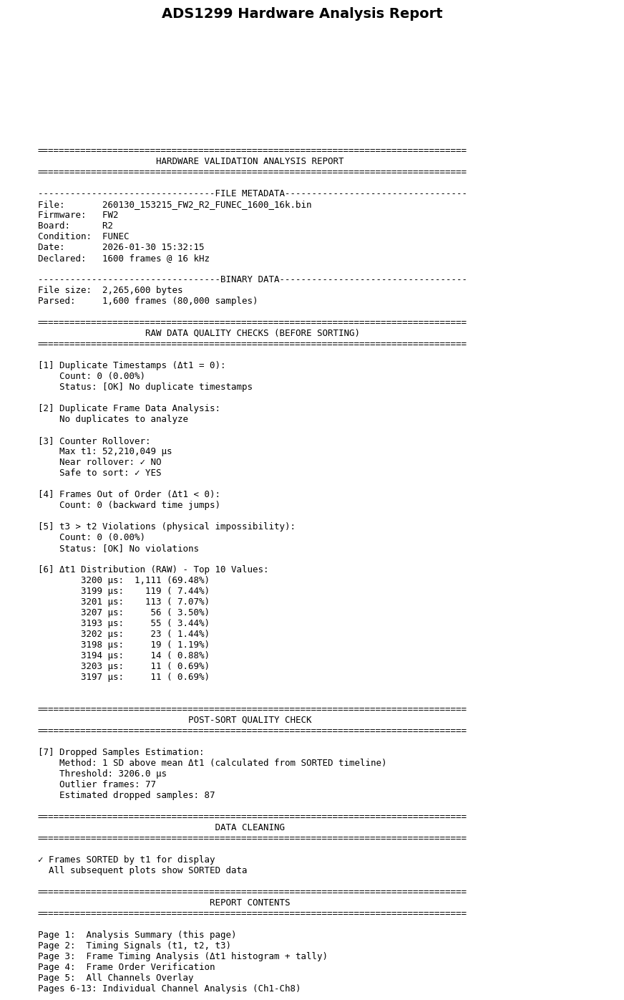

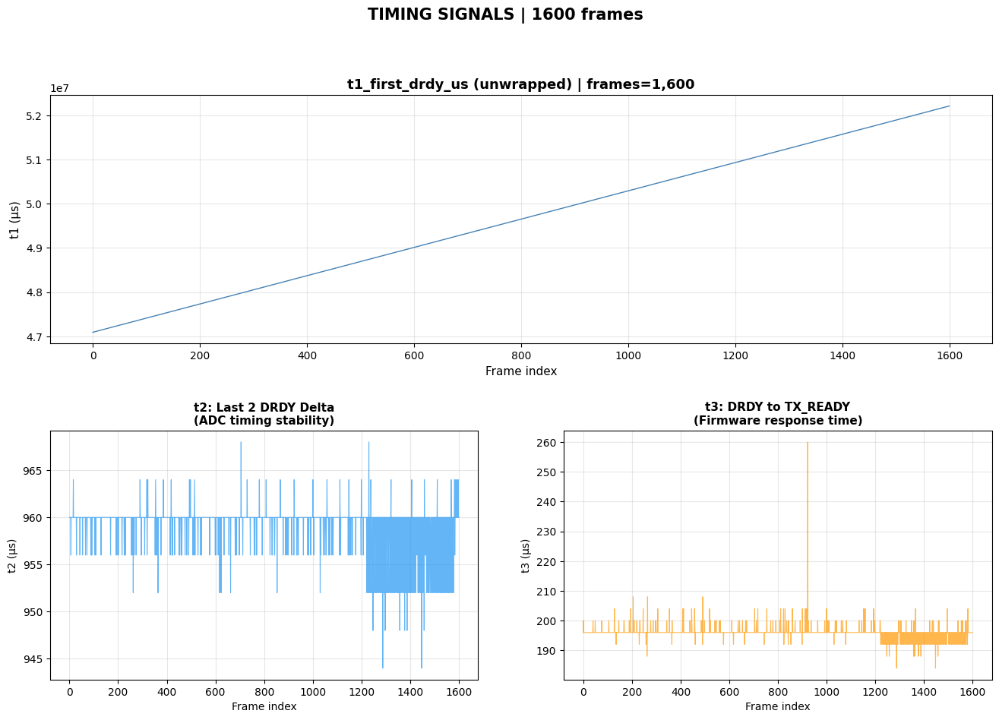

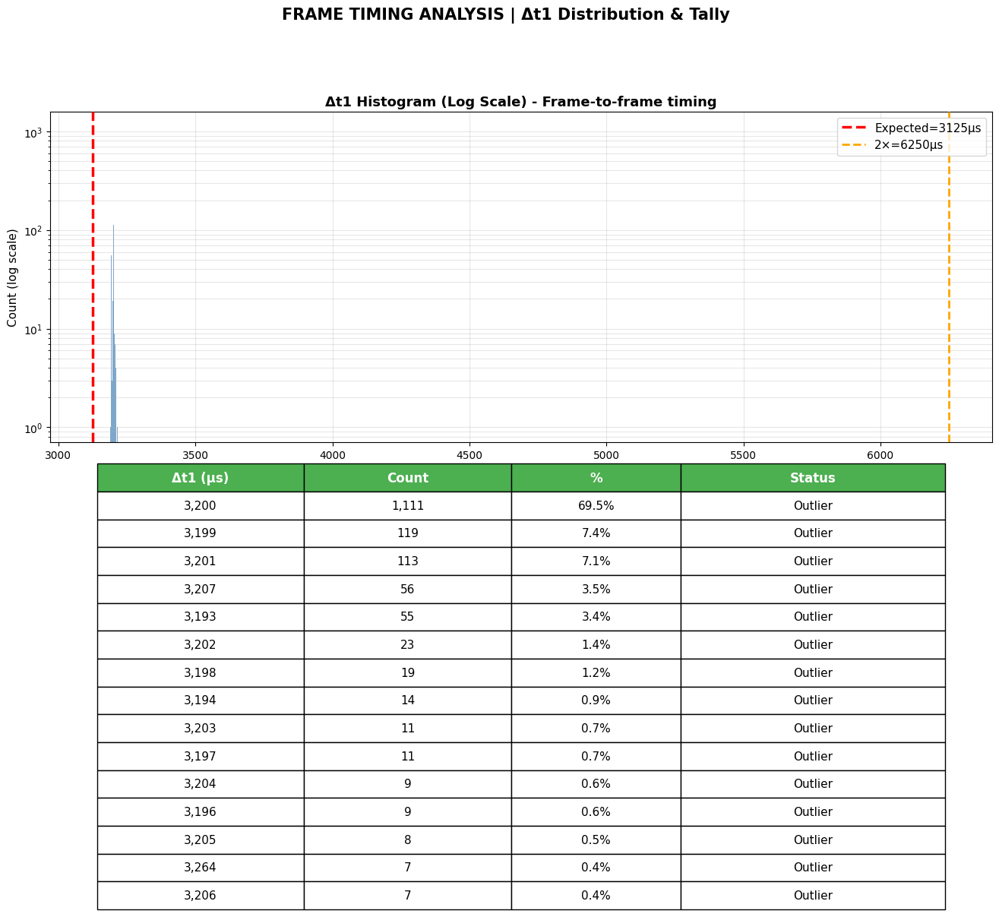

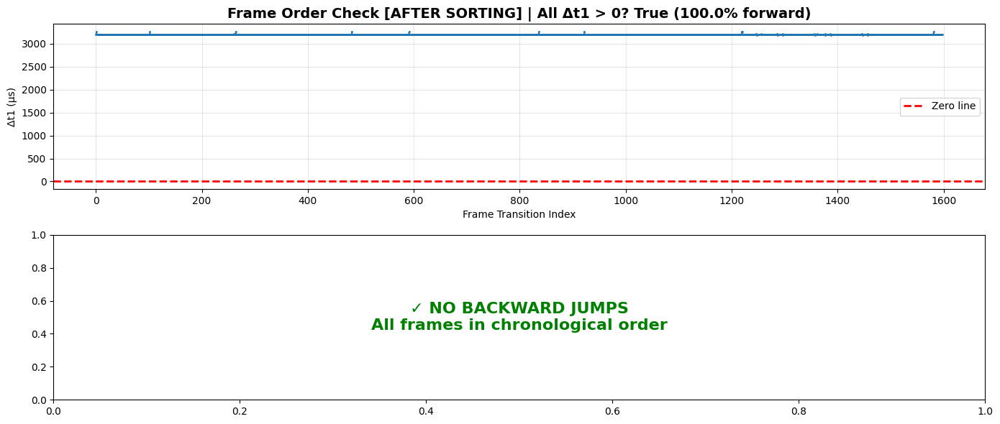

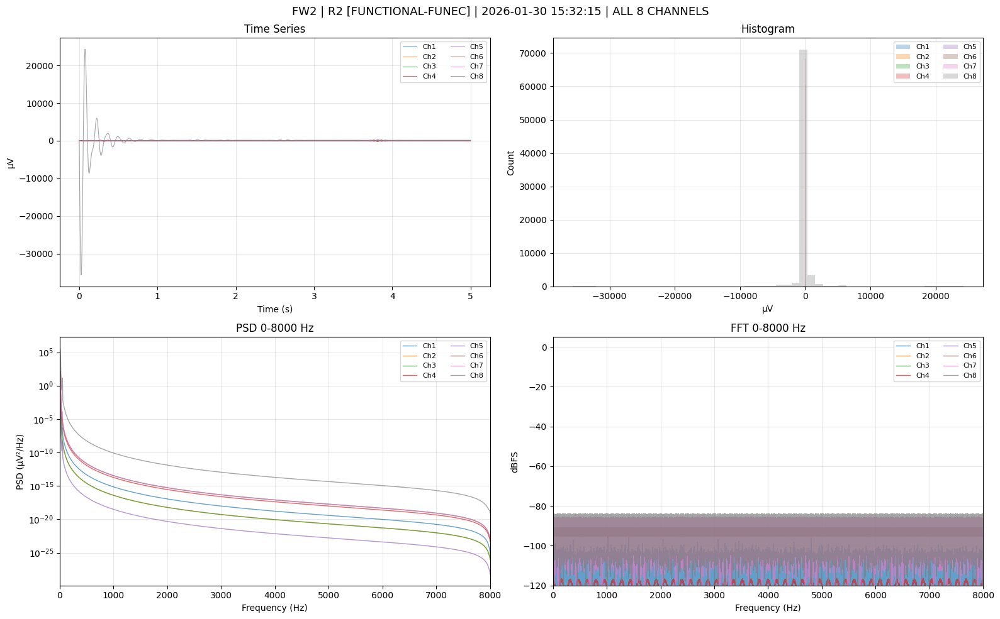

...

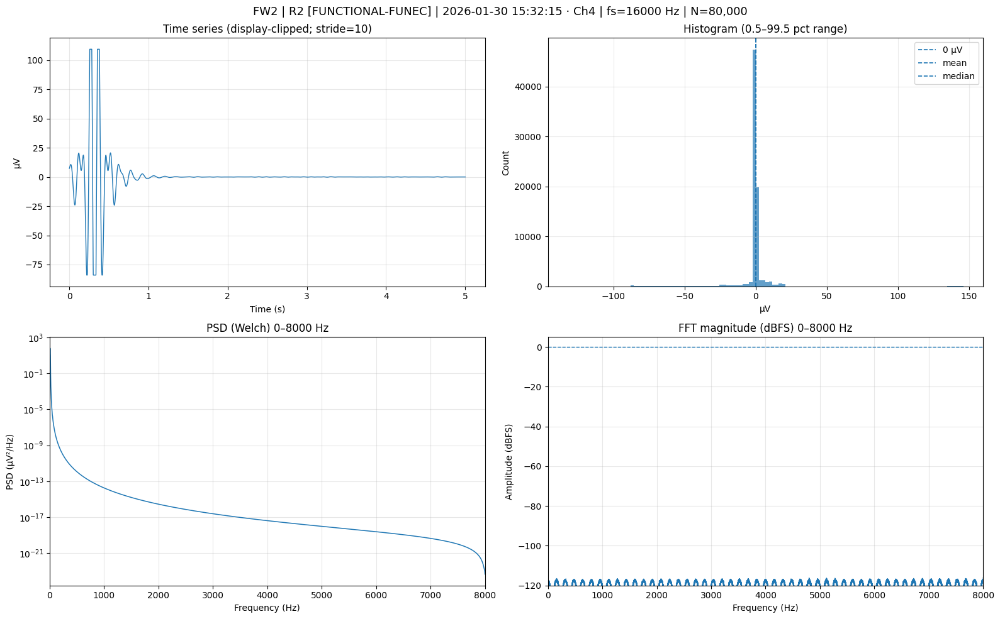

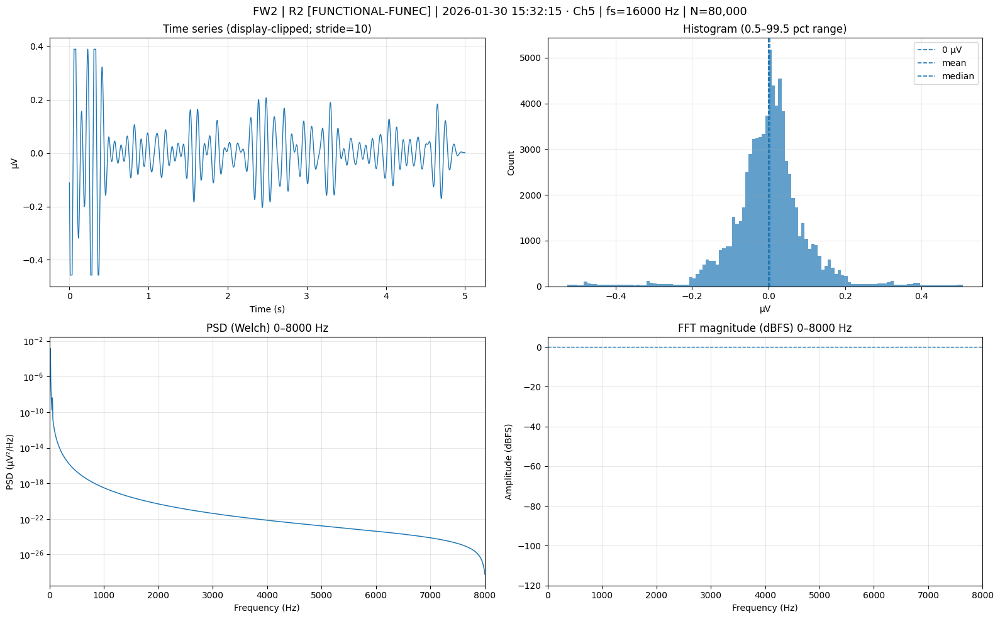

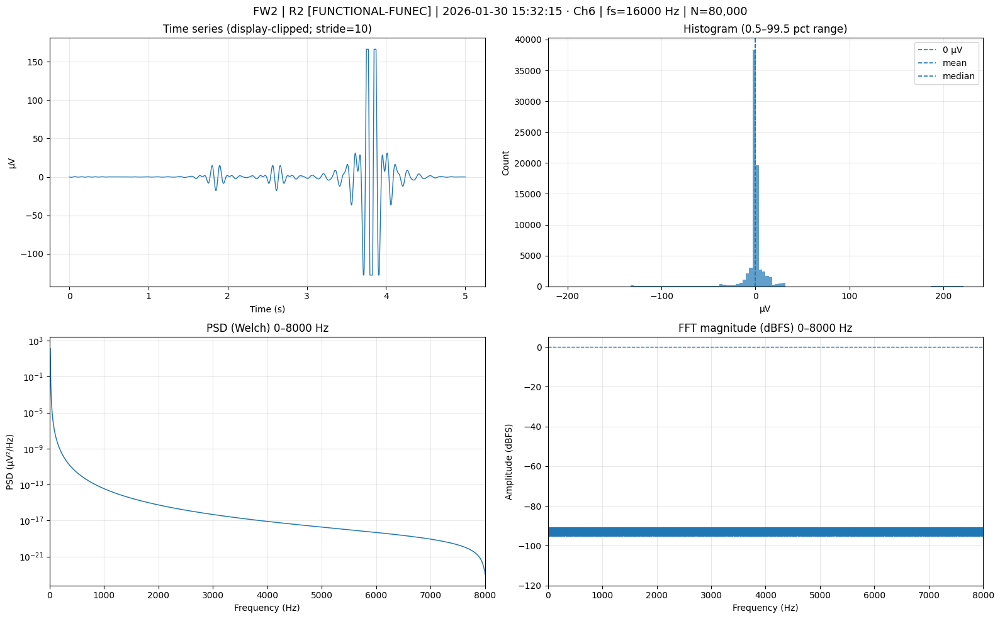

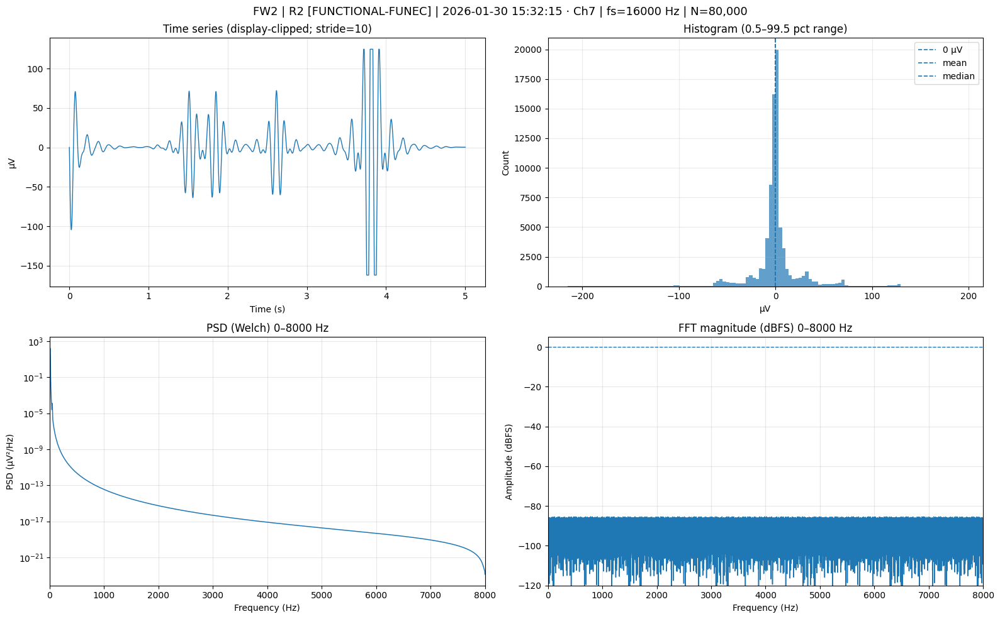

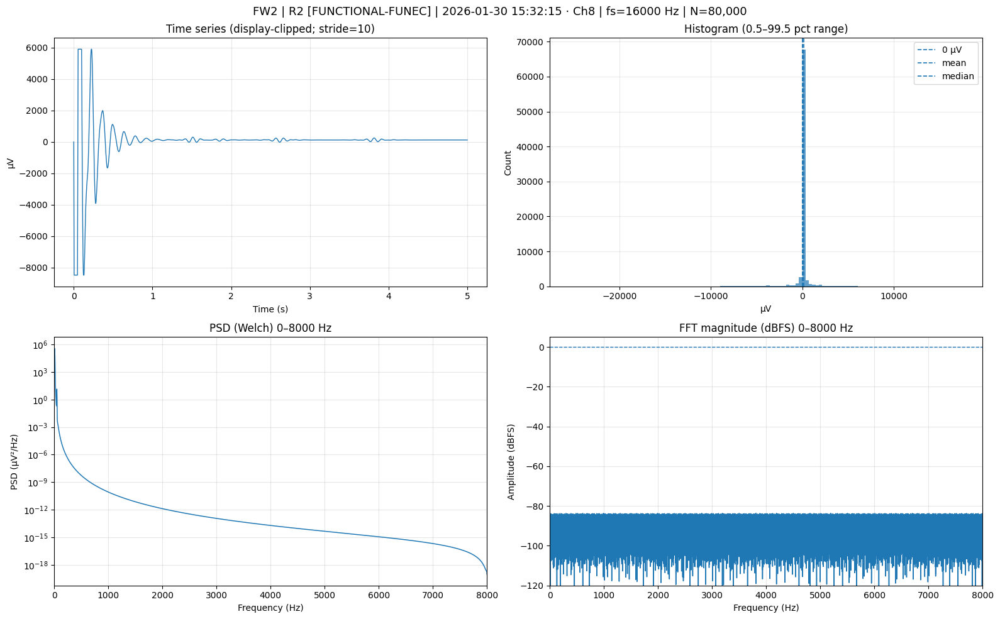


✓ Exporting PDF: 260130_153215_FW2_R2_FUNEC_1600_16k_report.pdf

✓ ANALYSIS COMPLETE

✓ C2 Eyes closed analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 1600,
  'n_samples': 80000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([47092609, 47095809, 47099073, ..., 52203649, 52206849, 52210049],
         shape=(1600,), dtype=uint32),
   't2_last_drdy_delta_4us': array([240, 240, 240, ..., 241, 240, 240], shape=(1600,), dtype=uint8),
   't3_tx_ready_delta_4us': array([49, 50, 49, ..., 49, 49, 49], shape=(1600,), dtype=uint8),
   'packet_count': array([50, 50, 50, ..., 50, 50, 50], shape=(1600,), dtype=uint16),
   'samples_sent': array([ 6900,  6950,  7000, ..., 86750, 86800, 86850],
         shape=(1600,), dtype=uint32),
   'total_samples': array([4294967295, 4294967295, 4294967295, ..., 4294967295, 4294967295,
          4294967295], shape=(1600,), dtype=uint32),
   't1_unwrapped_us': array([47092609, 47095809, 47099073, ..., 52203649, 52206849, 52210049],
         shape=(1600,))},
  'header_first': {'t1_first_drdy_us': 47092609,
   't

In [103]:
run_eyes_closed()  


======================= C3: FUNCTIONAL TEST - EYE BLINKS =======================
================================ FILE METADATA =================================
File:       260130_174236_FW2_R2_FUNEB_200_1k.bin
Firmware:   FW2
Board:      R2
Condition:  FUNEB
Date:       2026-01-30 17:42:36
Declared:   200 frames @ 1 kHz

────────────────────────────────────────────────────────────────────────────────
LOADING & PARSING BINARY
────────────────────────────────────────────────────────────────────────────────
Loaded 283,200 bytes
Parsed 200 frames (10000 samples)
Duration: 0.625 s

=================== RAW DATA QUALITY CHECKS (BEFORE SORTING) ===================
(Analyzing data in RECEIVED ORDER - no sorting applied)

[Preprocessing] Computed 199 frame transitions from RAW data

[Check 1] Duplicate Timestamps (Δt1 = 0):
    Count: 0 (0.00%)
    Status: [OK] No duplicate timestamps

[Check 2] Duplicate Frame Data Analysis:
    No duplicates to analyze

[Check 3] Counter Rollover:
    Max t

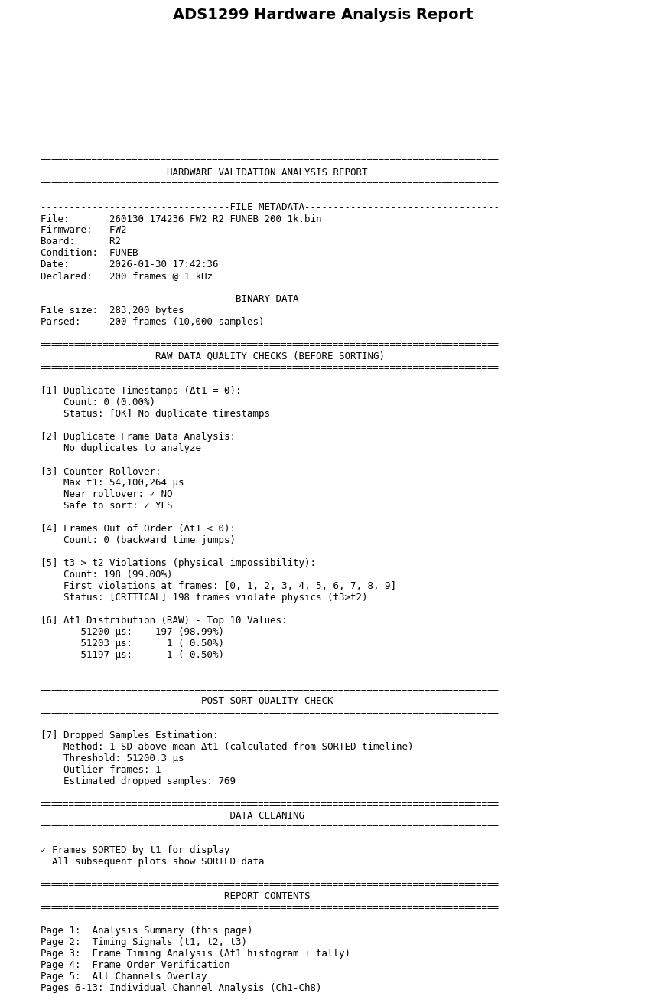

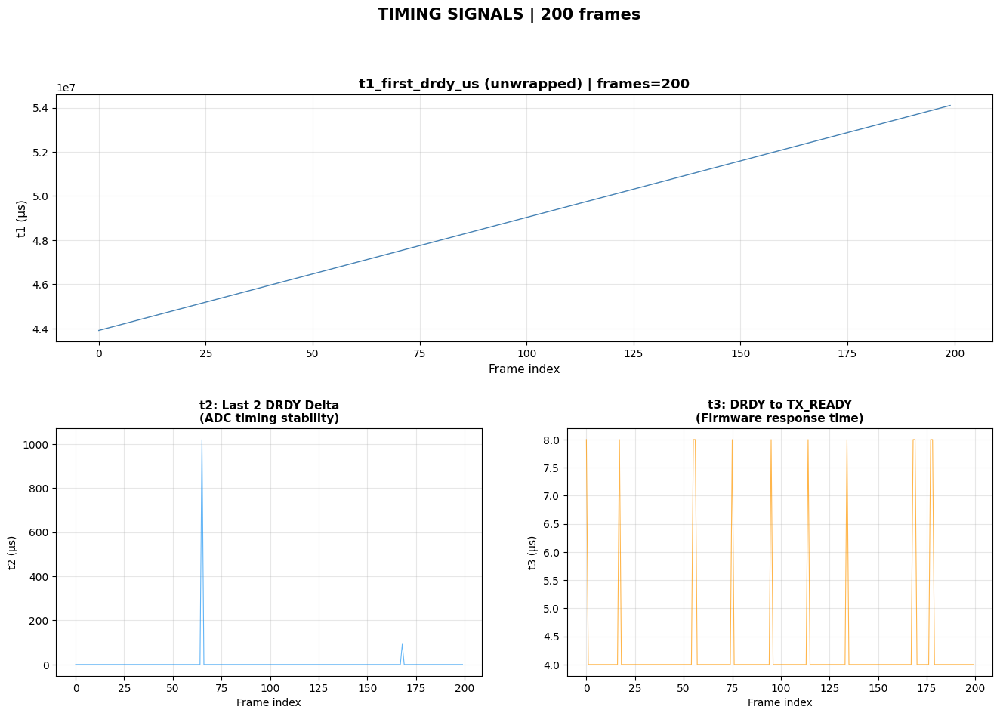

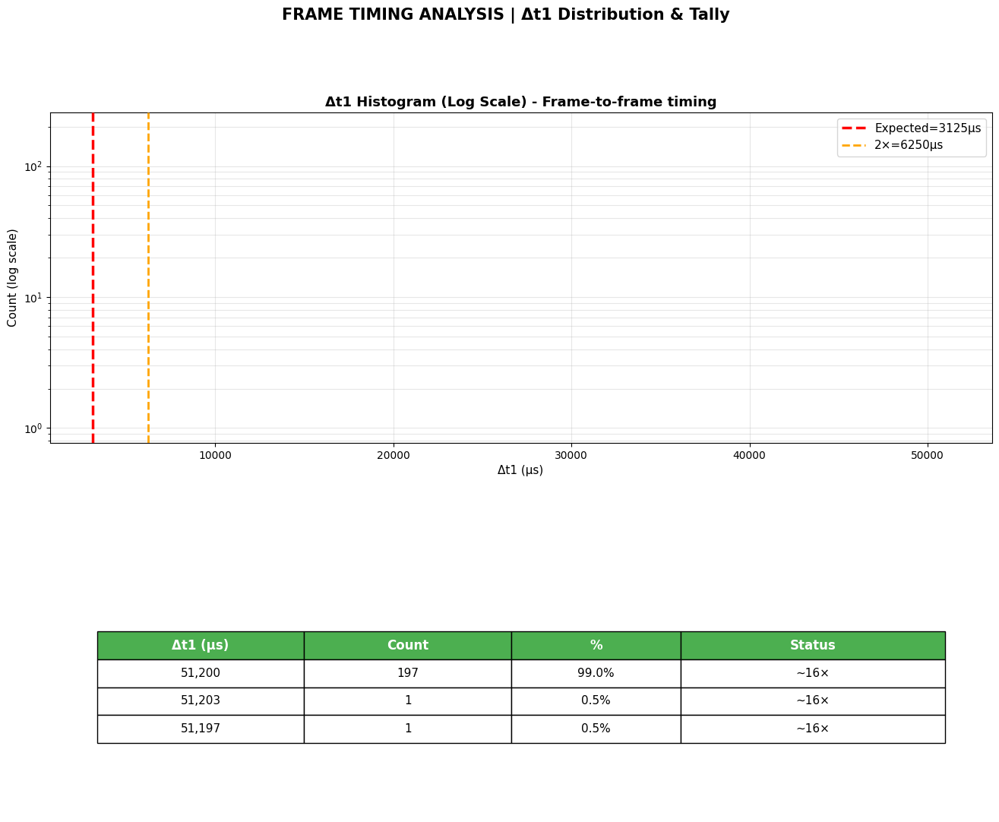

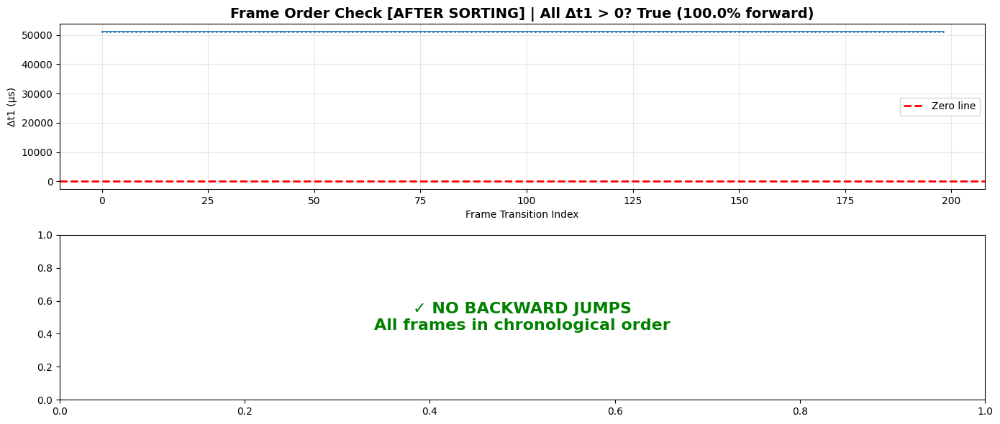

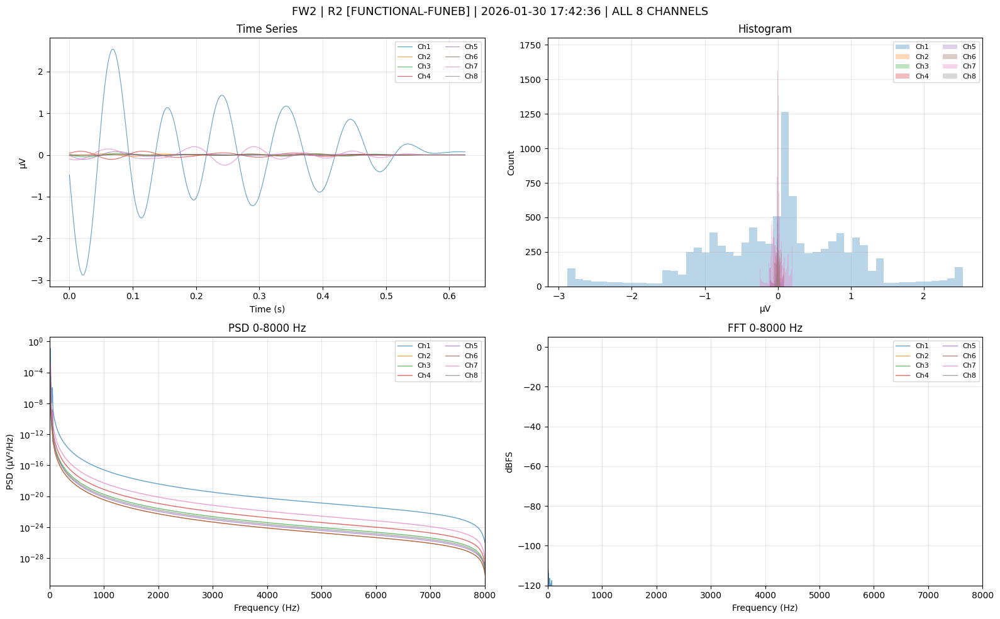

...

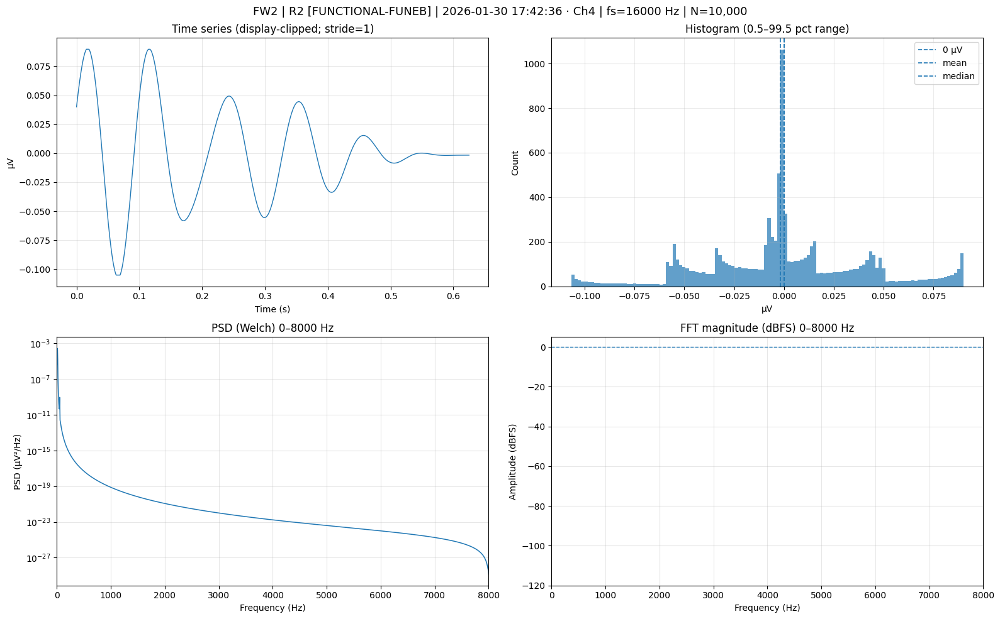

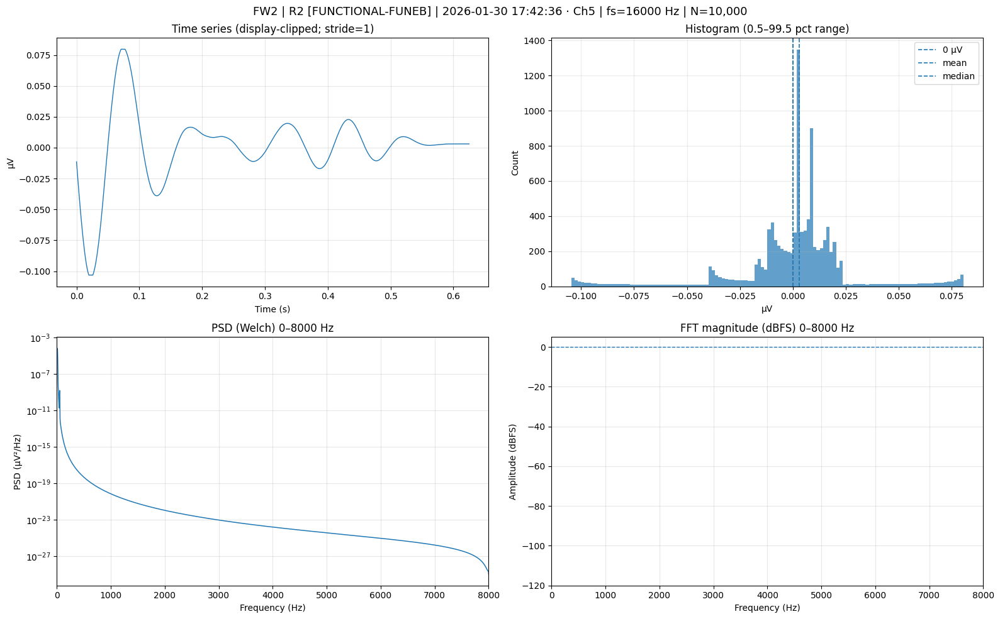

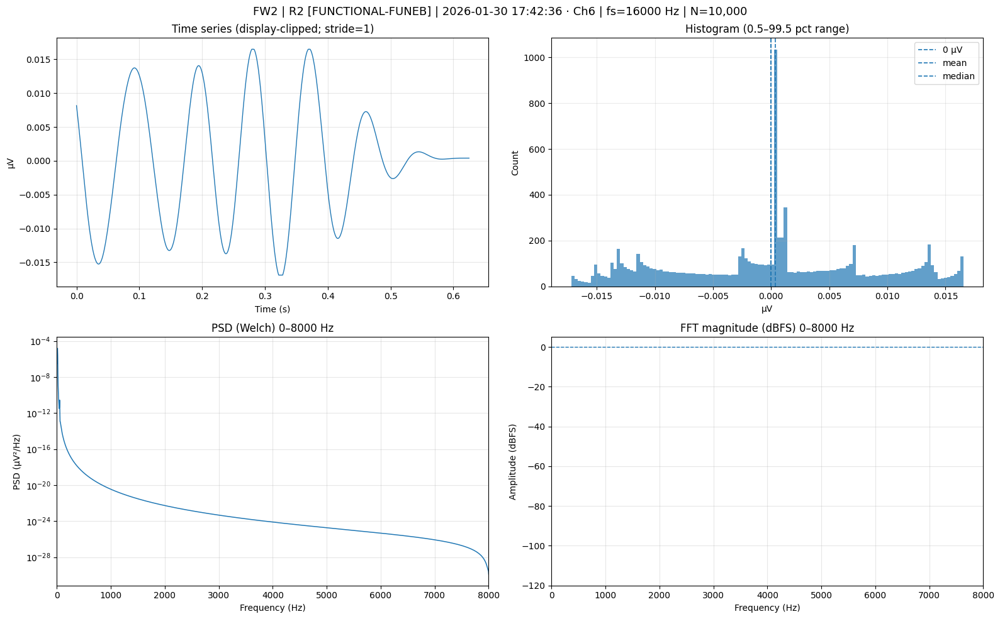

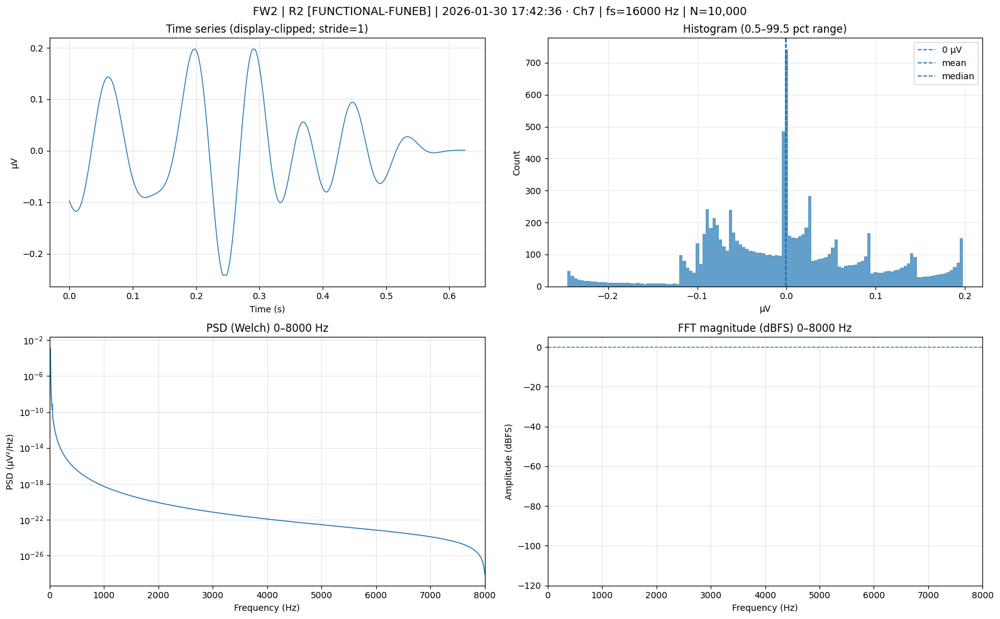

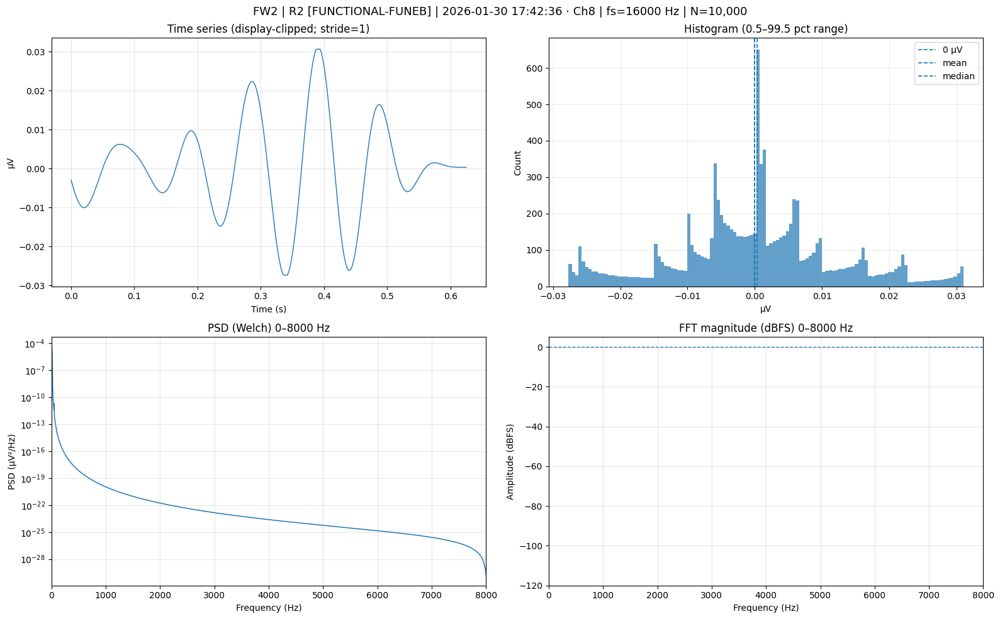


✓ Exporting PDF: 260130_174236_FW2_R2_FUNEB_200_1k_report.pdf

✓ ANALYSIS COMPLETE

✓ C3 Eye blink analysis complete.


{'meta': {'frame_bytes': 1416,
  'n_frames': 200,
  'n_samples': 10000,
  'packets_per_frame': 50,
  'packet_bytes': 28,
  'sample_bytes': 27,
  'hdr': {'t1_first_drdy_us': array([43911464, 43962664, 44013864, 44065064, 44116264, 44167464,
          44218664, 44269864, 44321064, 44372264, 44423464, 44474664,
          44525864, 44577064, 44628264, 44679464, 44730664, 44781864,
          44833064, 44884264, 44935464, 44986664, 45037864, 45089064,
          45140264, 45191464, 45242664, 45293864, 45345064, 45396264,
          45447464, 45498664, 45549864, 45601064, 45652264, 45703464,
          45754664, 45805864, 45857064, 45908264, 45959464, 46010664,
          46061864, 46113064, 46164264, 46215464, 46266664, 46317864,
          46369064, 46420264, 46471464, 46522664, 46573864, 46625064,
          46676264, 46727464, 46778664, 46829864, 46881064, 46932264,
          46983464, 47034664, 47085864, 47137064, 47188264, 47239467,
          47290664, 47341864, 47393064, 47444264, 47495464, 

In [106]:
run_eyes_blink()  

In [114]:
from pathlib import Path

BIN_EYES_OPEN = Path(r"G:\Shared drives\03_Hardware\06_Validation\Headband\260130\validation\260130_153012_FW2_R2_FUNEO_1600_16k.bin")
BIN_EYES_CLOSED = Path(r"G:\Shared drives\03_Hardware\06_Validation\Headband\260130\validation\260130_153215_FW2_R2_FUNEC_1600_16k.bin")

print("✓ Montage paths configured")
print(f"  Eyes Open:   {BIN_EYES_OPEN.name}")
print(f"  Eyes Closed: {BIN_EYES_CLOSED.name}")

✓ Montage paths configured
  Eyes Open:   260130_153012_FW2_R2_FUNEO_1600_16k.bin
  Eyes Closed: 260130_153215_FW2_R2_FUNEC_1600_16k.bin


In [115]:


# IMPORTANT: counts_all shape = (8, n_samples)
#   counts_all[0] = Hardware Channel 1
#   counts_all[1] = Hardware Channel 2  → Fp1
#   counts_all[2] = Hardware Channel 3  → Fp2
#   counts_all[3] = Hardware Channel 4  → O1
#   counts_all[4] = Hardware Channel 5  → O2
#
# Therefore: array_index = hardware_channel - 1

ELECTRODE_MAP = {
    2: "Fp1",   # Frontal left  → Hardware Ch2 → array index 1
    3: "Fp2",   # Frontal right → Hardware Ch3 → array index 2
    4: "O1",    # Occipital left  → Hardware Ch4 → array index 3
    5: "O2",    # Occipital right → Hardware Ch5 → array index 4
}

# Channels to plot (hardware channel numbers, in display order)
FUNCTIONAL_CHANNELS = [2, 3, 4, 5]

# Row order for the montage (top to bottom)
MONTAGE_ORDER = ["Fp1", "Fp2", "O1", "O2"]

print("✓ Electrode mapping configured")
print(f"  Channels: {FUNCTIONAL_CHANNELS}")



✓ Electrode mapping configured
  Channels: [2, 3, 4, 5]


In [116]:
# ═══════════════════════════════════════════════════════════════════════════════
# MONTAGE PLOT FUNCTION
# ═══════════════════════════════════════════════════════════════════════════════

def plot_eo_ec_montage(
    counts_eo: np.ndarray,
    counts_ec: np.ndarray,
    *,
    fs_hz: int = FS_HZ,
    time_window_s: tuple = (0, 5),
    title: str = "Eyes Open vs Eyes Closed — EEG Montage",
    figsize: tuple = (16, 10),
) -> plt.Figure:
    """
    Plot 4-channel EEG montage comparing Eyes Open vs Eyes Closed.
    
    Layout:
        Left column:  Eyes Open
        Right column: Eyes Closed
        Rows:         Fp1, Fp2, O1, O2 (top to bottom)
    
    Parameters:
    -----------
    counts_eo : np.ndarray
        Raw ADC counts for Eyes Open, shape (8, n_samples)
    counts_ec : np.ndarray
        Raw ADC counts for Eyes Closed, shape (8, n_samples)
    fs_hz : int
        Sampling rate in Hz
    time_window_s : tuple
        (start, end) time window in seconds to display
    title : str
        Overall figure title
    figsize : tuple
        Figure size (width, height) in inches
    
    Returns:
    --------
    plt.Figure
    """
    
    # Calculate sample indices for time window
    start_sample = int(time_window_s[0] * fs_hz)
    end_sample = int(time_window_s[1] * fs_hz)
    
    # Time axis in seconds
    n_samples = end_sample - start_sample
    t = np.arange(n_samples) / fs_hz + time_window_s[0]
    
    # Create figure with shared axes
    fig, axes = plt.subplots(
        nrows=4, 
        ncols=2, 
        figsize=figsize,
        sharex=True,
        sharey=True,
    )
    
    # Column titles
    fig.suptitle(title, fontsize=16, fontweight='bold', y=0.98)
    axes[0, 0].set_title("Eyes Open", fontsize=14, fontweight='bold', pad=10)
    axes[0, 1].set_title("Eyes Closed", fontsize=14, fontweight='bold', pad=10)
    
    # Define channel order for rows (index in FUNCTIONAL_CHANNELS)
    channel_order = [2, 3, 4, 5]  # Hardware channel numbers in row order
    
    # Process and plot each channel
    for row, hw_ch in enumerate(channel_order):
        arr_idx = hw_ch - 1  # Convert hardware channel to array index
        electrode = ELECTRODE_MAP[hw_ch]
        
        # ─── Eyes Open (left column) ───────────────────────────────────────
        uv_eo = preprocess_channel_uv(
            counts_eo[arr_idx],
            fs_hz=fs_hz,
            channel_idx=arr_idx,
            test_type="functional",  # Applies 7-13 Hz bandpass + 50 Hz notch
        )
        uv_eo_window = uv_eo[start_sample:end_sample]
        
        axes[row, 0].plot(t, uv_eo_window, linewidth=0.8, color='#1f77b4')
        axes[row, 0].set_ylabel(electrode, fontsize=12, fontweight='bold', rotation=0, ha='right', va='center')
        axes[row, 0].yaxis.set_label_coords(-0.02, 0.5)
        axes[row, 0].grid(alpha=0.3, linestyle='--')
        
        # ─── Eyes Closed (right column) ────────────────────────────────────
        uv_ec = preprocess_channel_uv(
            counts_ec[arr_idx],
            fs_hz=fs_hz,
            channel_idx=arr_idx,
            test_type="functional",  # Applies 7-13 Hz bandpass + 50 Hz notch
        )
        uv_ec_window = uv_ec[start_sample:end_sample]
        
        axes[row, 1].plot(t, uv_ec_window, linewidth=0.8, color='#1f77b4')
        axes[row, 1].grid(alpha=0.3, linestyle='--')
    
    # X-axis labels (bottom row only)
    axes[3, 0].set_xlabel("Time (s)", fontsize=12)
    axes[3, 1].set_xlabel("Time (s)", fontsize=12)
    
    # Add scale bar annotation (bottom right)
    y_min, y_max = axes[0, 0].get_ylim()
    scale_range = y_max - y_min
    axes[3, 1].annotate(
        f'Scale\n{scale_range:.0f} µV',
        xy=(1.02, 0.5),
        xycoords='axes fraction',
        fontsize=10,
        ha='left',
        va='center',
    )
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.93, hspace=0.1, wspace=0.15)
    
    return fig




================ EYES OPEN vs EYES CLOSED — MONTAGE GENERATION =================
[OK] Eyes open:   260130_153012_FW2_R2_FUNEO_1600_16k.bin
[OK] Eyes closed: 260130_153215_FW2_R2_FUNEC_1600_16k.bin

[1/3] Parsing Eyes Open...
      1600 frames, 80000 samples
[2/3] Parsing Eyes Closed...
      1600 frames, 80000 samples
[3/3] Generating montage plot...


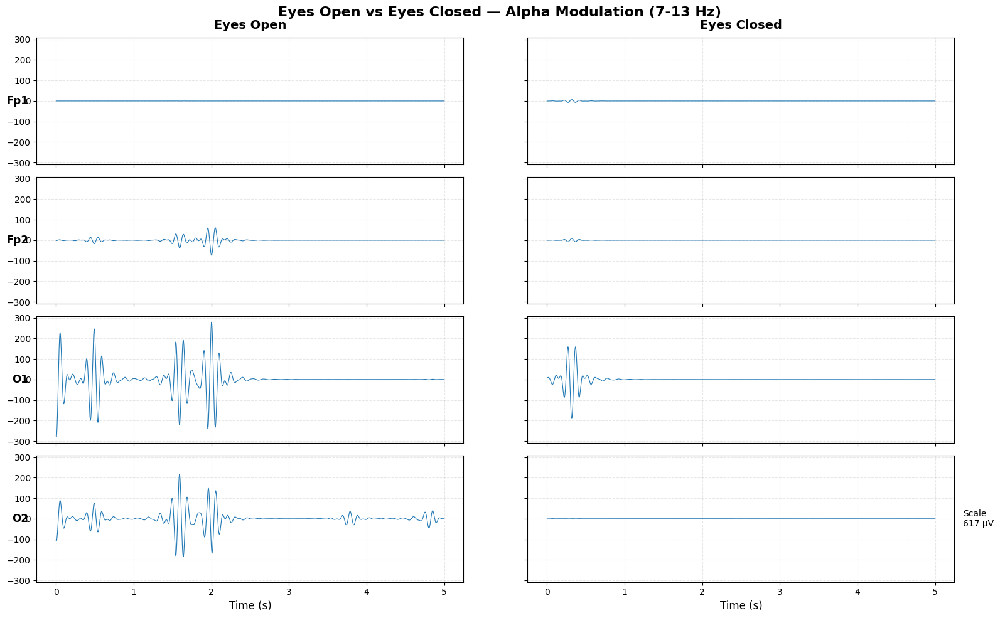


✓ MONTAGE COMPLETE

NOTE: Eyes Closed (right) should show stronger alpha oscillations
      especially in O1/O2 (occipital channels).


In [117]:
# ═══════════════════════════════════════════════════════════════════════════════
# RUN: Eyes Open vs Eyes Closed Montage
# ═══════════════════════════════════════════════════════════════════════════════
# Just edit BIN_EYES_OPEN and BIN_EYES_CLOSED in Cell 1, then run this cell.

print("="*80)
print(" EYES OPEN vs EYES CLOSED — MONTAGE GENERATION ".center(80, "="))
print("="*80)

# ─── Validate paths exist ──────────────────────────────────────────────────────
files_ok = True

if not BIN_EYES_OPEN.exists():
    print(f"[SKIP] Eyes open file not found: {BIN_EYES_OPEN}")
    files_ok = False
else:
    print(f"[OK] Eyes open:   {BIN_EYES_OPEN.name}")

if not BIN_EYES_CLOSED.exists():
    print(f"[SKIP] Eyes closed file not found: {BIN_EYES_CLOSED}")
    files_ok = False
else:
    print(f"[OK] Eyes closed: {BIN_EYES_CLOSED.name}")

if not files_ok:
    print("\n⚠️ One or more files missing. Skipping montage generation.")
else:
    # ─── Parse Eyes Open ───────────────────────────────────────────────────
    print("\n[1/3] Parsing Eyes Open...")
    bin_bytes_eo = BIN_EYES_OPEN.read_bytes()
    counts_eo, meta_eo = parse_ads1299_framestream_bin_bytes_strict_1416(bin_bytes_eo)
    print(f"      {meta_eo['n_frames']} frames, {meta_eo['n_samples']} samples")
    
    # ─── Parse Eyes Closed ─────────────────────────────────────────────────
    print("[2/3] Parsing Eyes Closed...")
    bin_bytes_ec = BIN_EYES_CLOSED.read_bytes()
    counts_ec, meta_ec = parse_ads1299_framestream_bin_bytes_strict_1416(bin_bytes_ec)
    print(f"      {meta_ec['n_frames']} frames, {meta_ec['n_samples']} samples")
    
    # ─── Generate Montage Plot ─────────────────────────────────────────────
    print("[3/3] Generating montage plot...")
    
    fig = plot_eo_ec_montage(
        counts_eo=counts_eo,
        counts_ec=counts_ec,
        fs_hz=FS_HZ,
        time_window_s=(0, 5),  # First 5 seconds
        title="Eyes Open vs Eyes Closed — Alpha Modulation (7-13 Hz)",
    )
    
    plt.show()
    
    print("\n" + "="*80)
    print("✓ MONTAGE COMPLETE")
    print("="*80)
    print("\nNOTE: Eyes Closed (right) should show stronger alpha oscillations")
    print("      especially in O1/O2 (occipital channels).")


## Microphone Analysis 

Injection of signals 